# RNN-GRU SIMPLE MODELS
This notebook presents the code corresponding to the training of the Block-RNN (RNN-GRU) model without covariates from Darts. Two models have been trained, one with MinMax scaling and the other with Standard scaling.

After training, both models are evaluated using their respective test sets, and the MinMax model is also evaluated with the specific test set.

In [ ]:
# We install darts
!pip install u8darts[torch] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Necessary imports to read the datasets
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.models import RNNModel
from darts.dataprocessing.transformers import Scaler
import torch
from darts.models import BlockRNNModel
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

Mounted at /content/drive


In [ ]:
import joblib

# Load the saved data
loaded_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_train_standard.pkl')

# Extract the components
scaled_train_series = loaded_data['train']        # dict of TimeSeries objects
scaled_val_series = loaded_data['validation']     # dict of TimeSeries objects
scalers = loaded_data['scalers']                  # dict of Scaler objects

# Get the sorted meter IDs
meter_ids = sorted(scaled_train_series.keys())

# Build aligned lists
train_series_scaled = [scaled_train_series[meter_id] for meter_id in meter_ids]
val_series_scaled = [scaled_val_series[meter_id] for meter_id in meter_ids]

print(f"Loaded {len(train_series_scaled)} time series for training.")
print(f"Loaded {len(val_series_scaled)} time series for validation.")

Loaded 908 time series for training.
Loaded 908 time series for validation.


In [ ]:
# Define quantiles for probabilistic forecasting
quantiles = [0.05, 0.5, 0.95]

# Early stopping callback
early_stopping_callback = EarlyStopping(
    monitor="val_loss",
    patience=10,
    mode="min",
    verbose=True
)

# Instantiate BlockRNN model with GRU cells
block_rnn_model = BlockRNNModel(
    model="GRU",
    input_chunk_length=60,
    output_chunk_length=7,  # forecasting 7 days
    n_epochs=25,
    model_name="block_rnn_simple",
    likelihood=QuantileRegression(quantiles=quantiles),
    force_reset=True,
    save_checkpoints=True,
    pl_trainer_kwargs={
        "accelerator": "gpu",
        "devices": 1,
        "callbacks": [early_stopping_callback]
    }
)


In [ ]:
block_rnn_model.fit(
    series=train_series_scaled,
    val_series=val_series_scaled,
    verbose=True
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | MSELoss          | 0      | train
1 | train_criterion | MSELoss          | 0      | train
2 | val_criterion   | MSELoss          | 0      | train
3 | train_metrics   | MetricCollection | 0      | train
4 | val_metrics     | MetricCollection | 0      | train
5 | rnn             | GRU              | 2.1 K  | train
6 | fc              | Sequential       | 546    | train
-------------------------------------------------------------
2.6 K     Trainable params
0         Non-trainable p

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.448


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.008 >= min_delta = 0.0. New best score: 0.440


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.009 >= min_delta = 0.0. New best score: 0.431


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.002 >= min_delta = 0.0. New best score: 0.429


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.004 >= min_delta = 0.0. New best score: 0.425


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.004 >= min_delta = 0.0. New best score: 0.420


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.420. Signaling Trainer to stop.


BlockRNNModel(output_chunk_shift=0, model=GRU, hidden_dim=25, n_rnn_layers=1, hidden_fc_sizes=None, dropout=0.0, activation=ReLU, input_chunk_length=60, output_chunk_length=7, n_epochs=25, model_name=block_rnn_simple, likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95], prior_strength=1.0), force_reset=True, save_checkpoints=True, pl_trainer_kwargs={'accelerator': 'gpu', 'devices': 1, 'callbacks': [<pytorch_lightning.callbacks.early_stopping.EarlyStopping object at 0x7ff1f86b8f10>]})

In [ ]:
block_rnn_model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_model_standard.pkl")

In [ ]:
!mkdir -p "/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_standard_checkpoint/"
!cp -r /content/darts_logs/block_rnn_simple "/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_standard_checkpoint/"


In [ ]:
# Load model from saved checkpoint
block_rnn_model = BlockRNNModel.load_from_checkpoint("block_rnn_simple")

In [ ]:
# Let's procede with the testing, min max scaling

In [ ]:
from darts import concatenate, metrics
from darts.models import BlockRNNModel
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


In [ ]:
model = BlockRNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_model.pkl")

test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')
print(test_data.keys())

dict_keys(['train', 'validation', 'calib_test', 'scalers'])


In [ ]:
# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.910714  16.989138


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9  0.910714  25.802129


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  3.923521


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.982143  2.575134


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.147633


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width
0       0.9  0.464286  2.027682


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.019813


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  2.563553


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  0.708741


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  0.832766


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  5.583897


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.685851


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  0.940234


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores



Results for meter 0801903081_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  2.149047


INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.696429  5.734354


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801904030_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  3.442617


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.892857  22.205718


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  5.968561


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  2.662626


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  6.832486


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  7.575545


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907003_Barcelona:
    Interval  Coverage    Width
0       0.9       1.0  4.38852


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907011_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  2.997828


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907013_Barcelona:


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


    Interval  Coverage     Width
0       0.9  0.964286  2.110131


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  6.951108


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  3.867822


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  8.675804


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  3.651973


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907115_Barcelona:
    Interval  Coverage      Width
0       0.9  0.964286  18.182028


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908002_Barcelona:
    Interval  Coverage     Width
0       0.9       1.0  4.040387


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  2.035626


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  0.688387


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  2.884822


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908049_Barcelona:
    Interval  Coverage      Width
0       0.9  0.857143  12.784189


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  1.088799


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  4.392453


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  8.035686


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9  0.482143  2.339666


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801909017_Barcelona:
    Interval  Coverage    Width
0       0.9  0.982143  8.37899


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage    Width
0       0.9  0.821429  5.54598


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width
0       0.9  0.678571  1.986555


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.767857  1.183982


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9  0.732143  0.840508


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  0.684751


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  0.763283


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  6.507552


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  4.300948


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.678571  6.308612


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  2.592583


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  4.362026


INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  12.37065


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  7.985508


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  5.375301


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.436856


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  0.902832


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  6.609131


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  5.604538


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106012_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.892857  2.72505


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  1.987463


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  1.599102


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")


Mean Coverage: 0.8673
Mean Width: 5.1256


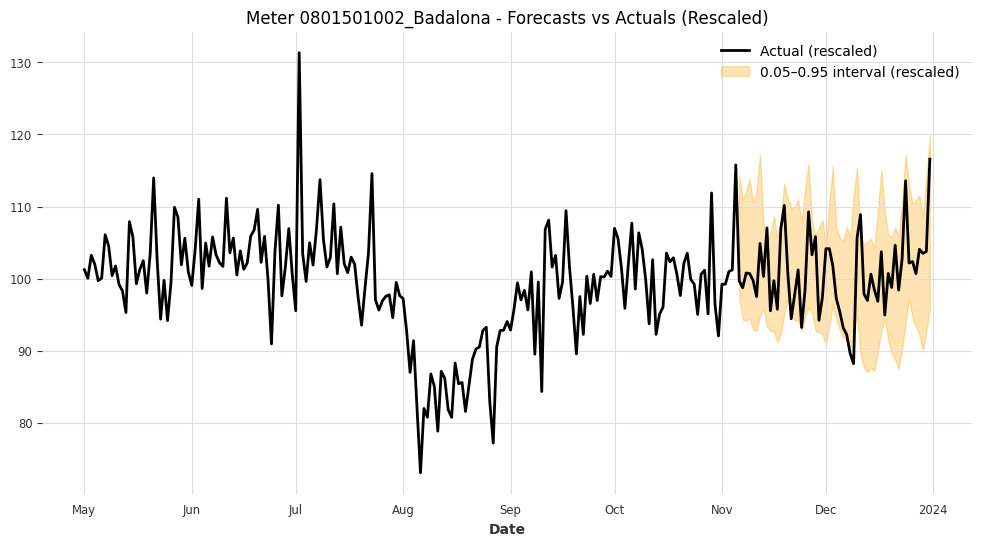

Meter 0801501002_Badalona - Coverage: 0.9107, Mean Interval Width (rescaled): 16.9891



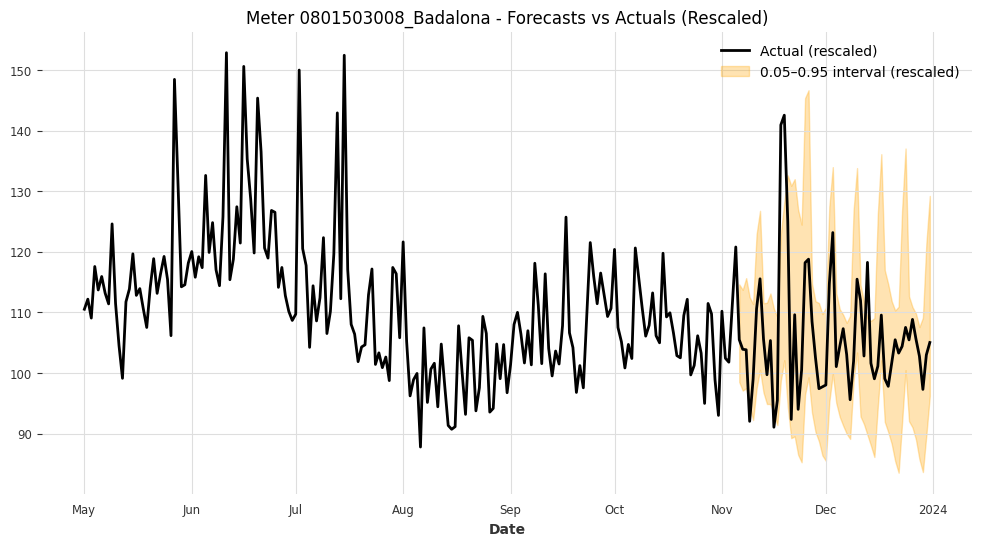

Meter 0801503008_Badalona - Coverage: 0.9107, Mean Interval Width (rescaled): 25.8021



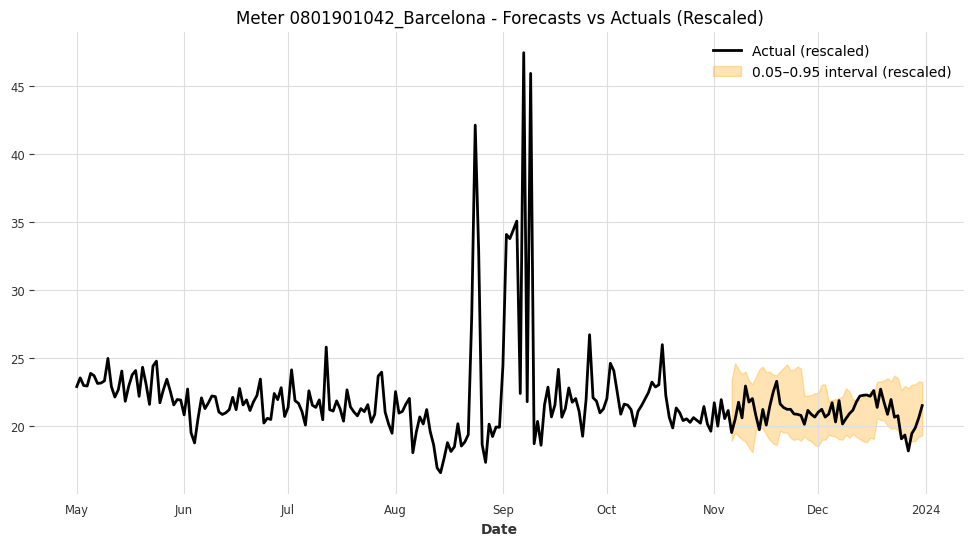

Meter 0801901042_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 3.9235



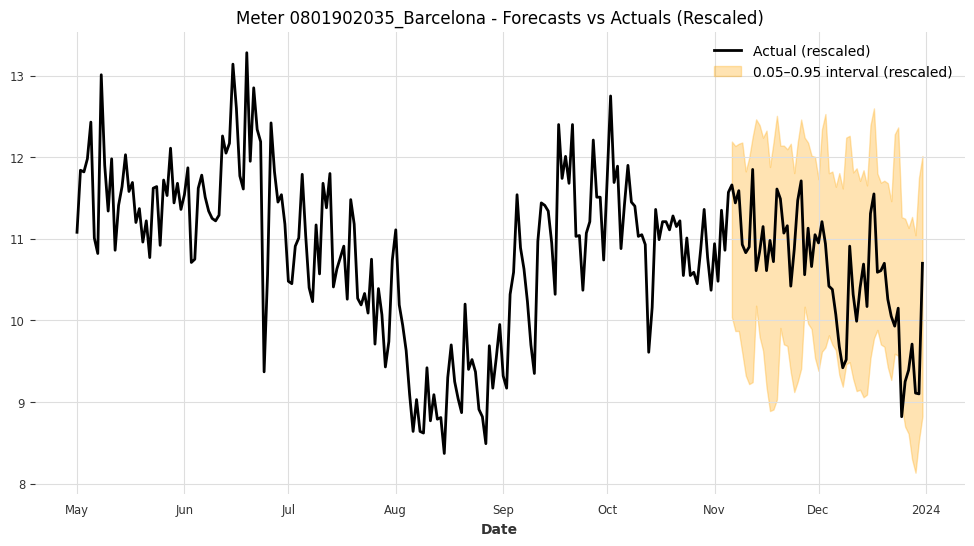

Meter 0801902035_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 2.5751



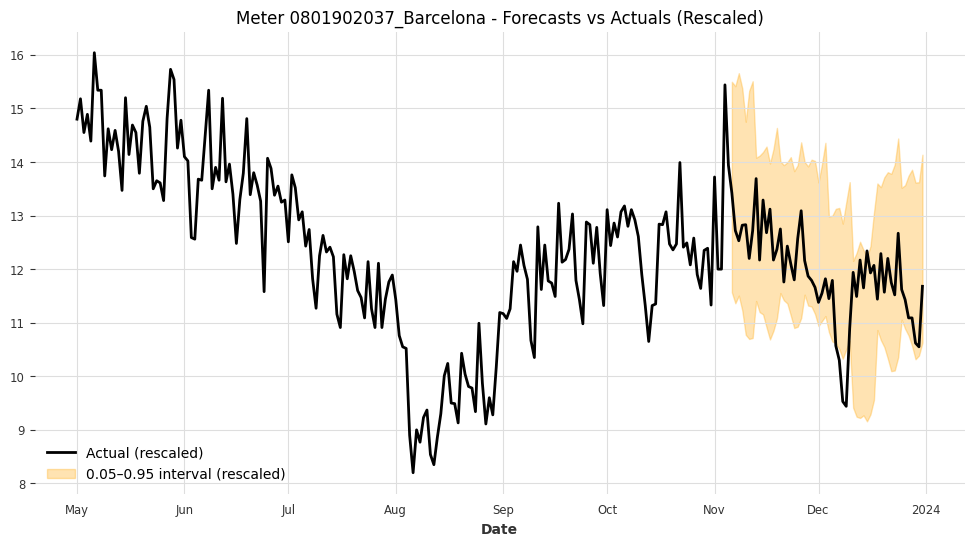

Meter 0801902037_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.1476



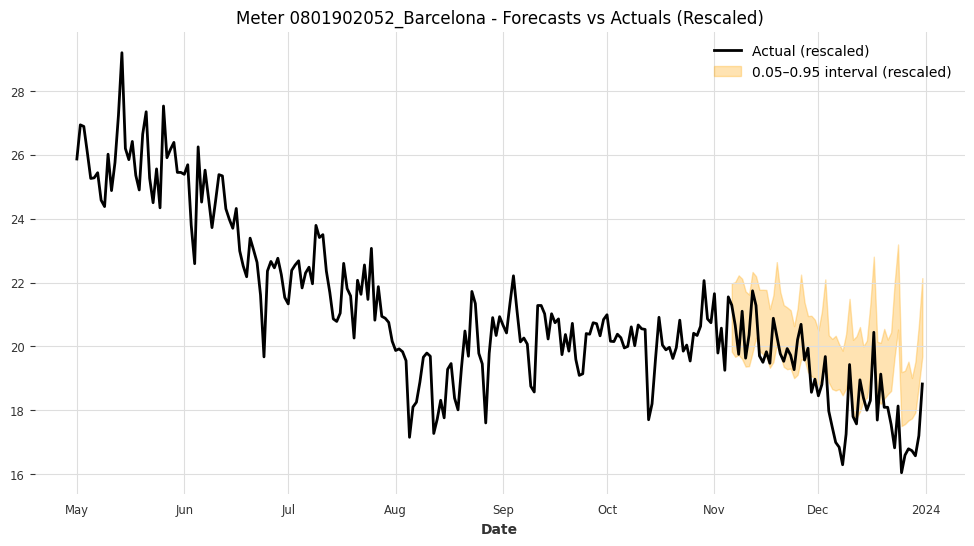

Meter 0801902052_Barcelona - Coverage: 0.4643, Mean Interval Width (rescaled): 2.0277



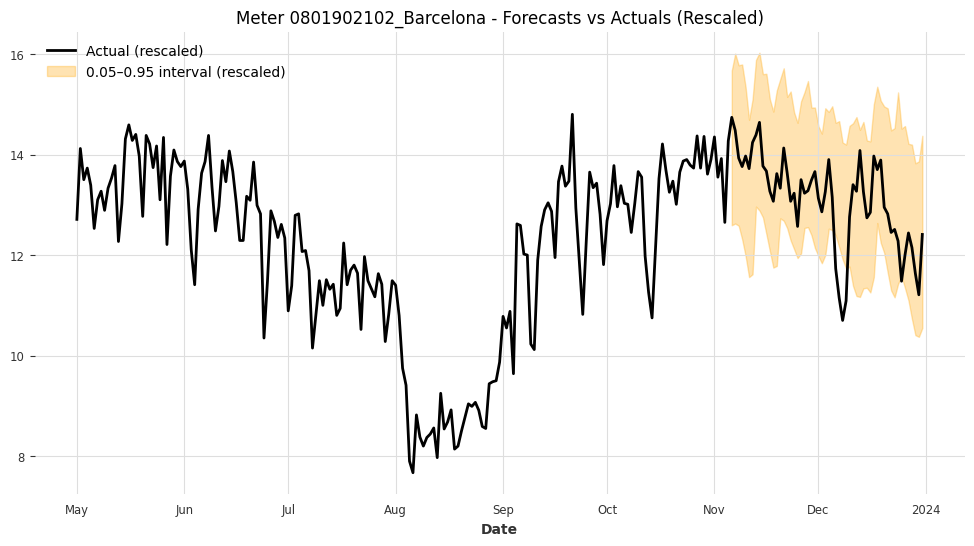

Meter 0801902102_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.0198



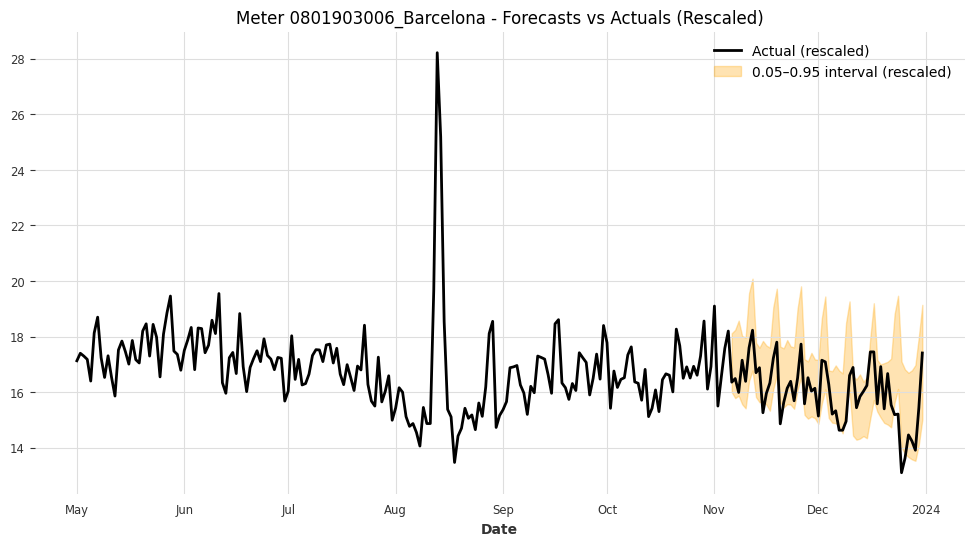

Meter 0801903006_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 2.5636



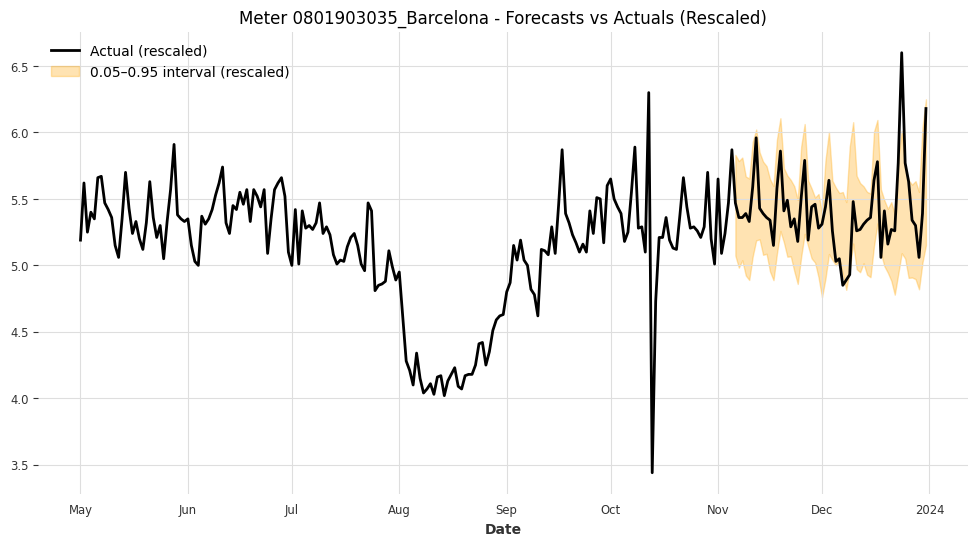

Meter 0801903035_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 0.7087



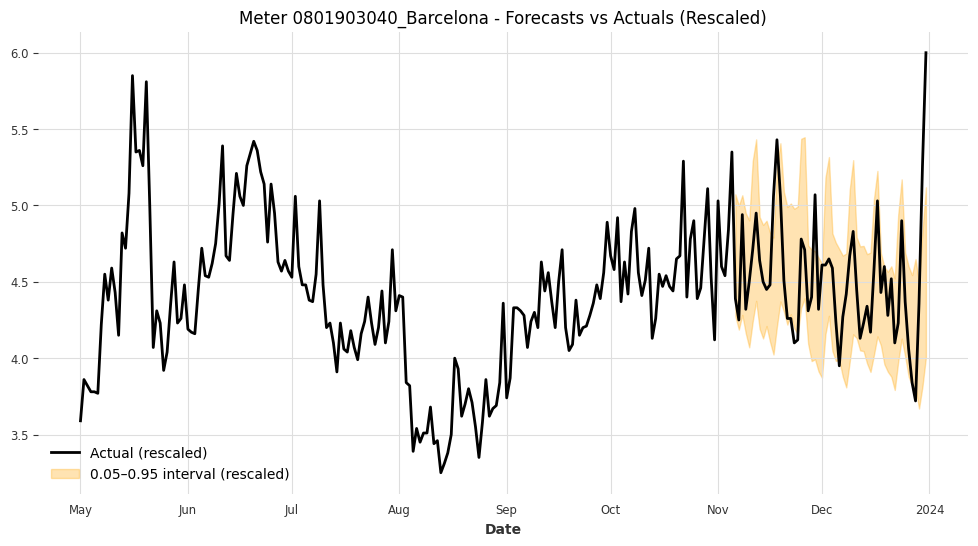

Meter 0801903040_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 0.8328



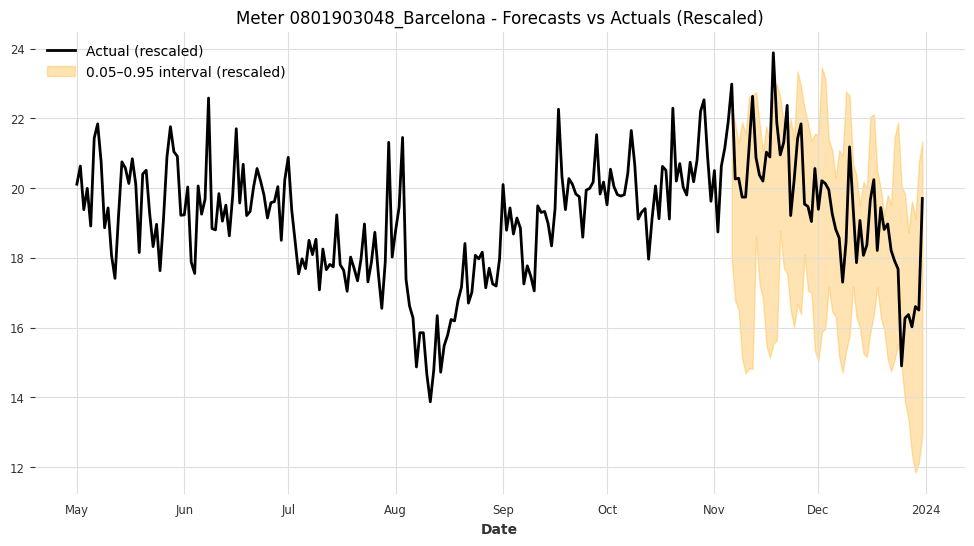

Meter 0801903048_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 5.5839



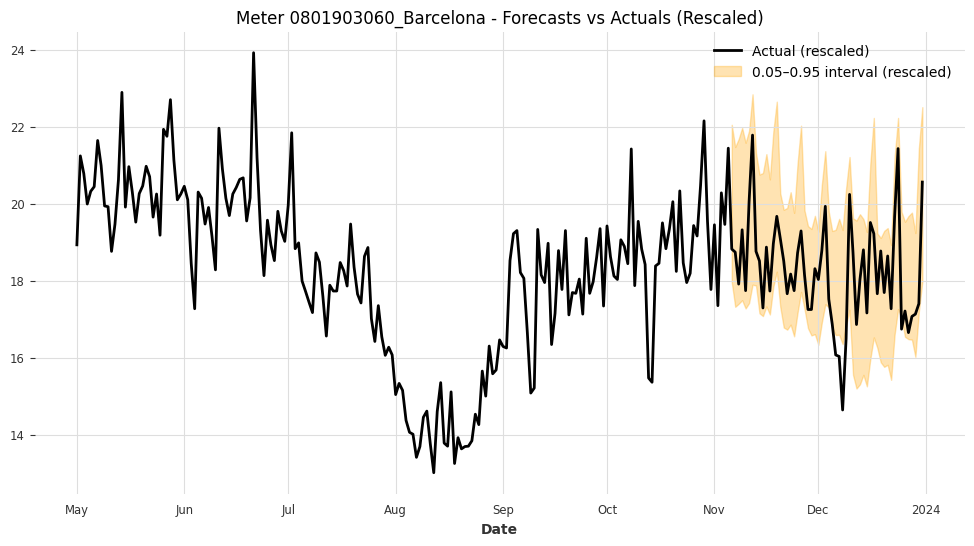

Meter 0801903060_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.6859



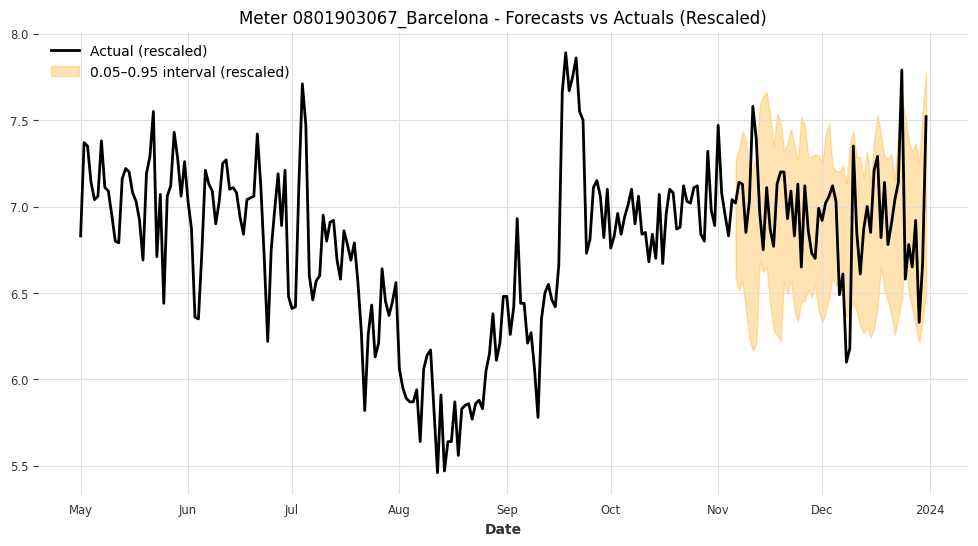

Meter 0801903067_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 0.9402



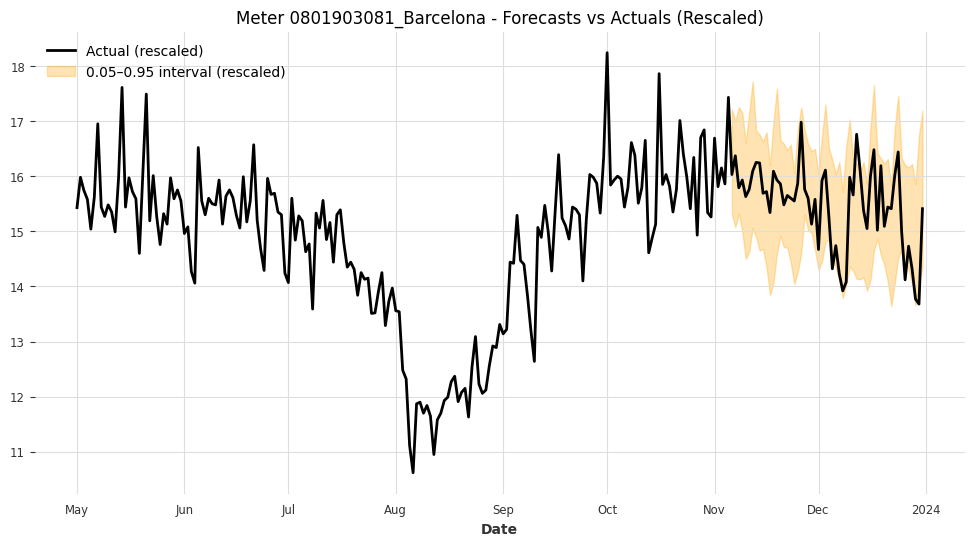

Meter 0801903081_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 2.1490



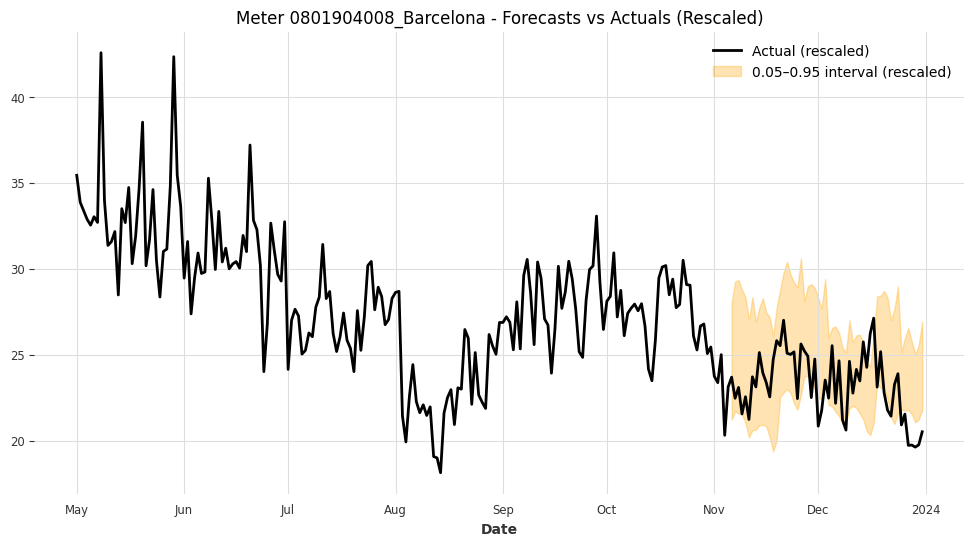

Meter 0801904008_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 5.7344



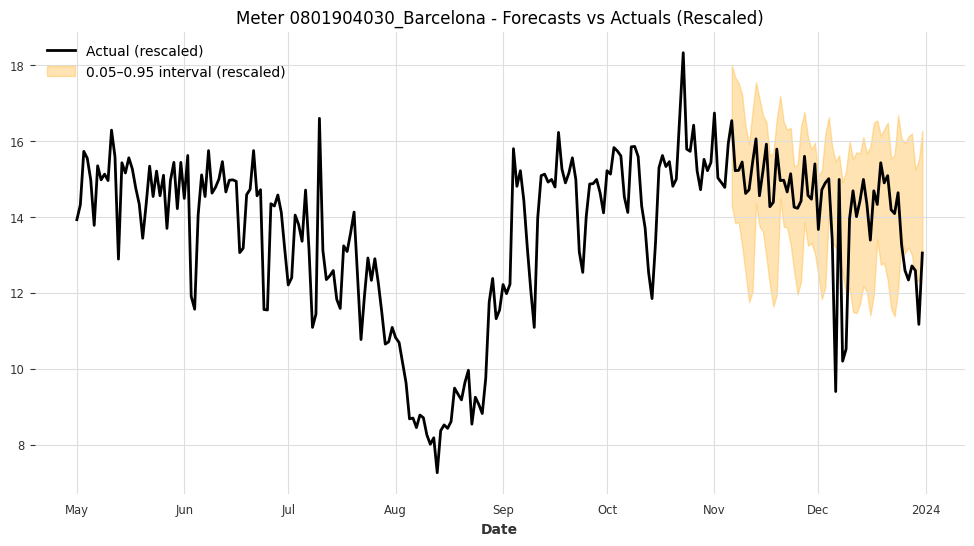

Meter 0801904030_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 3.4426



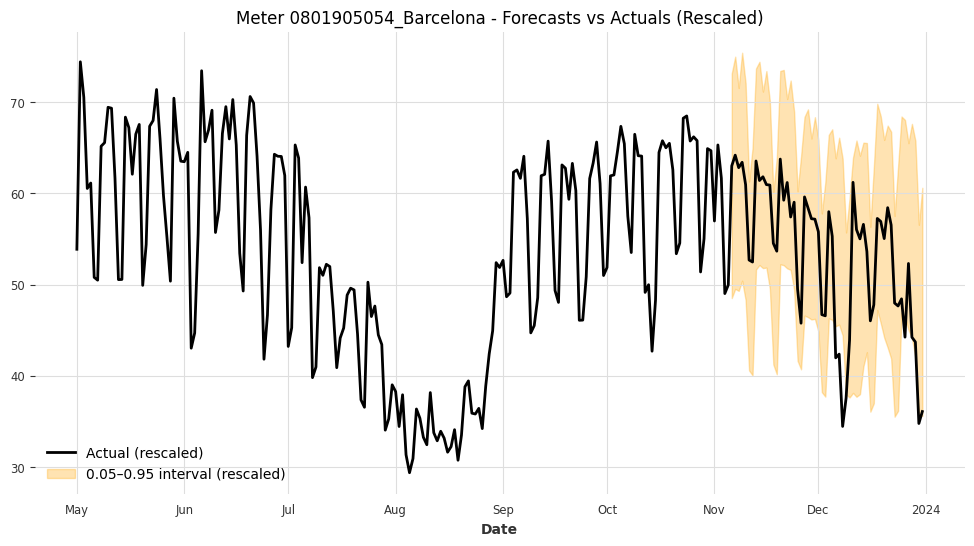

Meter 0801905054_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 22.2057



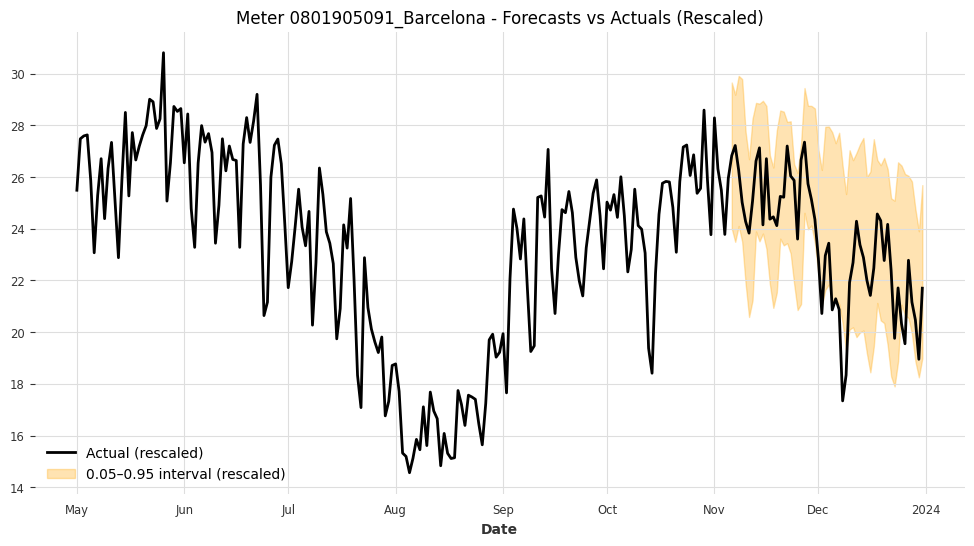

Meter 0801905091_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 5.9686



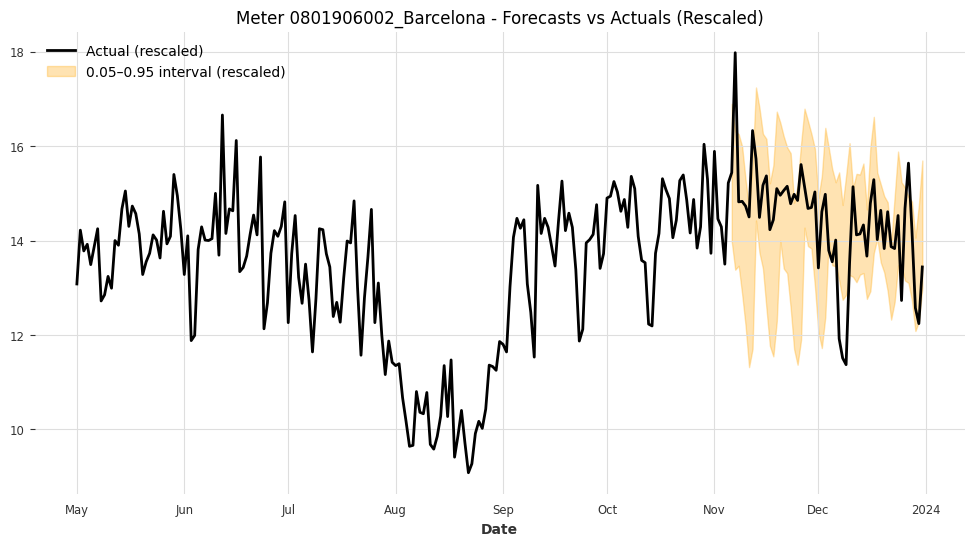

Meter 0801906002_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 2.6626



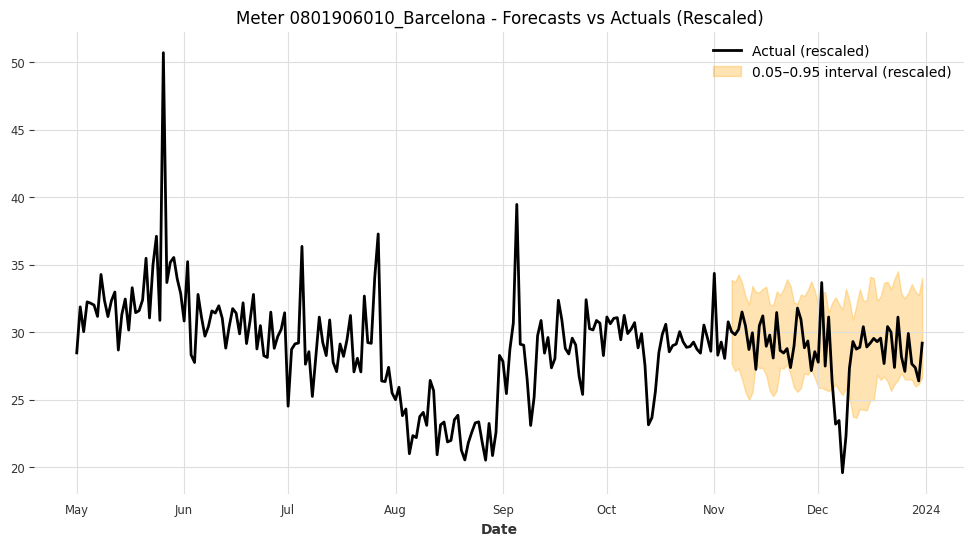

Meter 0801906010_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 6.8325



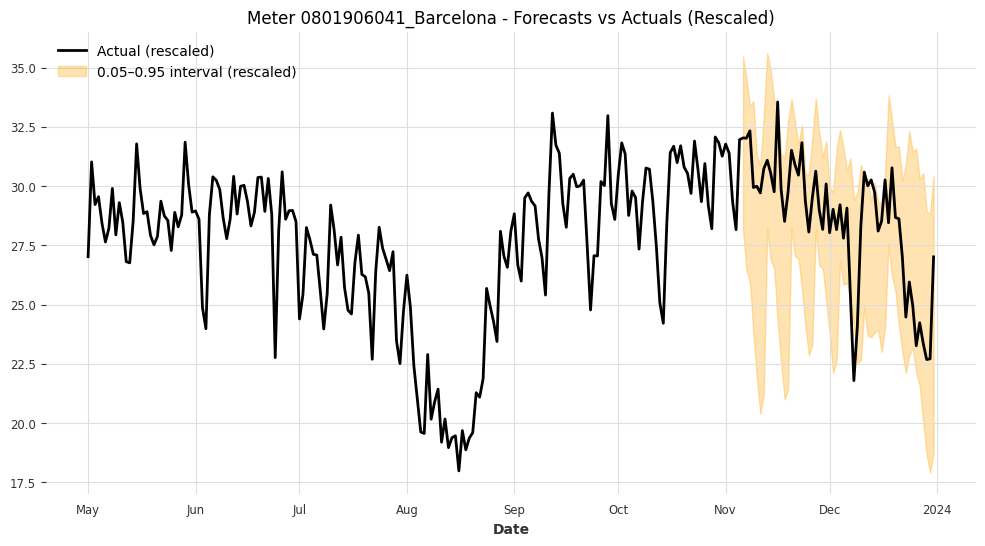

Meter 0801906041_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 7.5755



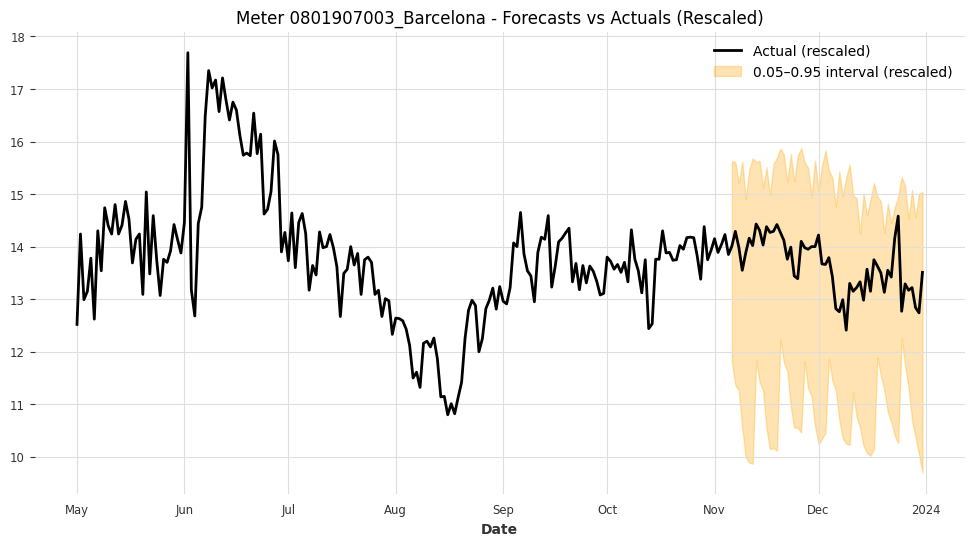

Meter 0801907003_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 4.3885



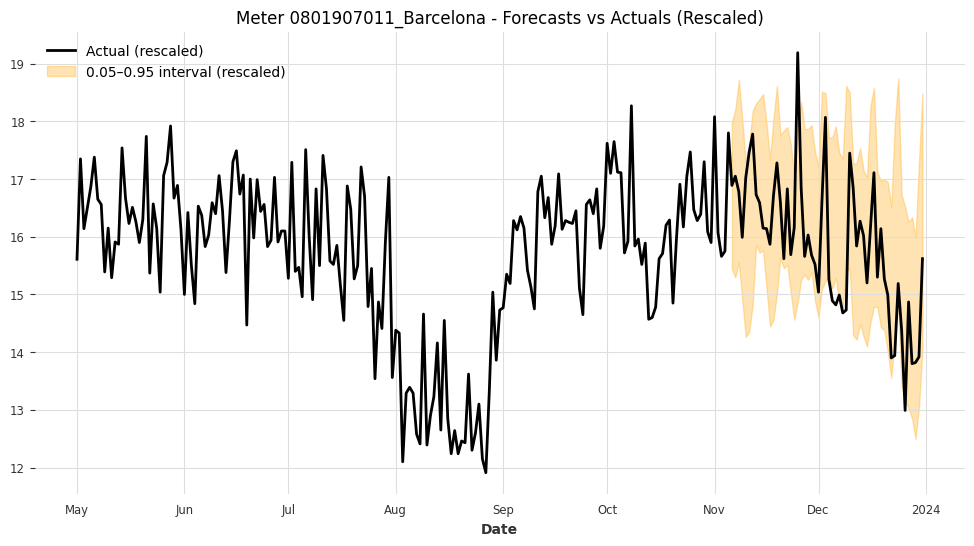

Meter 0801907011_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.9978



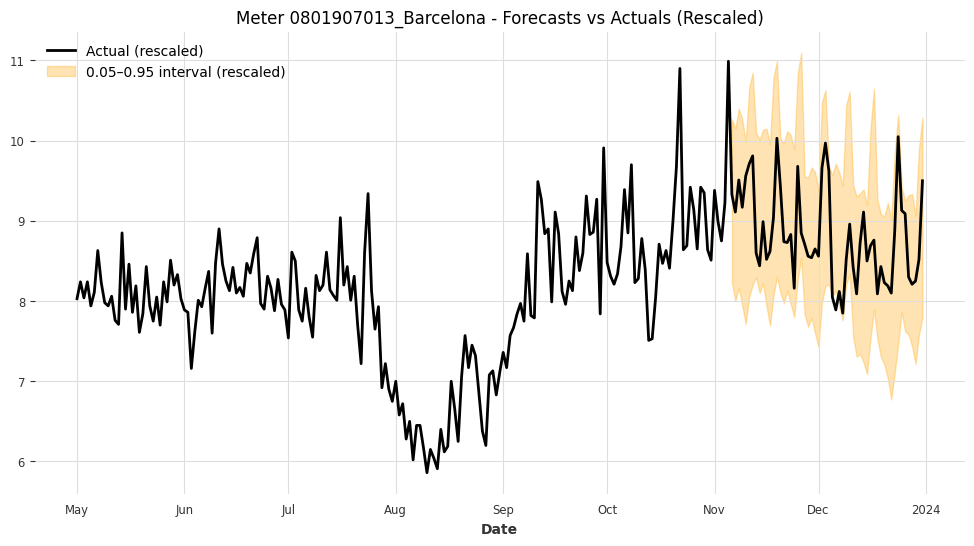

Meter 0801907013_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 2.1101



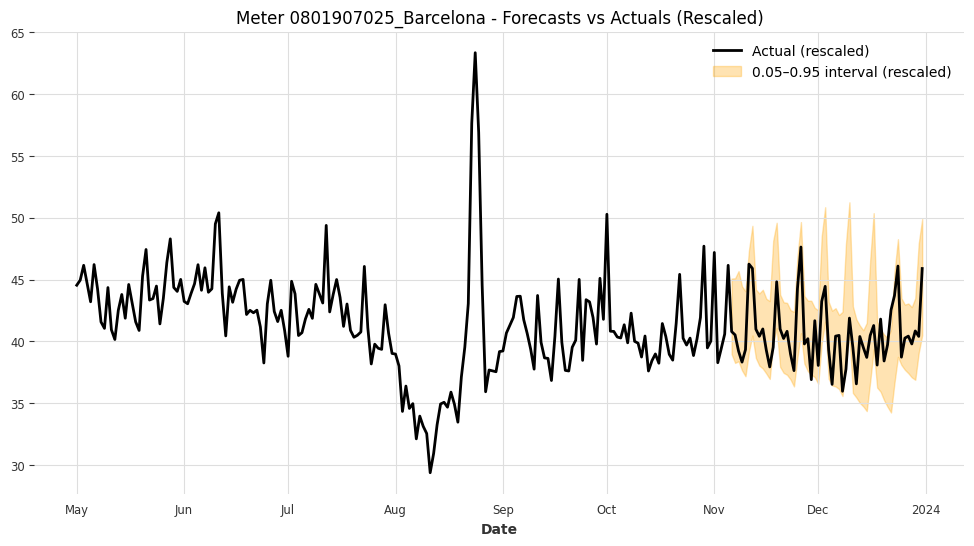

Meter 0801907025_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 6.9511



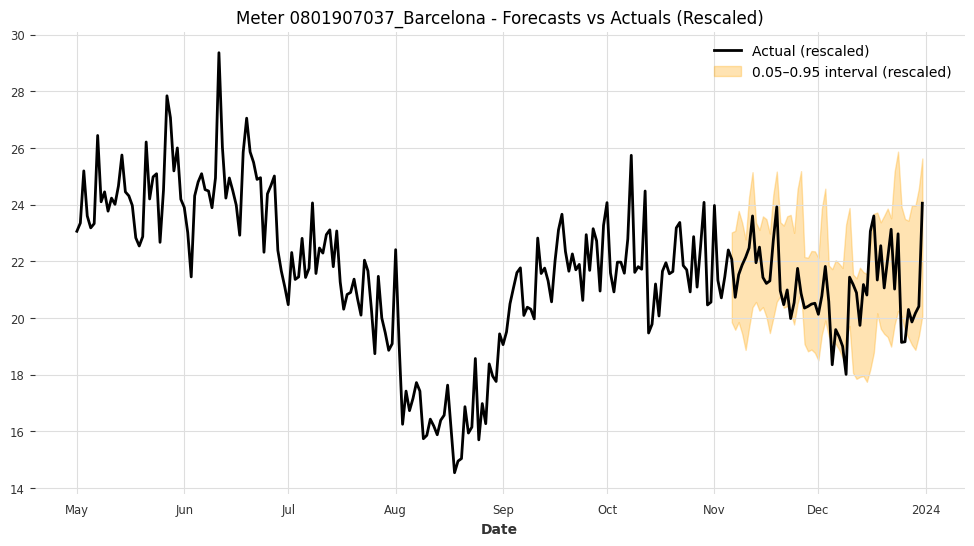

Meter 0801907037_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 3.8678



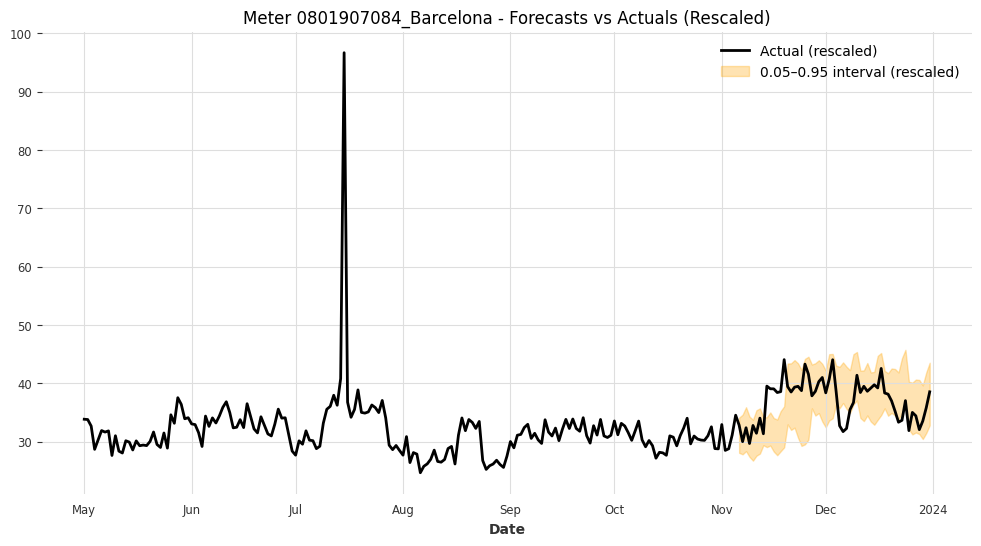

Meter 0801907084_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 8.6758



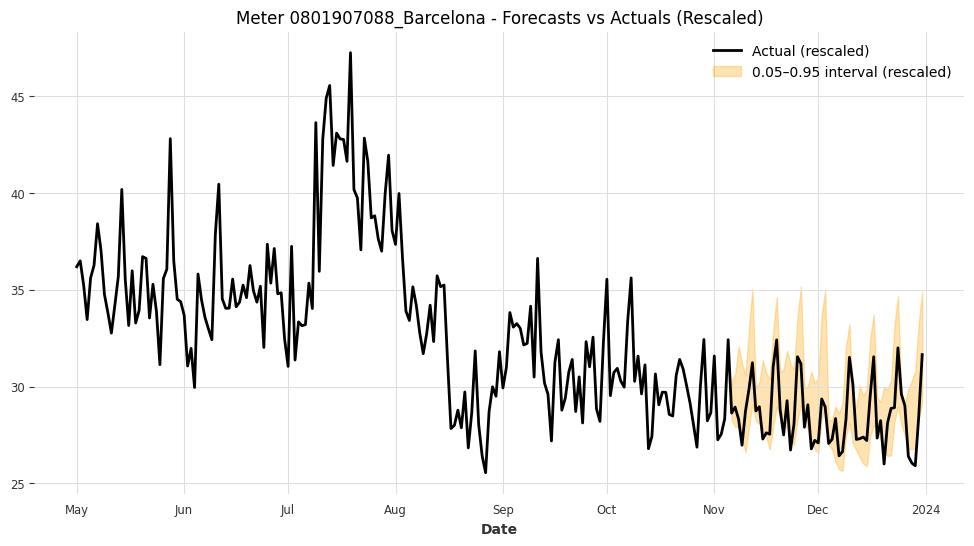

Meter 0801907088_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 3.6520



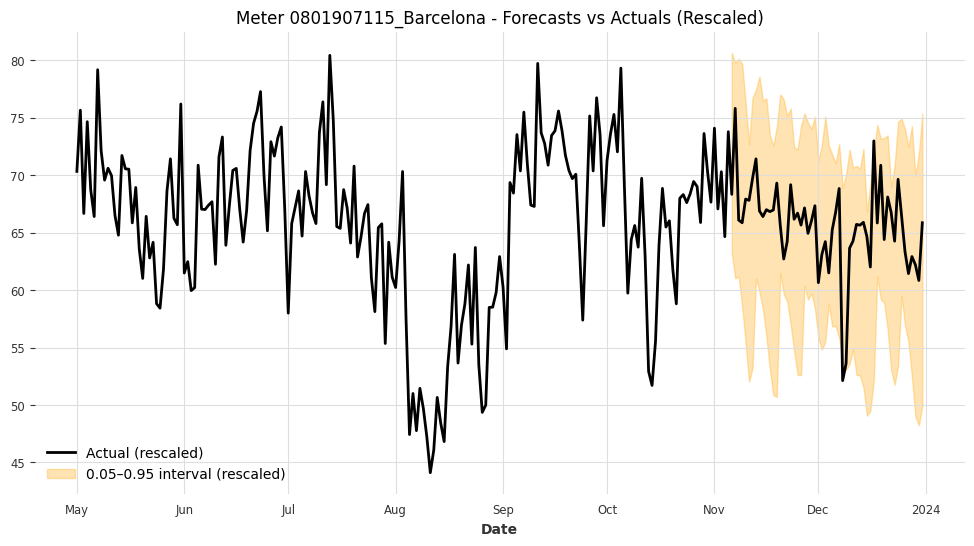

Meter 0801907115_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 18.1820



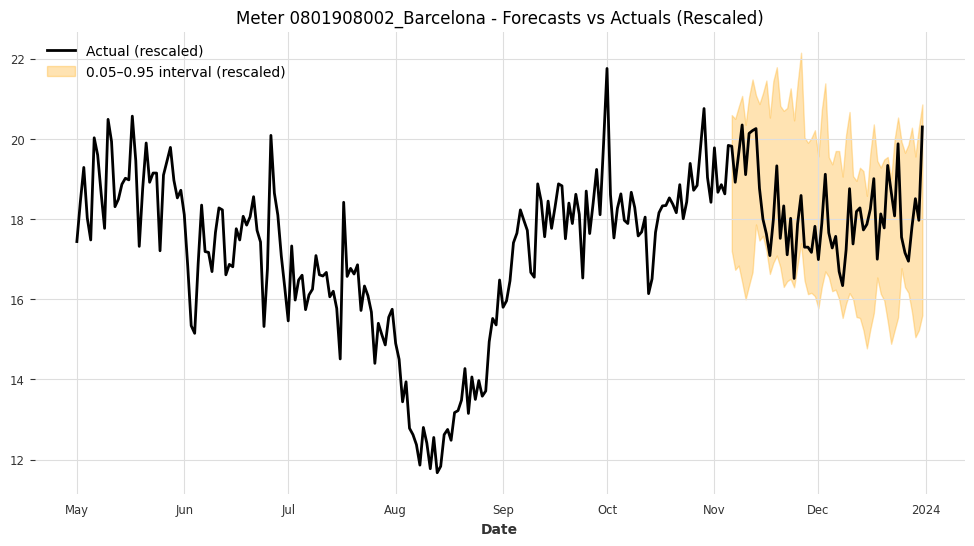

Meter 0801908002_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 4.0404



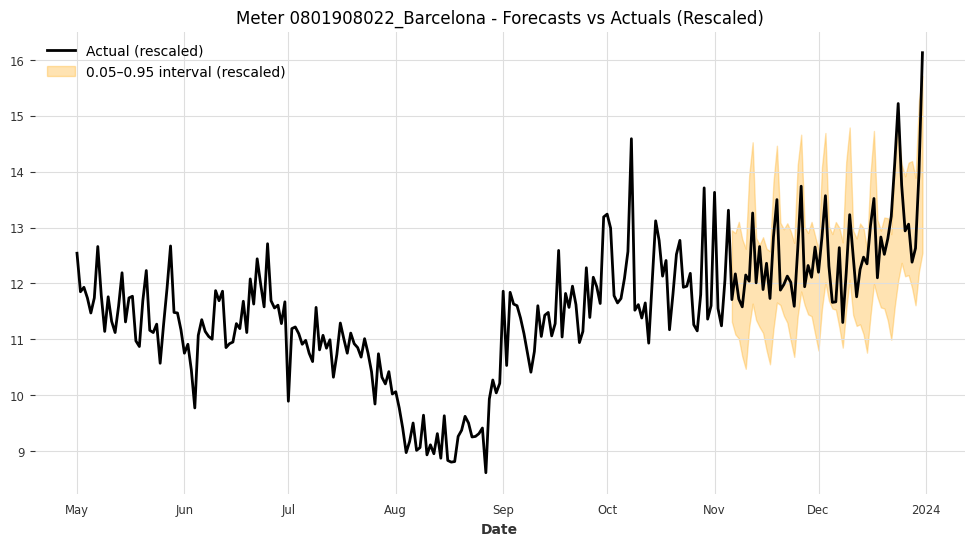

Meter 0801908022_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 2.0356



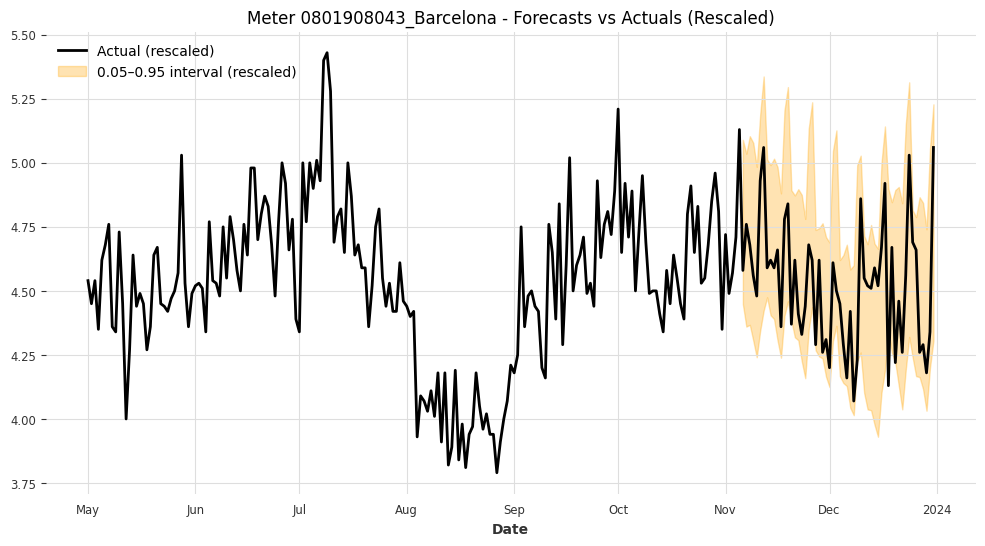

Meter 0801908043_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 0.6884



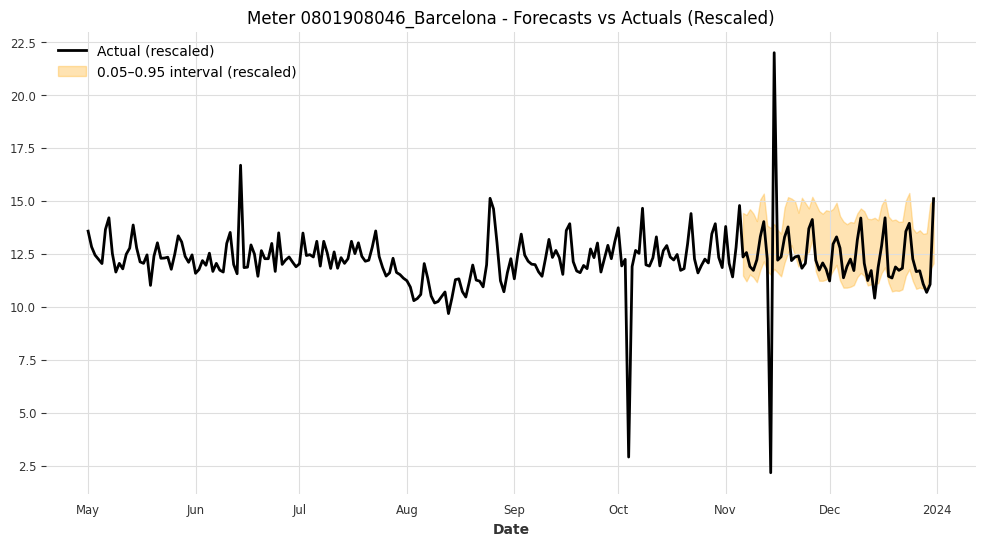

Meter 0801908046_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.8848



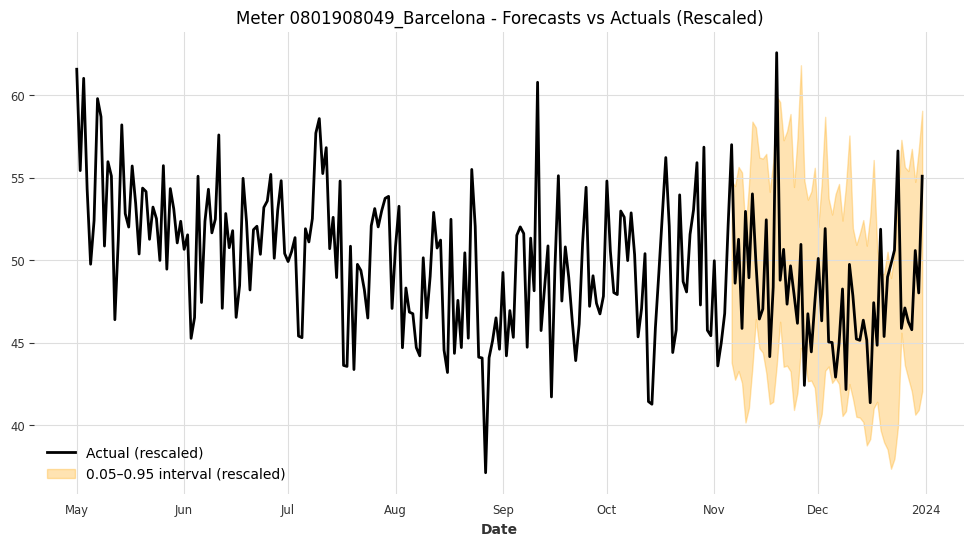

Meter 0801908049_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 12.7842



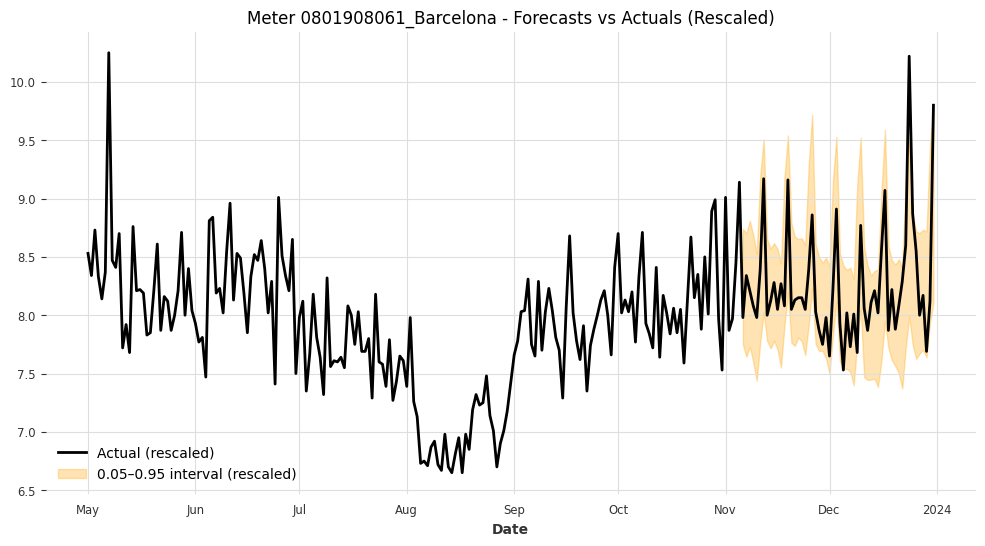

Meter 0801908061_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 1.0888



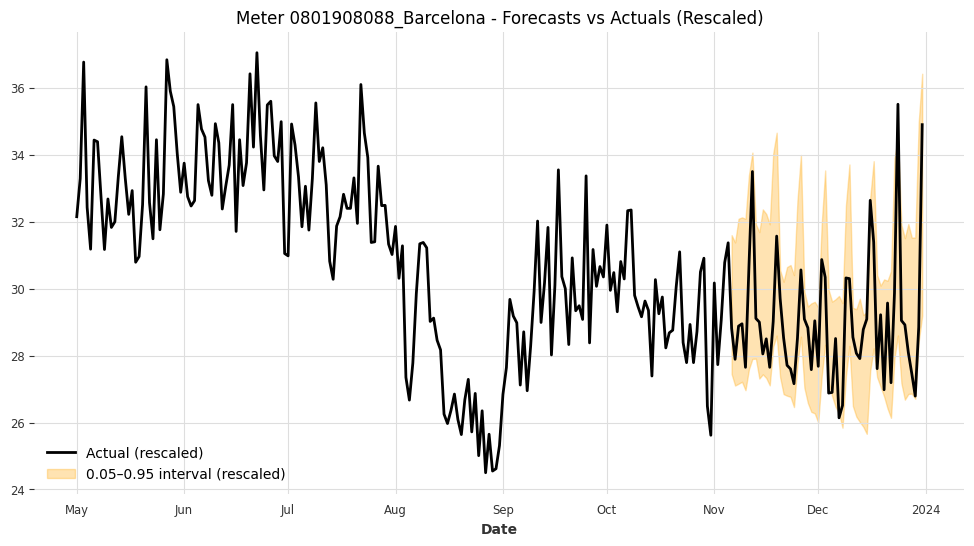

Meter 0801908088_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 4.3925



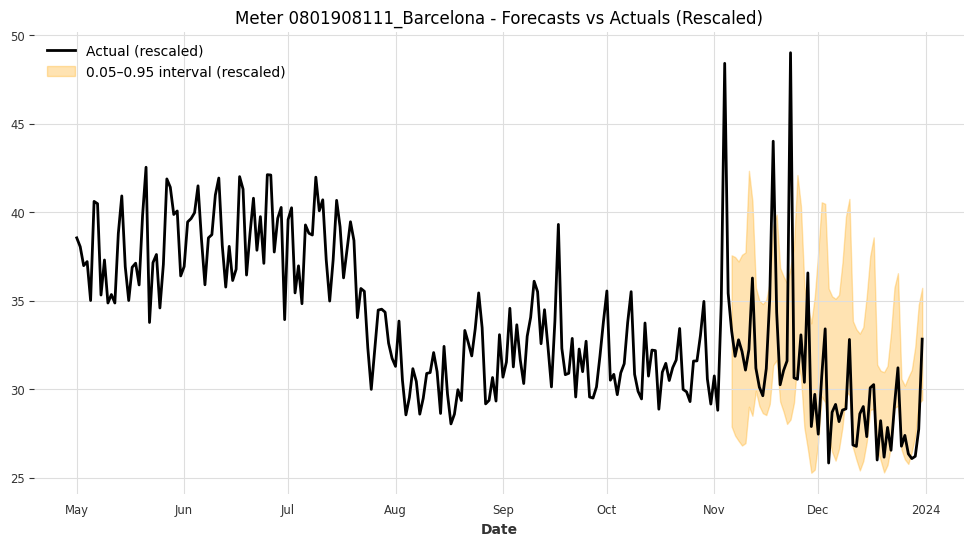

Meter 0801908111_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 8.0357



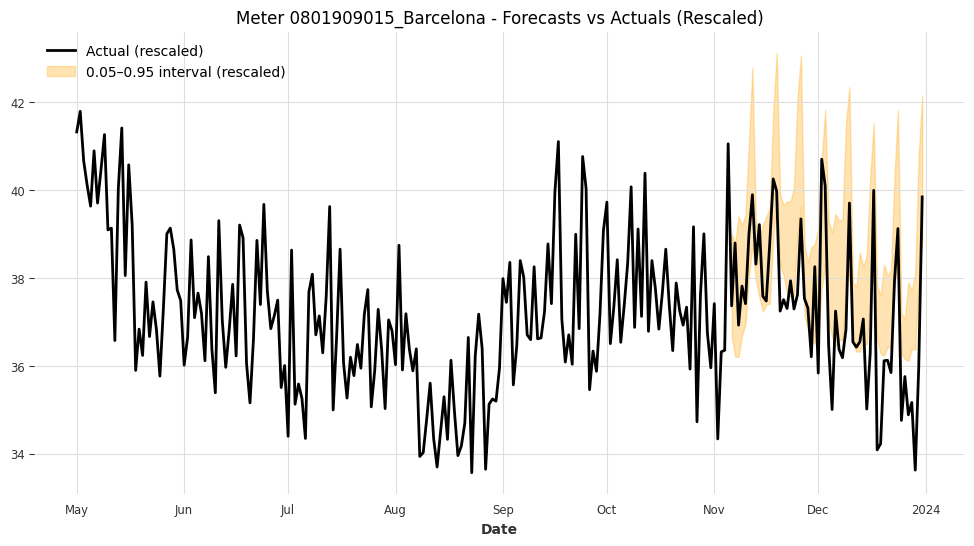

Meter 0801909015_Barcelona - Coverage: 0.4821, Mean Interval Width (rescaled): 2.3397



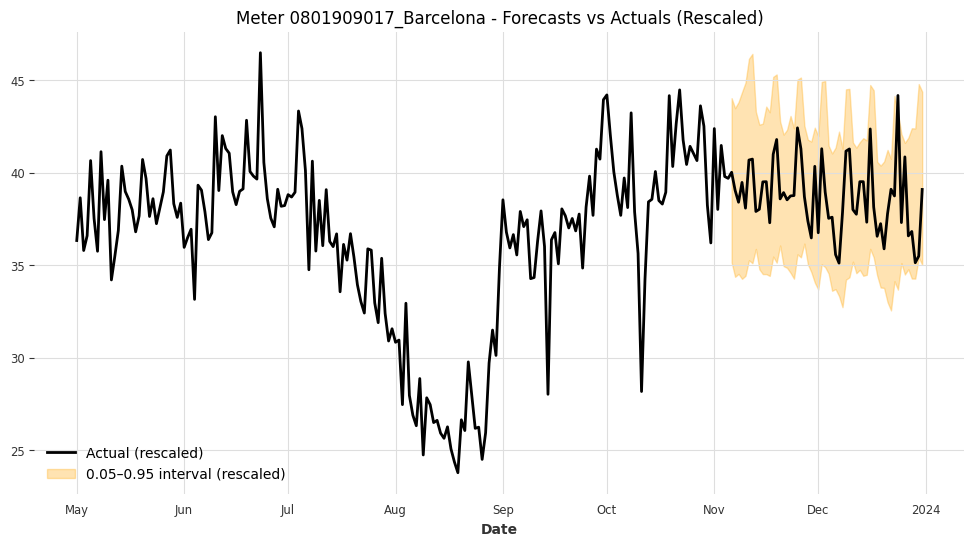

Meter 0801909017_Barcelona - Coverage: 0.9821, Mean Interval Width (rescaled): 8.3790



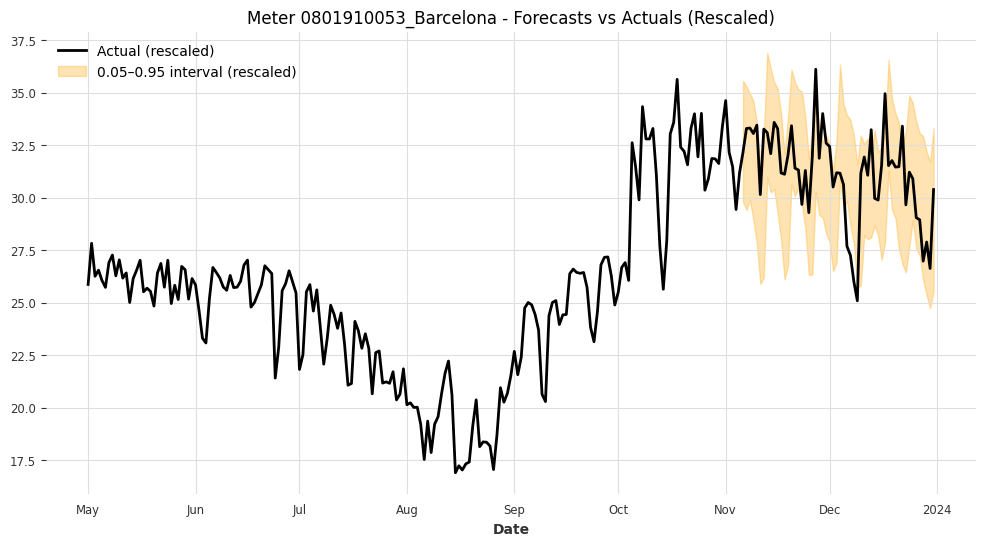

Meter 0801910053_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 5.5460



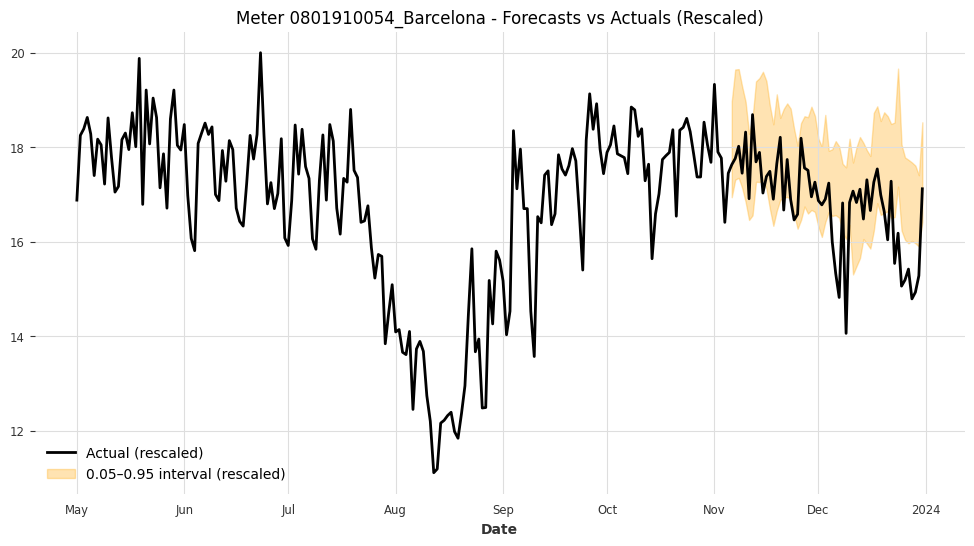

Meter 0801910054_Barcelona - Coverage: 0.6786, Mean Interval Width (rescaled): 1.9866



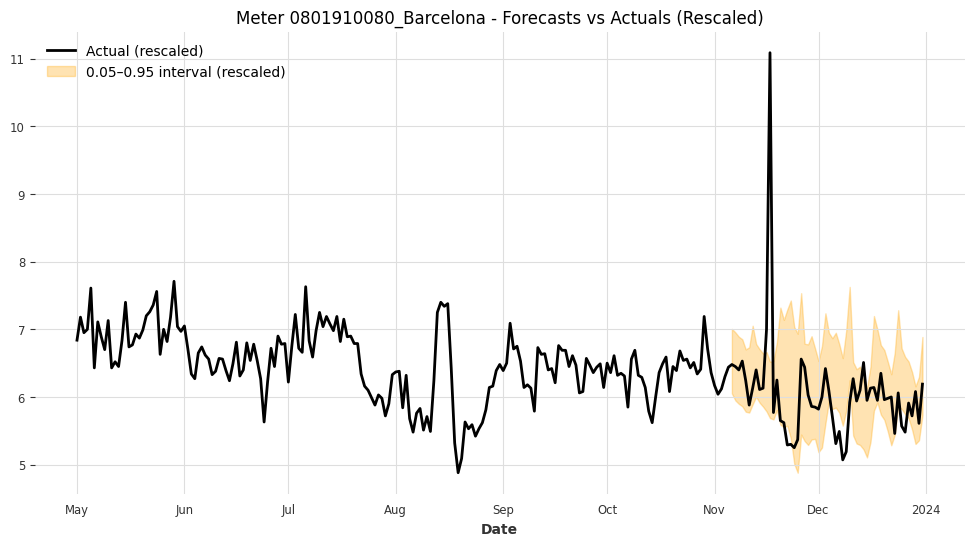

Meter 0801910080_Barcelona - Coverage: 0.7679, Mean Interval Width (rescaled): 1.1840



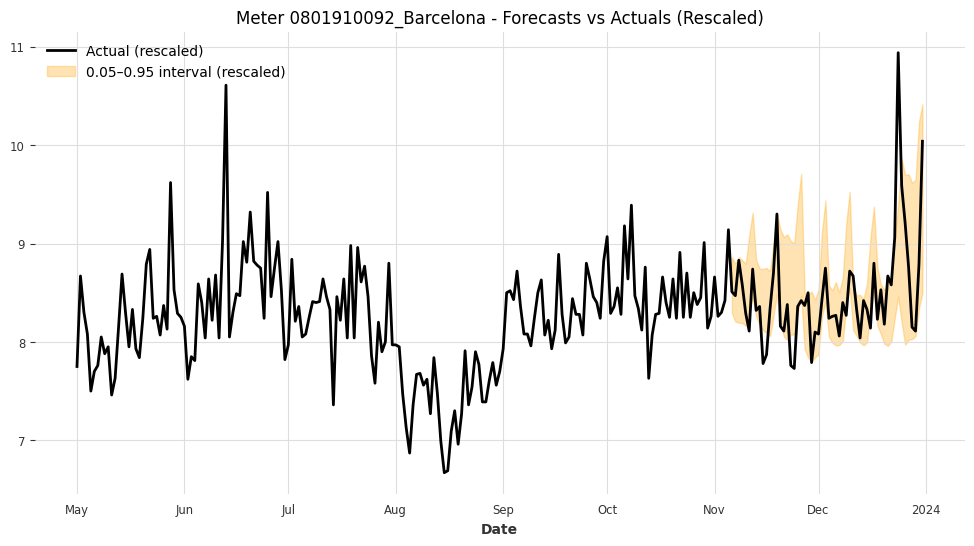

Meter 0801910092_Barcelona - Coverage: 0.7321, Mean Interval Width (rescaled): 0.8405



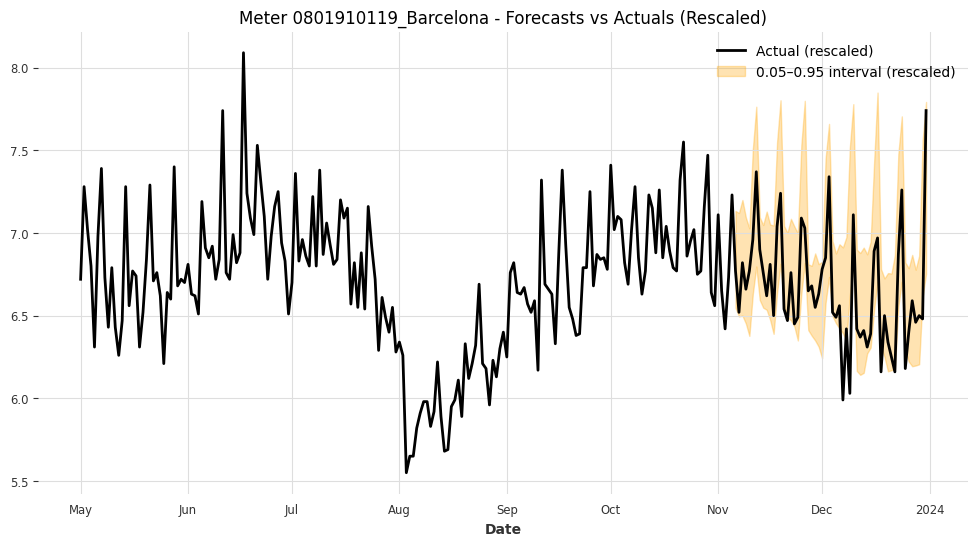

Meter 0801910119_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 0.6848



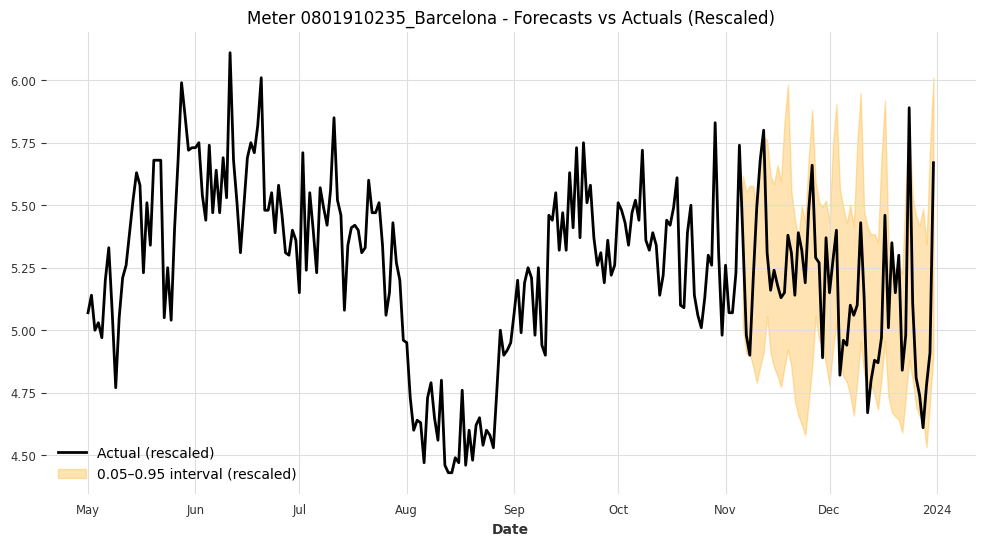

Meter 0801910235_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 0.7633



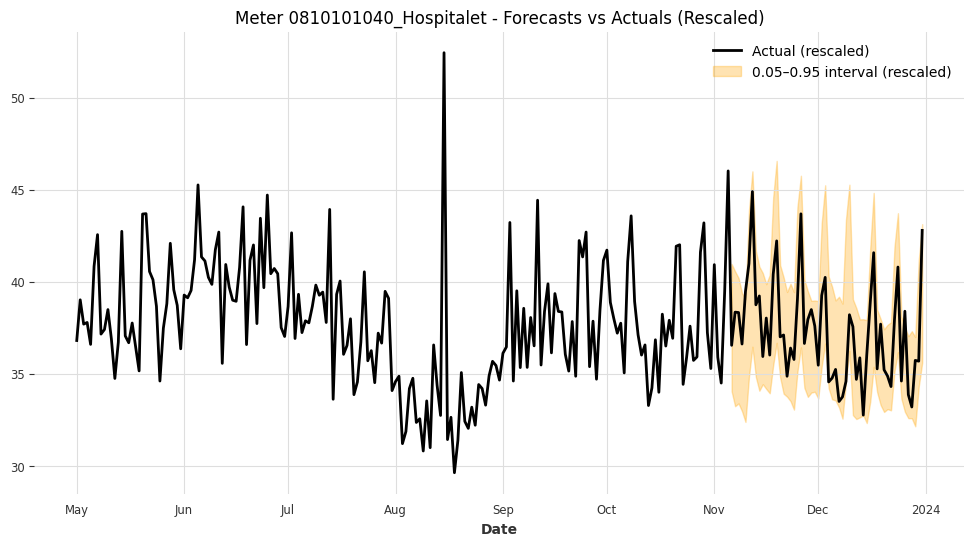

Meter 0810101040_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 6.5076



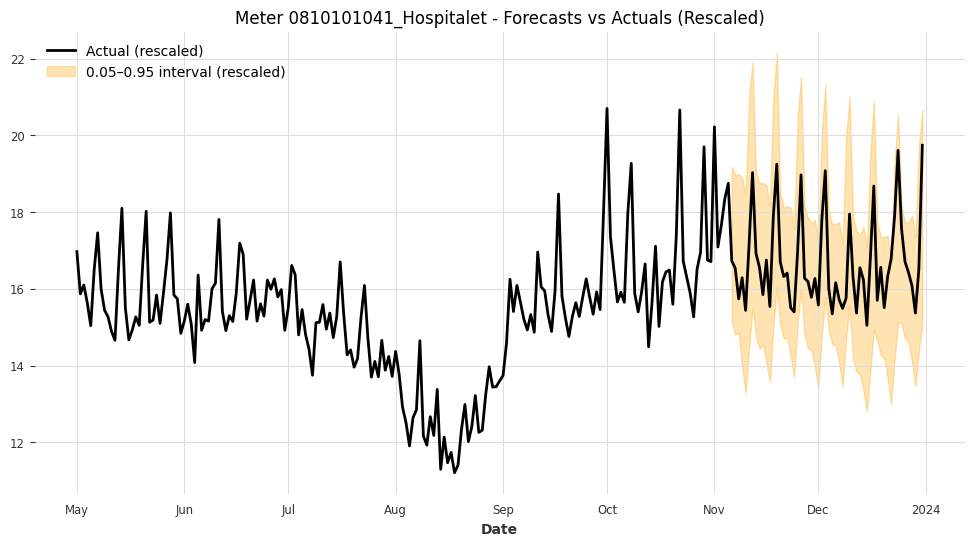

Meter 0810101041_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 4.3009



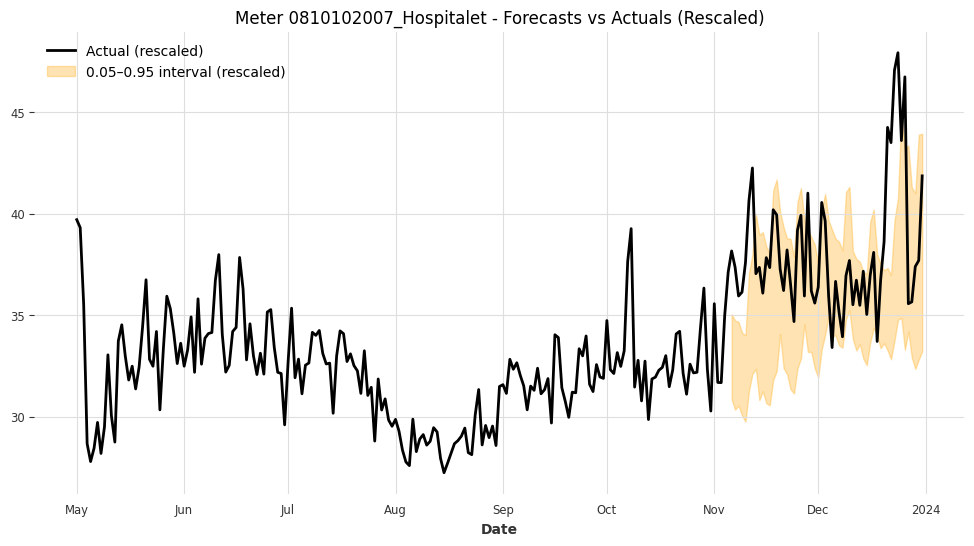

Meter 0810102007_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 6.3086



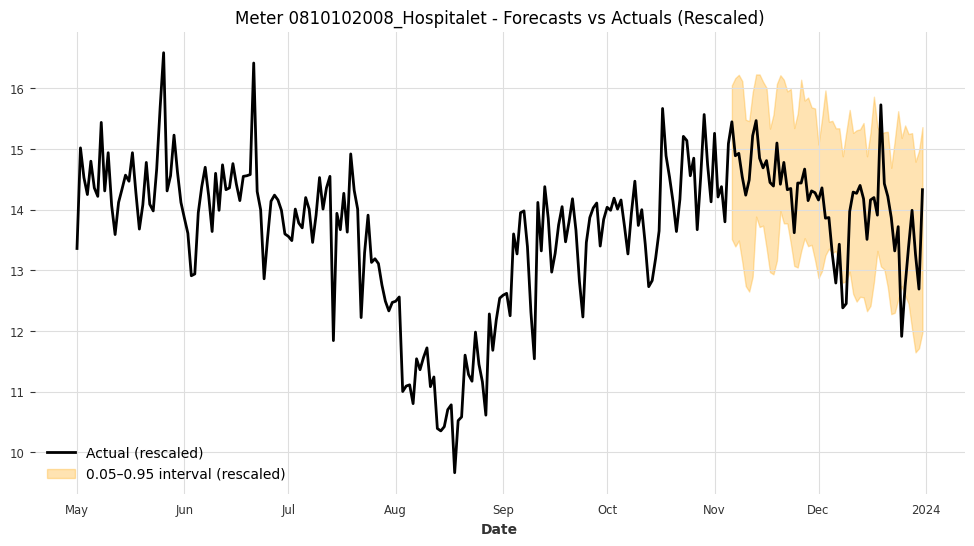

Meter 0810102008_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 2.5926



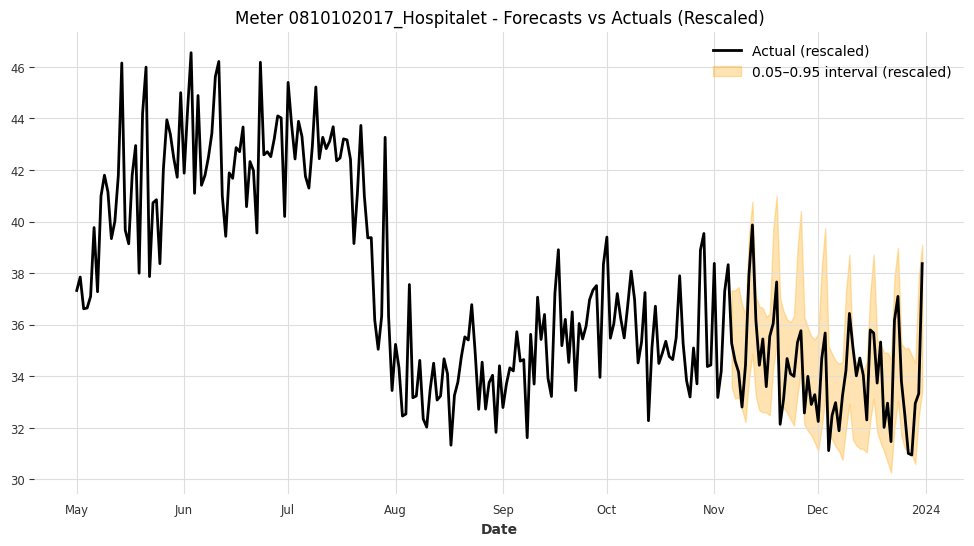

Meter 0810102017_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 4.3620



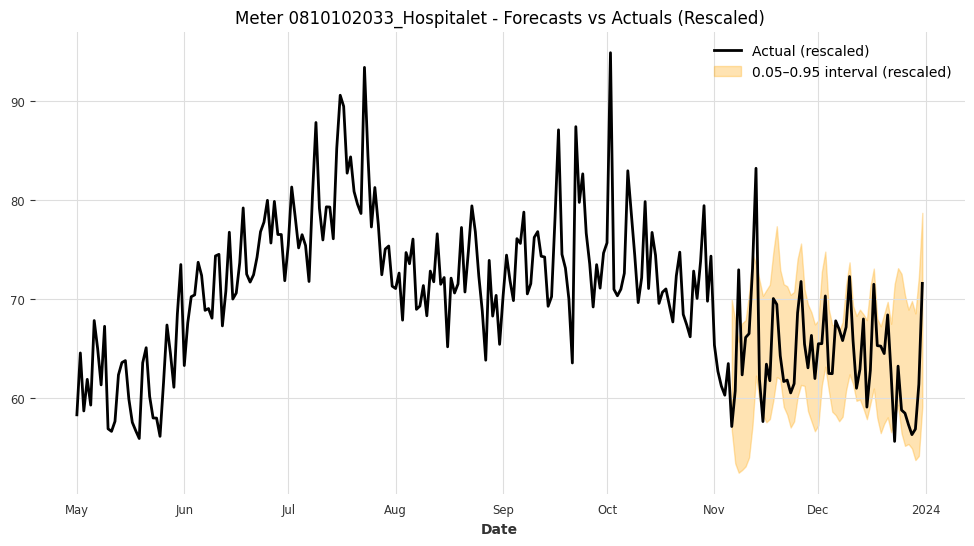

Meter 0810102033_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 12.3706



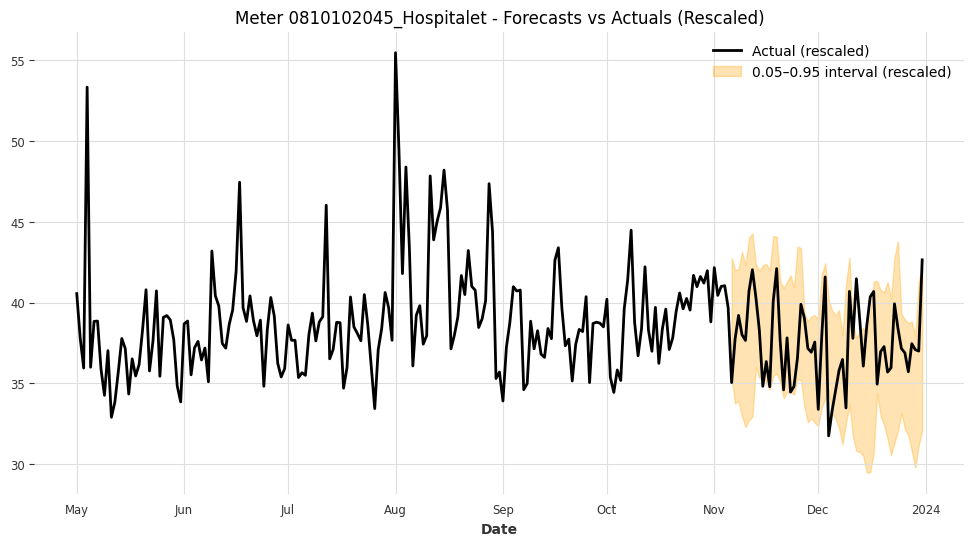

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 7.9855



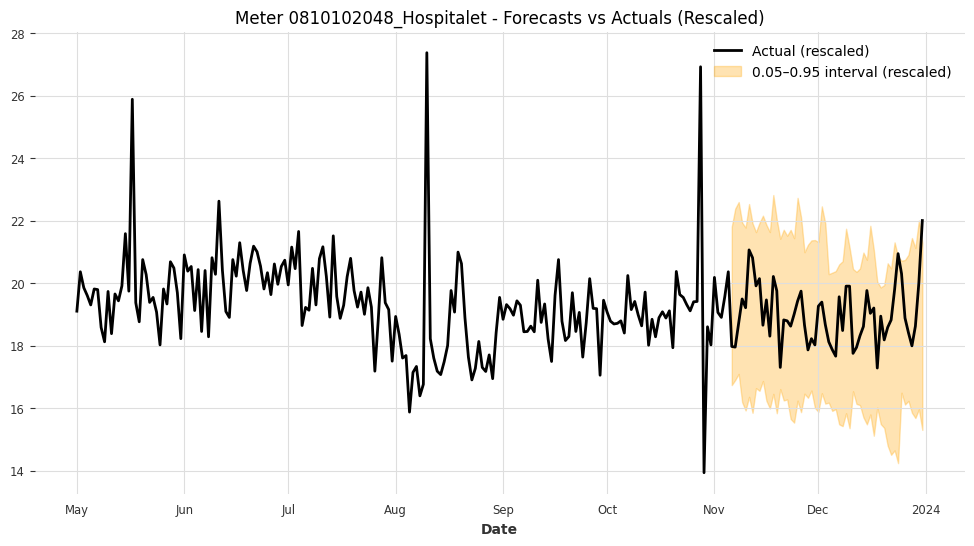

Meter 0810102048_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 5.3753



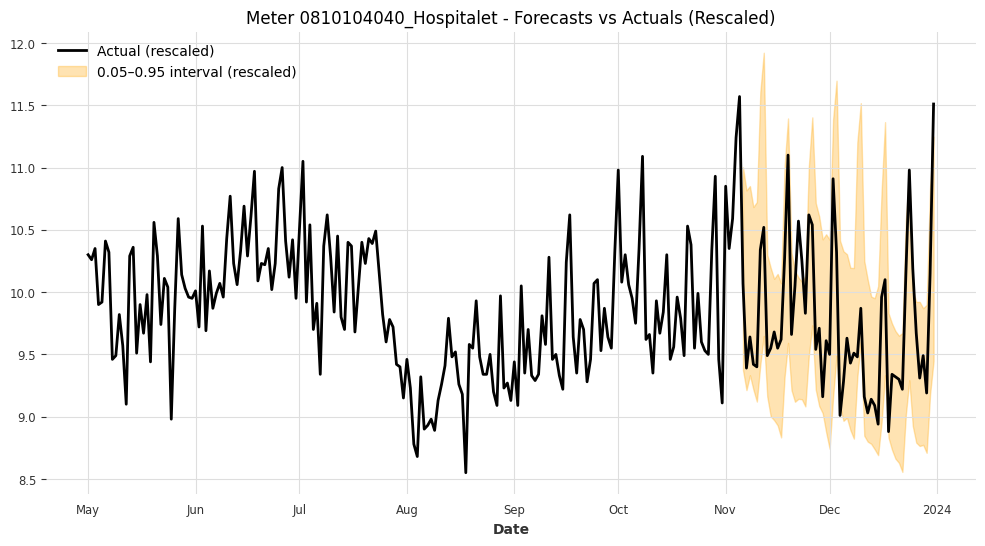

Meter 0810104040_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.4369



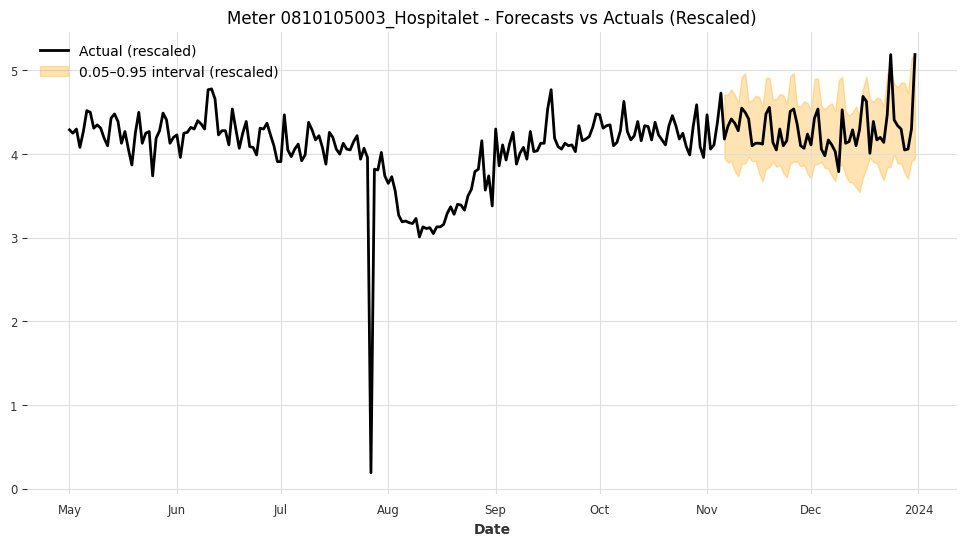

Meter 0810105003_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.9028



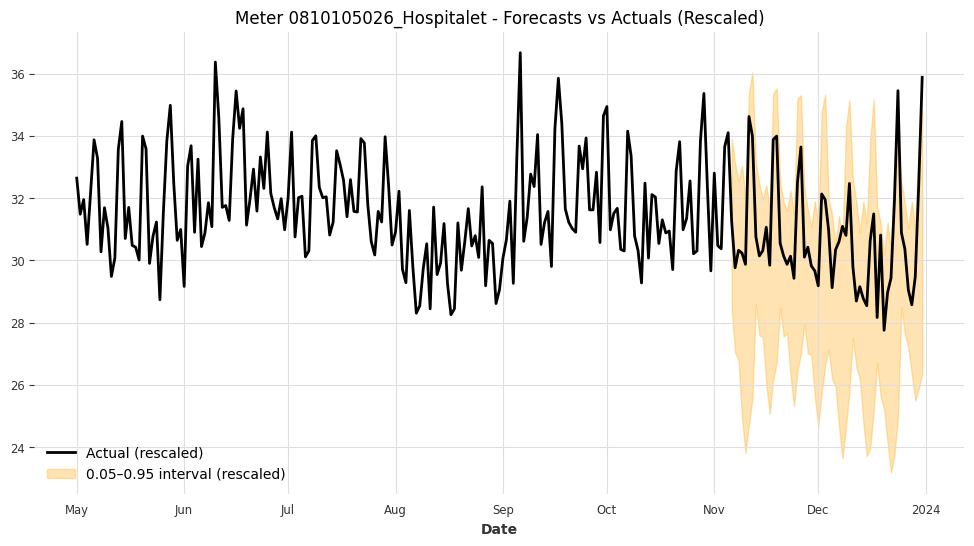

Meter 0810105026_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 6.6091



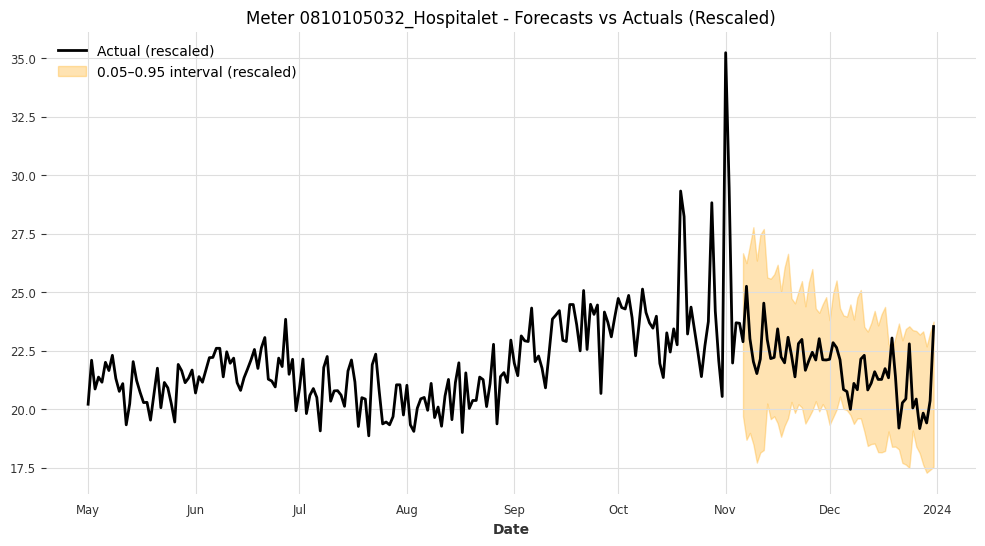

Meter 0810105032_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 5.6045



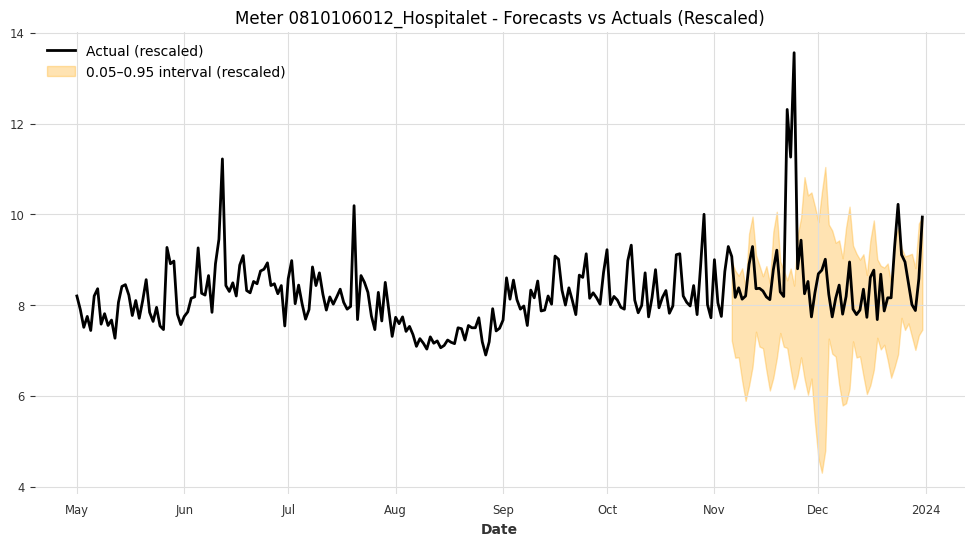

Meter 0810106012_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 2.7250



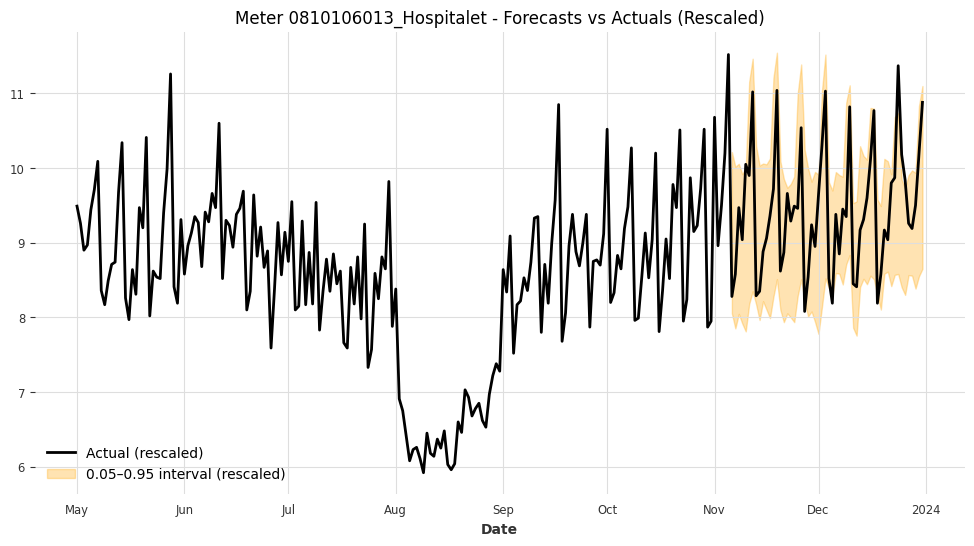

Meter 0810106013_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 1.9875



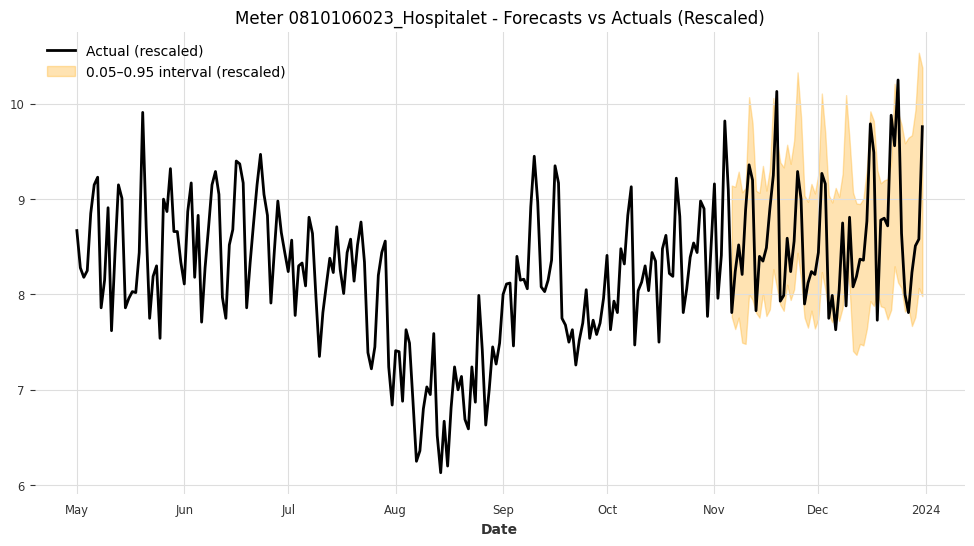

Meter 0810106023_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 1.5991



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# Let's check the standard model

In [ ]:
model = BlockRNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_model_standard.pkl")

test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801501002_Badalona:
    Interval  Coverage      Width
0       0.9  0.767857  20.066265


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801503008_Badalona:
    Interval  Coverage      Width
0       0.9  0.910714  28.835289


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801901042_Barcelona:
    Interval  Coverage     Width
0       0.9  0.696429  3.645496


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  2.310457


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  3.238609


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902052_Barcelona:
    Interval  Coverage     Width
0       0.9       0.0  2.145892


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801902102_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  2.699667


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903006_Barcelona:
    Interval  Coverage     Width
0       0.9  0.803571  2.724533


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  0.798006


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801903040_Barcelona:
    Interval  Coverage     Width
0       0.9  0.839286  0.890927


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903048_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  3.787771


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903060_Barcelona:
    Interval  Coverage     Width
0       0.9      0.75  3.758531


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903067_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  1.010945


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903081_Barcelona:
    Interval  Coverage    Width
0       0.9  0.857143  2.41574


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.464286  6.578068


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904030_Barcelona:
    Interval  Coverage    Width
0       0.9  0.821429  3.55123


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905054_Barcelona:
    Interval  Coverage      Width
0       0.9  0.910714  21.605125


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905091_Barcelona:
    Interval  Coverage     Width
0       0.9  0.785714  6.103361


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906002_Barcelona:
    Interval  Coverage     Width
0       0.9      0.75  2.792155


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906010_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  6.673606


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores



Results for meter 0801906041_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  7.089559


INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907003_Barcelona:
    Interval  Coverage     Width
0       0.9  0.732143  2.454111


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907011_Barcelona:
    Interval  Coverage    Width
0       0.9  0.839286  3.06765


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907013_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  2.271246


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907025_Barcelona:
    Interval  Coverage     Width
0       0.9  0.714286  7.480233


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.607143  3.812272


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907084_Barcelona:
    Interval  Coverage     Width
0       0.9      0.75  8.077064


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801907088_Barcelona:
    Interval  Coverage     Width
0       0.9       1.0  7.651714


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801907115_Barcelona:


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


    Interval  Coverage      Width
0       0.9       1.0  23.926009


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908002_Barcelona:
    Interval  Coverage    Width
0       0.9  0.892857  3.56715


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908022_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  2.419515


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908043_Barcelona:
    Interval  Coverage     Width
0       0.9  0.946429  0.687616


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0801908046_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  2.462254


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0801908049_Barcelona:
    Interval  Coverage      Width
0       0.9  0.928571  16.076838


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908061_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  1.161151


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908088_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  5.711819


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801908111_Barcelona:
    Interval  Coverage     Width
0       0.9  0.482143  7.988706


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0801909015_Barcelona:
    Interval  Coverage     Width
0       0.9  0.285714  6.427972


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0801909017_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  8.725401


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910053_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  5.372153


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910054_Barcelona:
    Interval  Coverage     Width
0       0.9  0.357143  3.059313


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910080_Barcelona:
    Interval  Coverage     Width
0       0.9  0.517857  1.168134


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910092_Barcelona:
    Interval  Coverage     Width
0       0.9  0.267857  1.079405


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910119_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  1.115976


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910235_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  0.904997


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  7.472386


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101041_Hospitalet:
    Interval  Coverage     Width
0       0.9       1.0  3.495394


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.660714  5.779087


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102008_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  2.201506


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102017_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  5.272581


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102033_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.839286  12.770768


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  9.042749


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102048_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.928571  3.70995


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.839286  1.30014


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  0.743861


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  4.449555


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105032_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  5.335469


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106012_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  2.354974


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106013_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  2.176278


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  1.767101


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8057
Mean Width: 5.4544


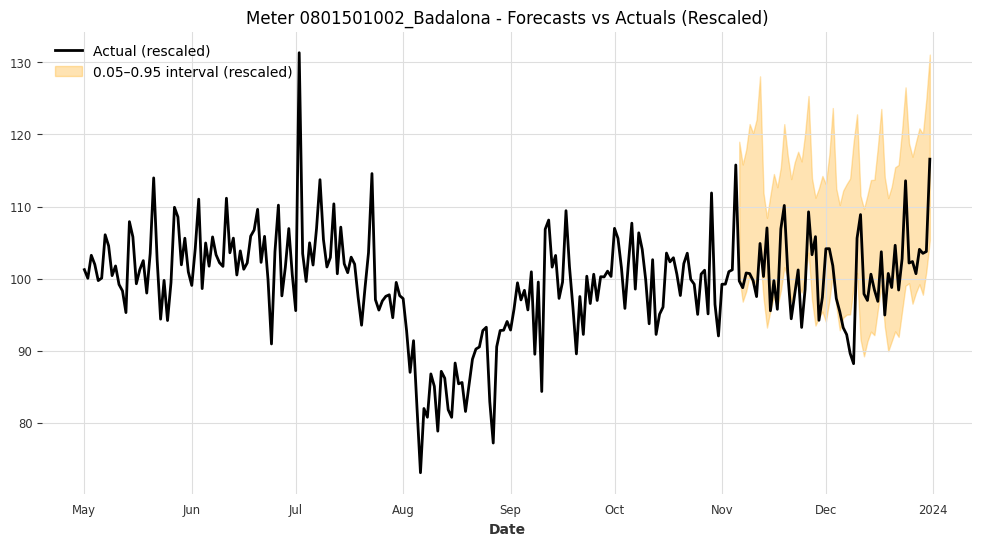

Meter 0801501002_Badalona - Coverage: 0.7679, Mean Interval Width (rescaled): 20.0663



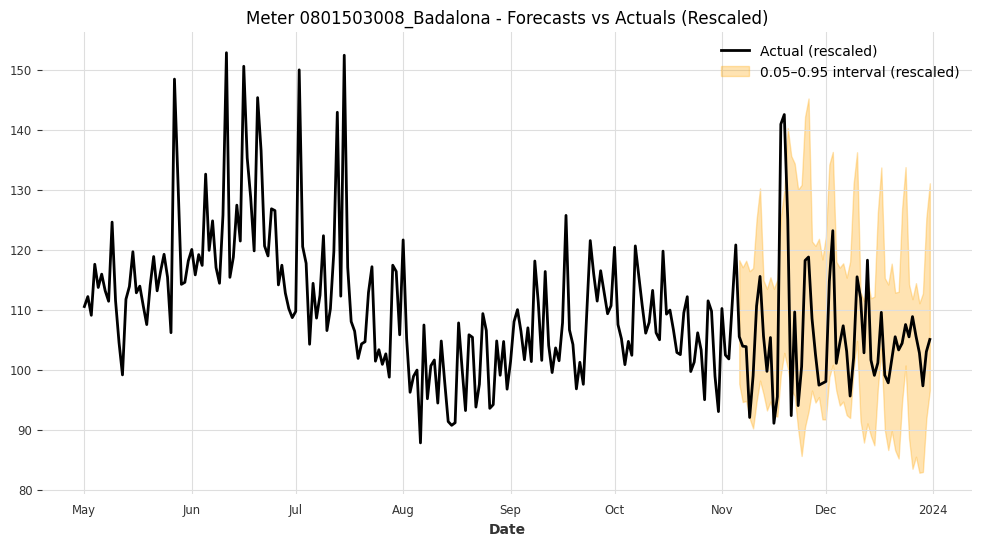

Meter 0801503008_Badalona - Coverage: 0.9107, Mean Interval Width (rescaled): 28.8353



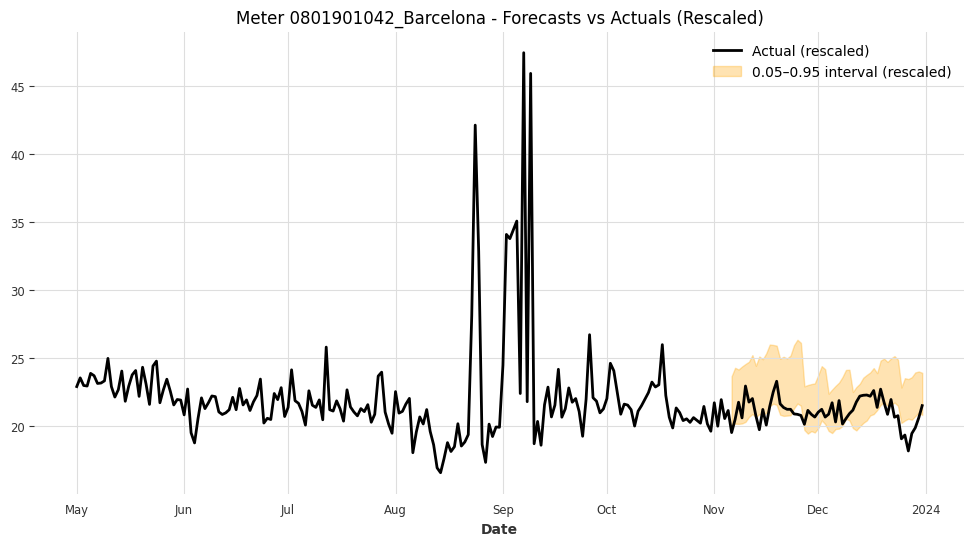

Meter 0801901042_Barcelona - Coverage: 0.6964, Mean Interval Width (rescaled): 3.6455



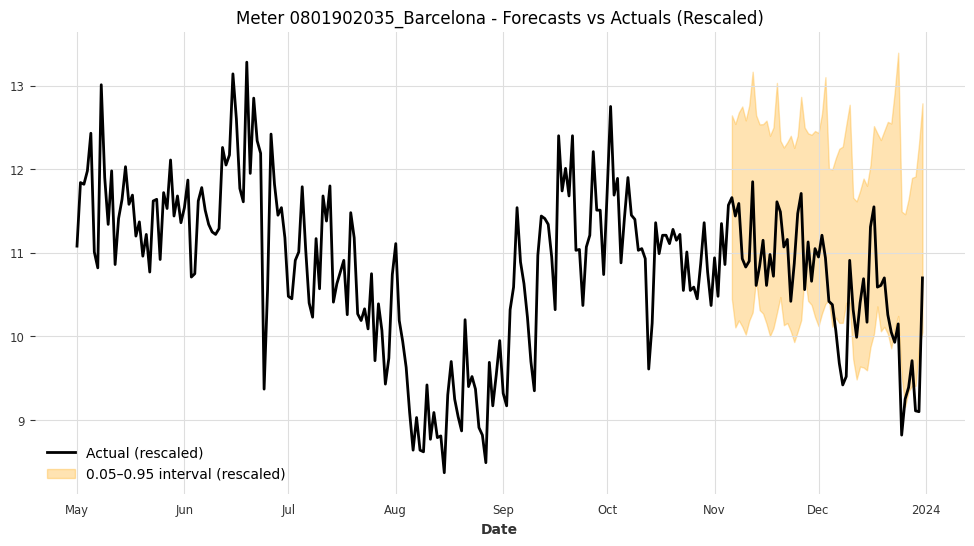

Meter 0801902035_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 2.3105



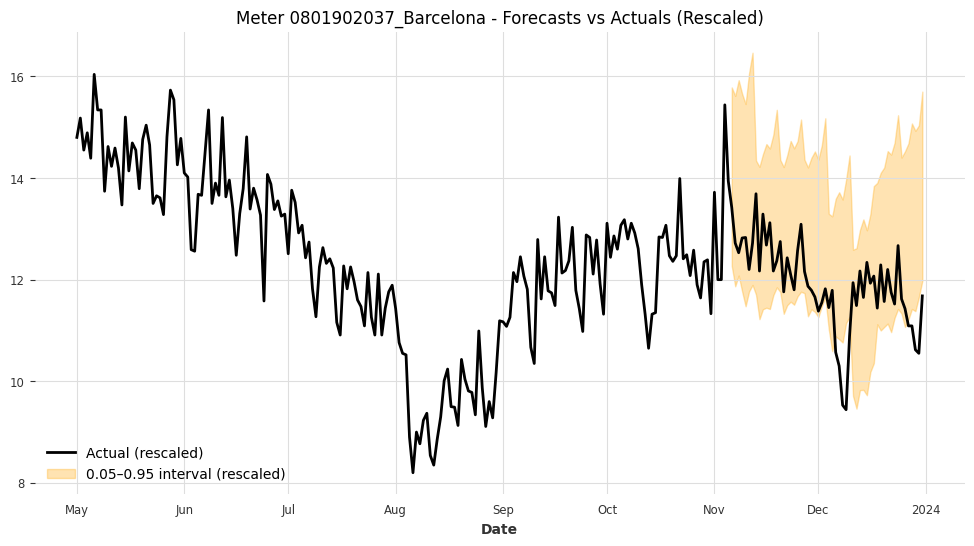

Meter 0801902037_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 3.2386



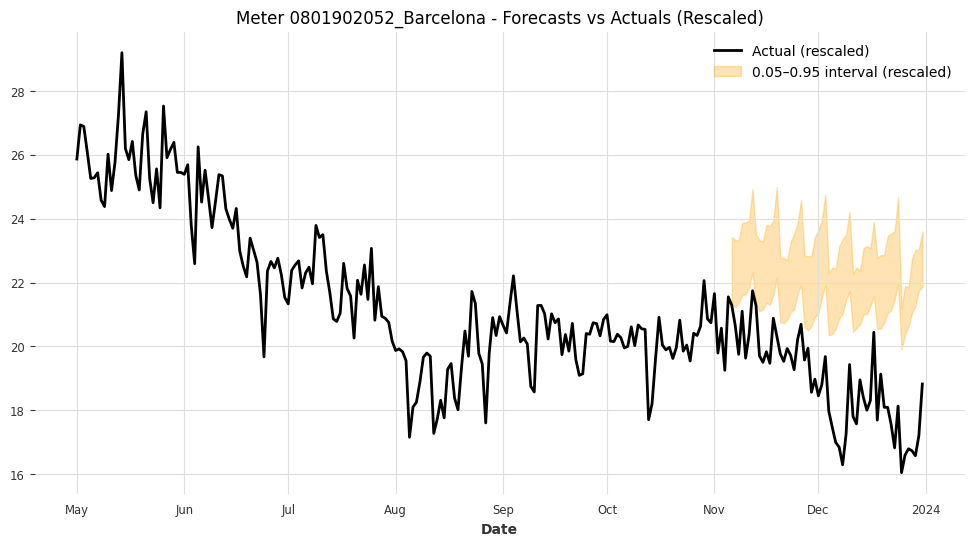

Meter 0801902052_Barcelona - Coverage: 0.0000, Mean Interval Width (rescaled): 2.1459



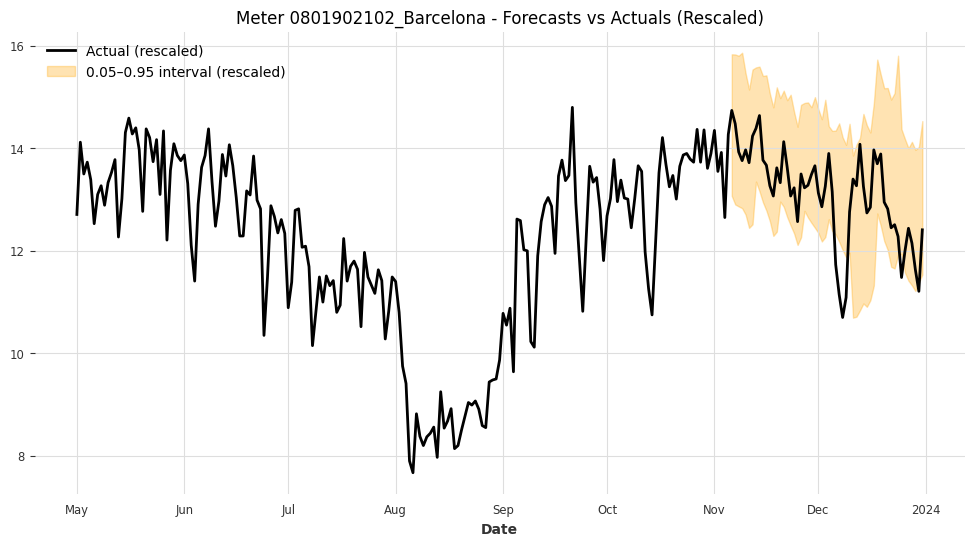

Meter 0801902102_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.6997



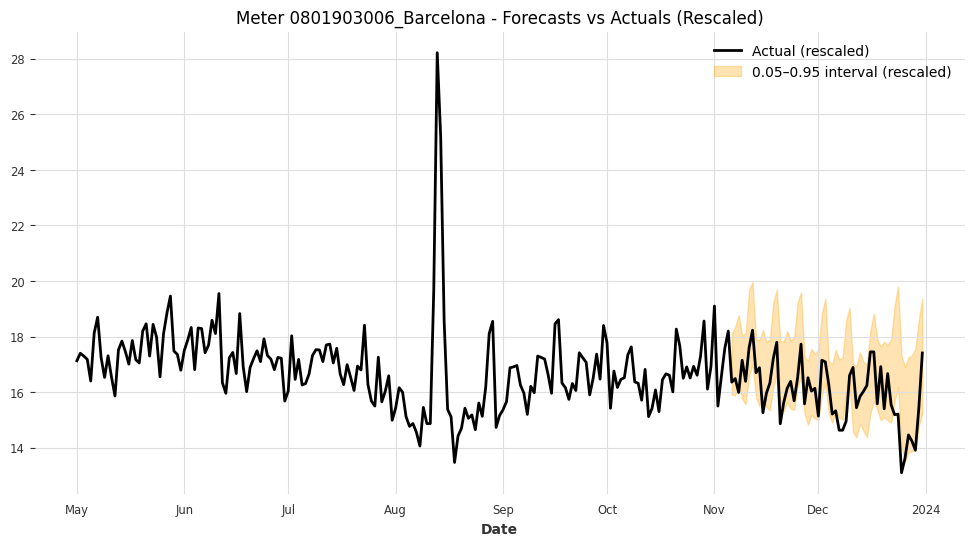

Meter 0801903006_Barcelona - Coverage: 0.8036, Mean Interval Width (rescaled): 2.7245



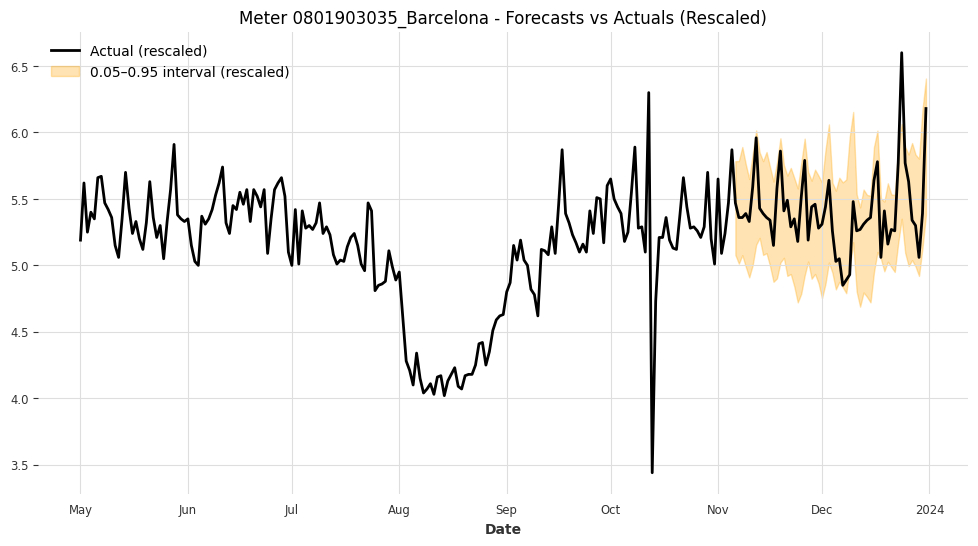

Meter 0801903035_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 0.7980



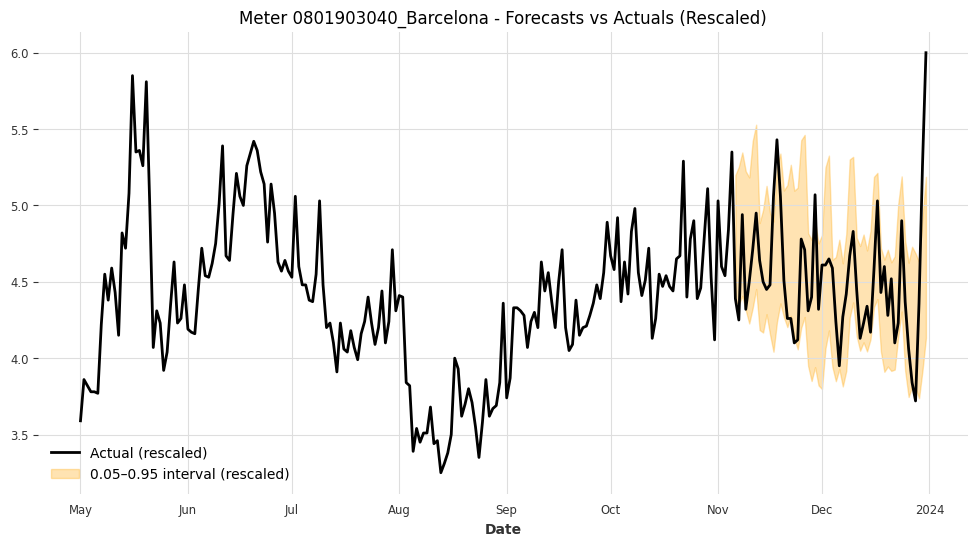

Meter 0801903040_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 0.8909



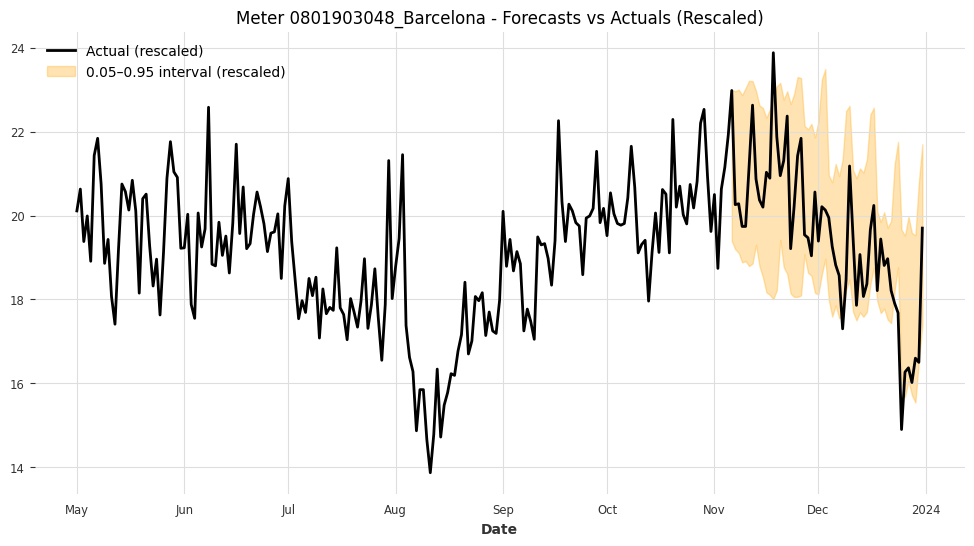

Meter 0801903048_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.7878



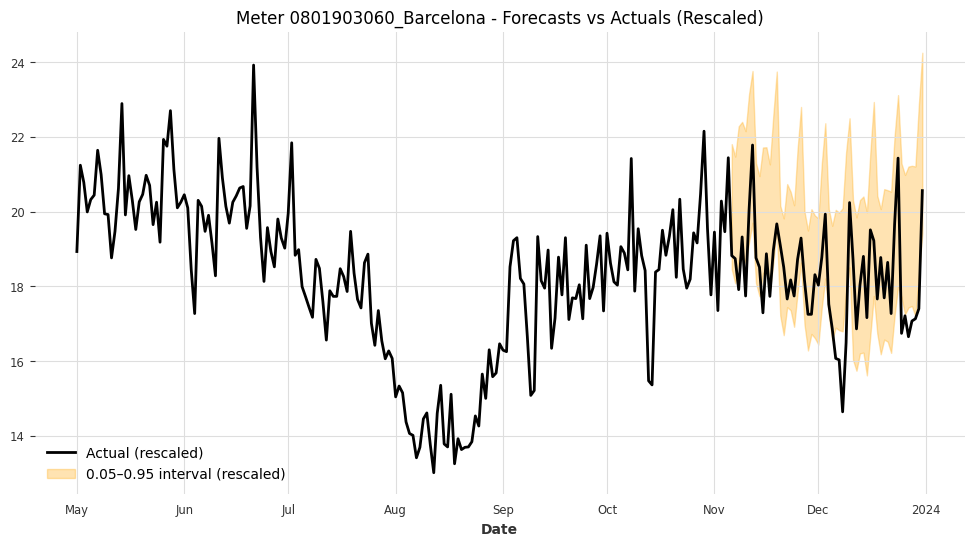

Meter 0801903060_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 3.7585



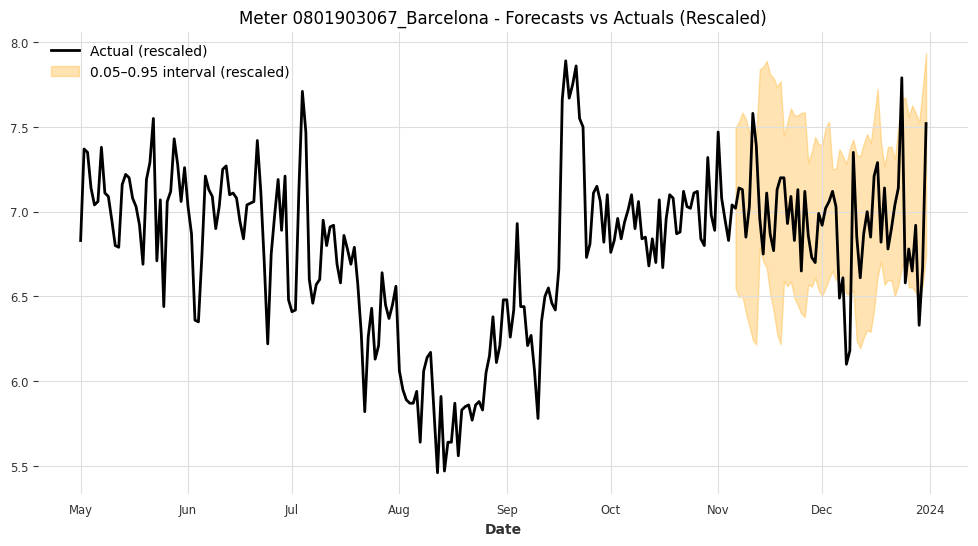

Meter 0801903067_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 1.0109



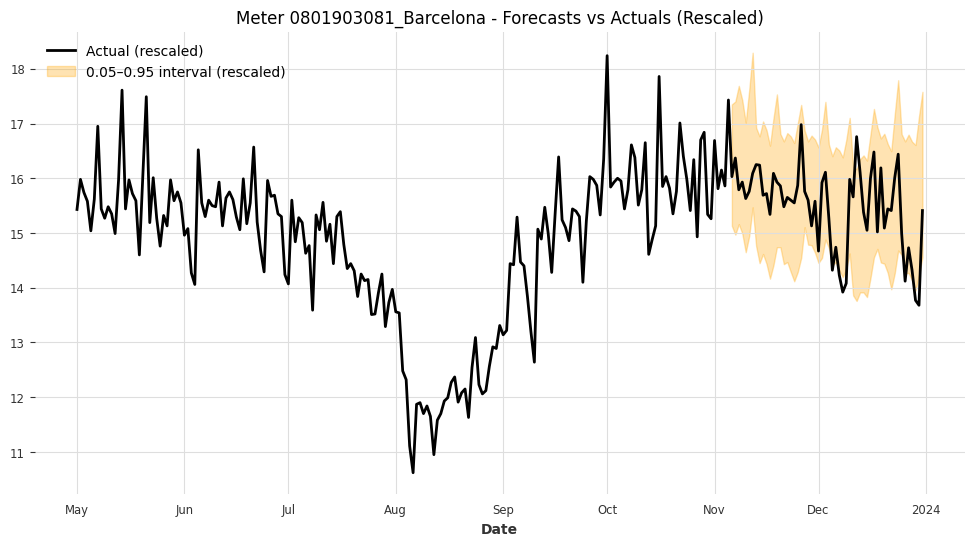

Meter 0801903081_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 2.4157



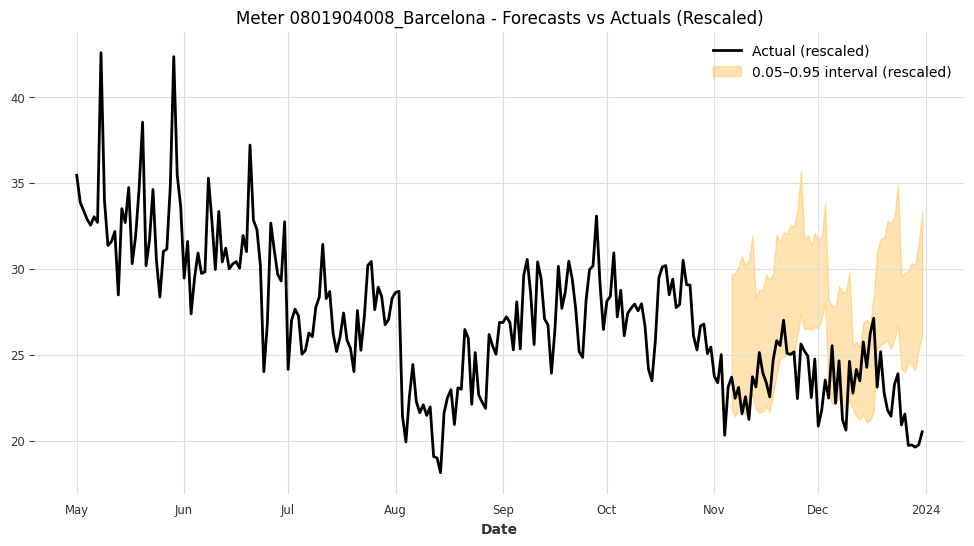

Meter 0801904008_Barcelona - Coverage: 0.4643, Mean Interval Width (rescaled): 6.5781



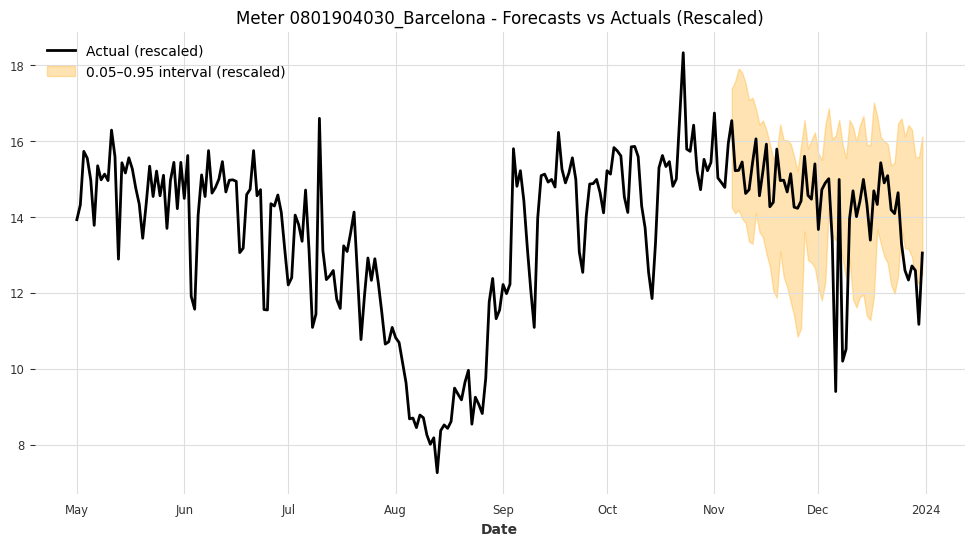

Meter 0801904030_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 3.5512



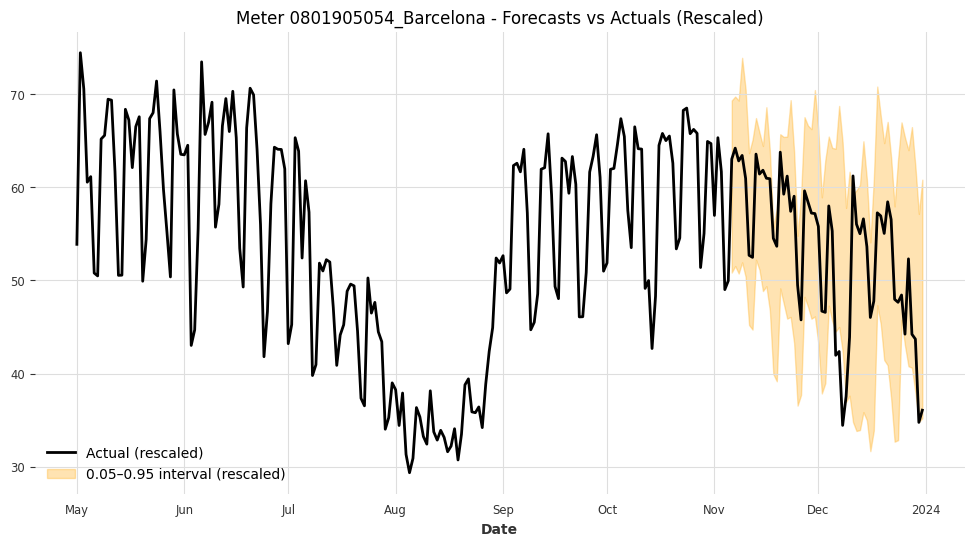

Meter 0801905054_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 21.6051



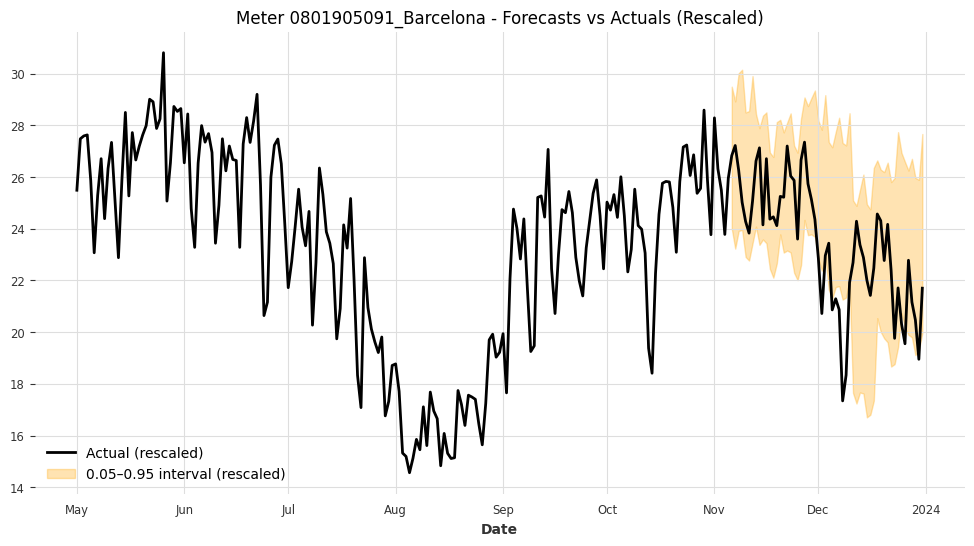

Meter 0801905091_Barcelona - Coverage: 0.7857, Mean Interval Width (rescaled): 6.1034



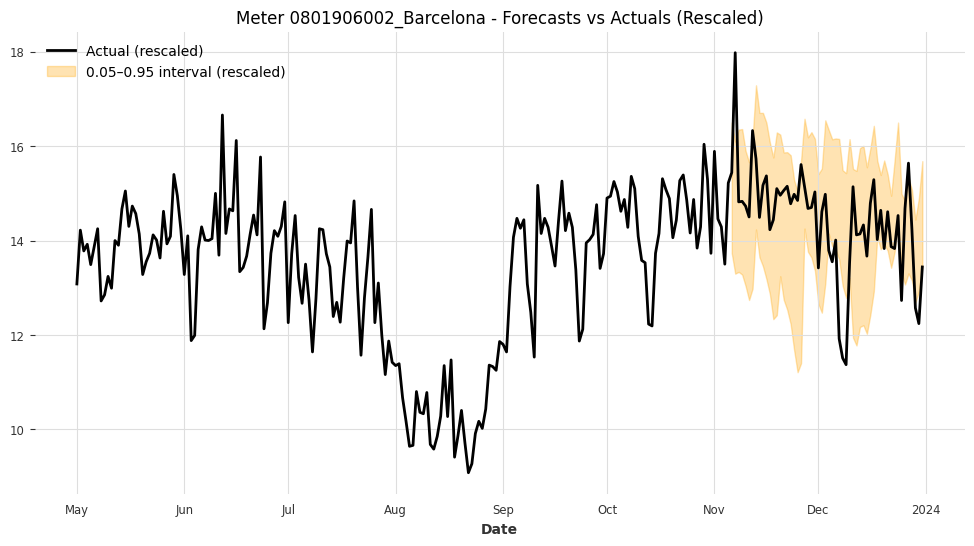

Meter 0801906002_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 2.7922



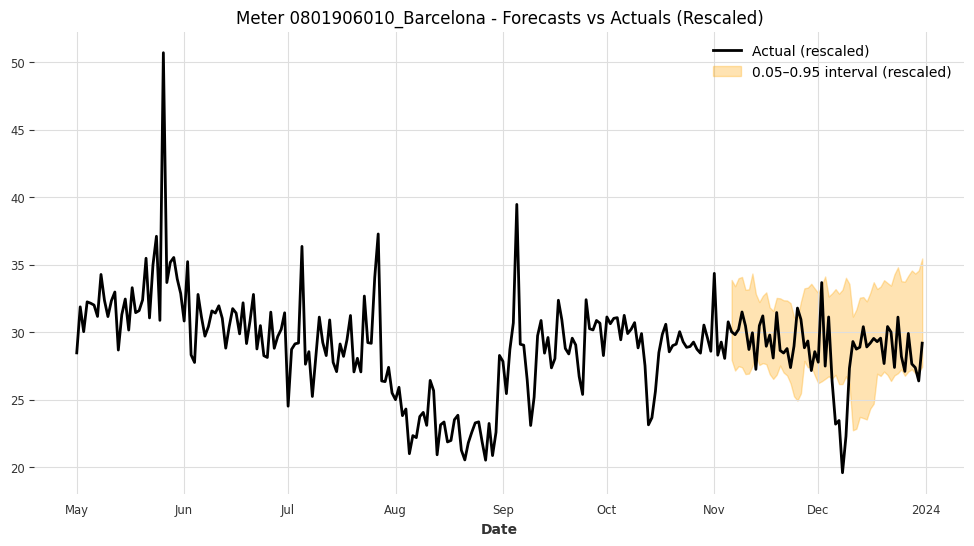

Meter 0801906010_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 6.6736



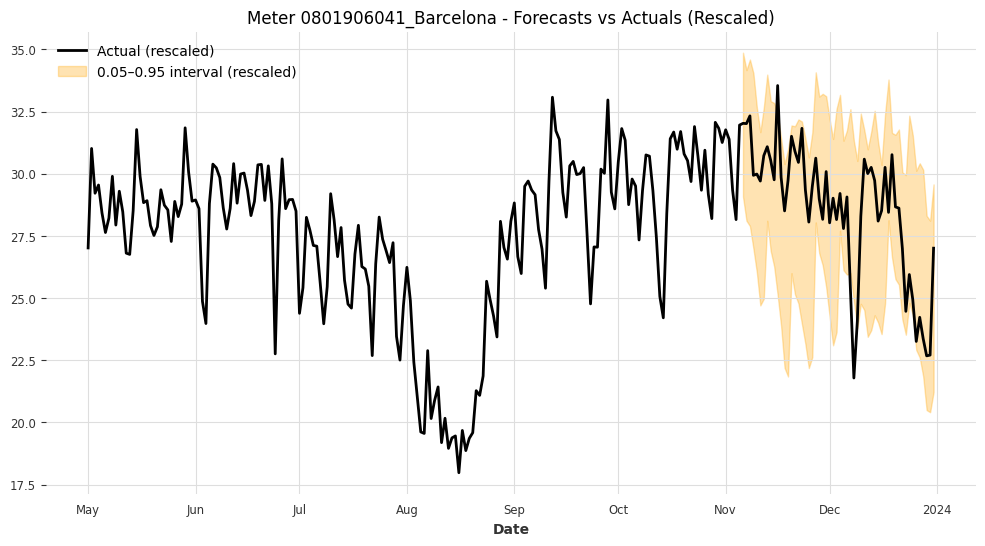

Meter 0801906041_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 7.0896



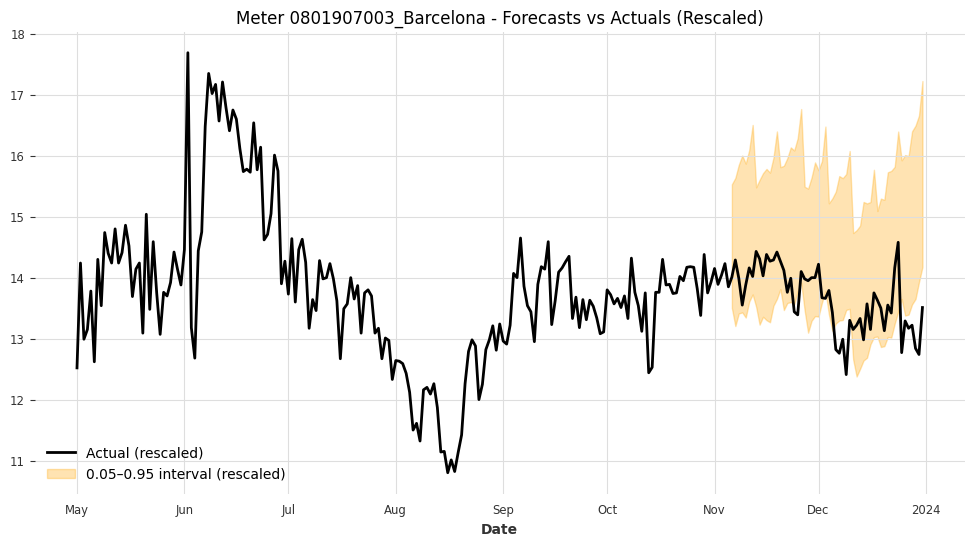

Meter 0801907003_Barcelona - Coverage: 0.7321, Mean Interval Width (rescaled): 2.4541



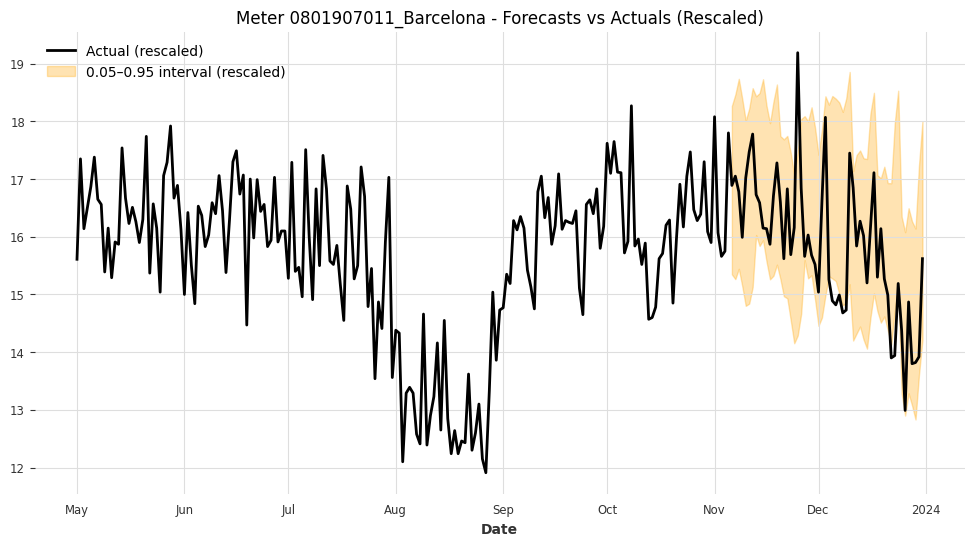

Meter 0801907011_Barcelona - Coverage: 0.8393, Mean Interval Width (rescaled): 3.0676



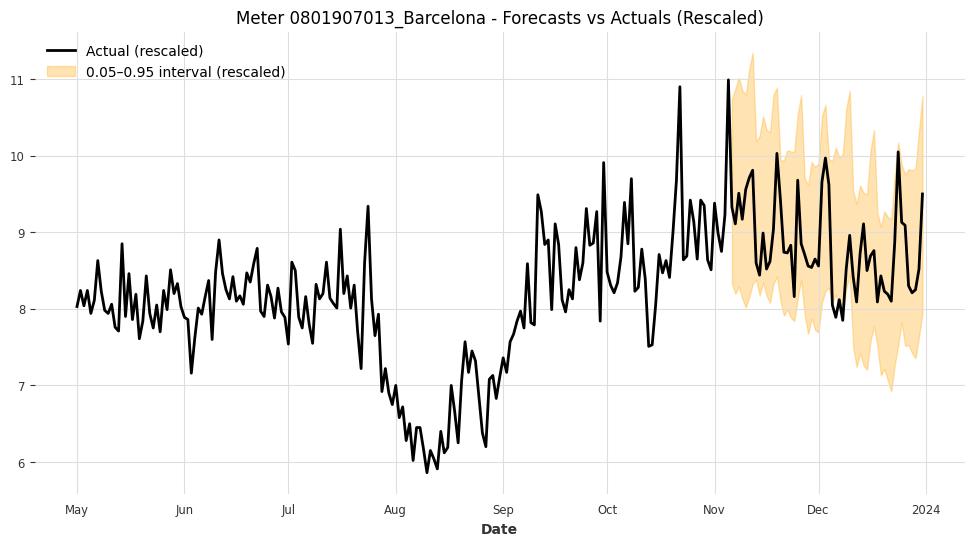

Meter 0801907013_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 2.2712



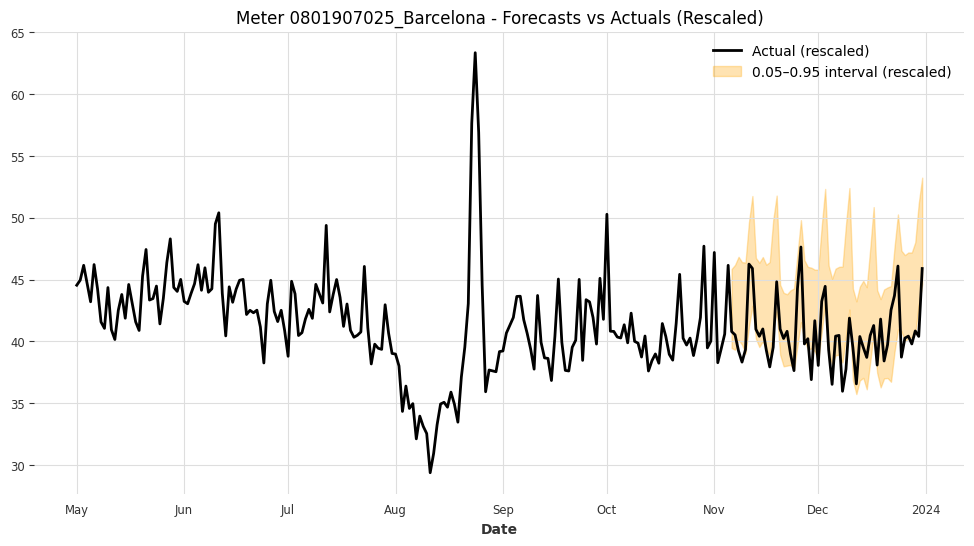

Meter 0801907025_Barcelona - Coverage: 0.7143, Mean Interval Width (rescaled): 7.4802



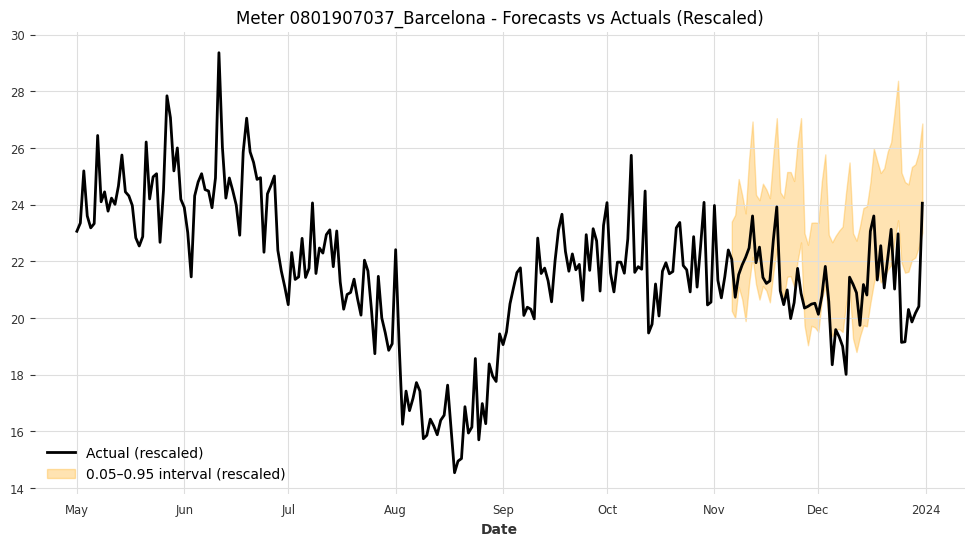

Meter 0801907037_Barcelona - Coverage: 0.6071, Mean Interval Width (rescaled): 3.8123



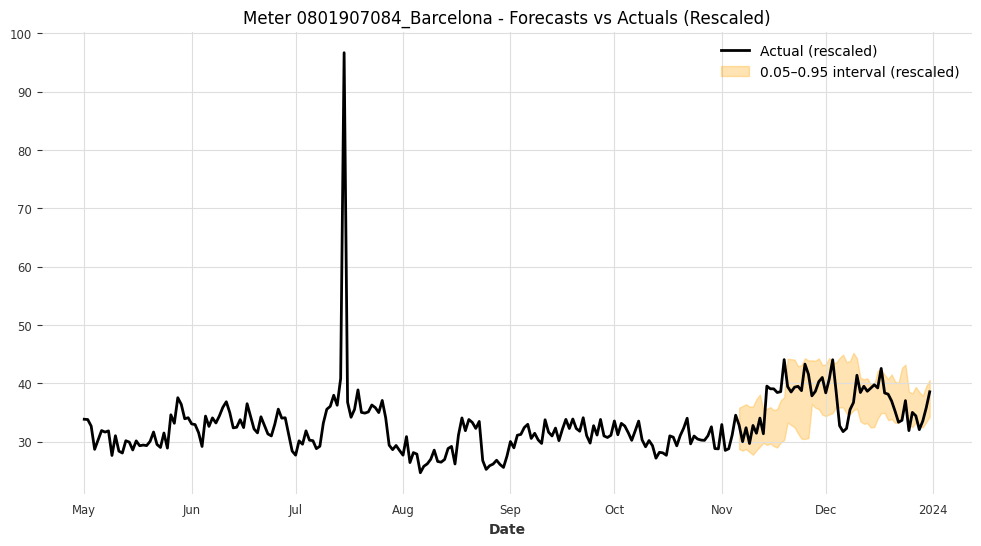

Meter 0801907084_Barcelona - Coverage: 0.7500, Mean Interval Width (rescaled): 8.0771



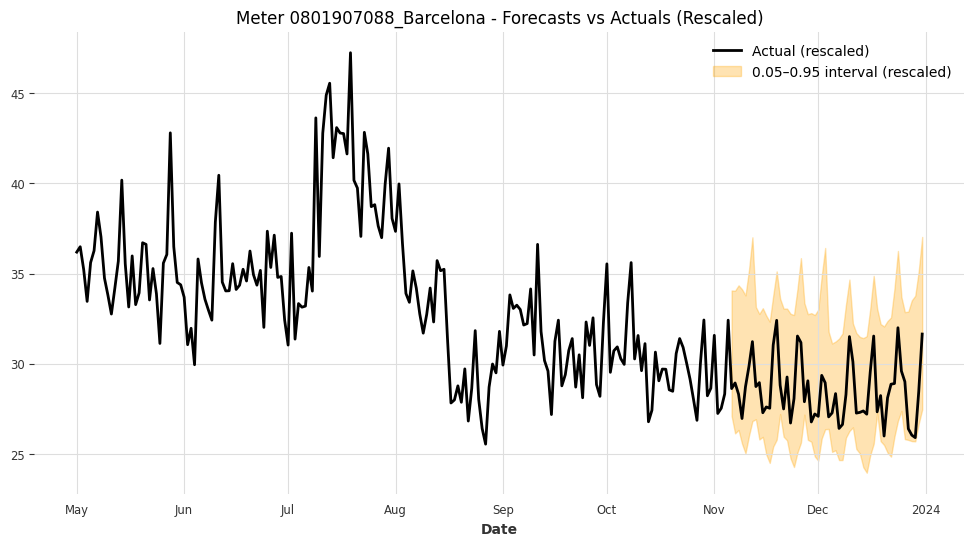

Meter 0801907088_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 7.6517



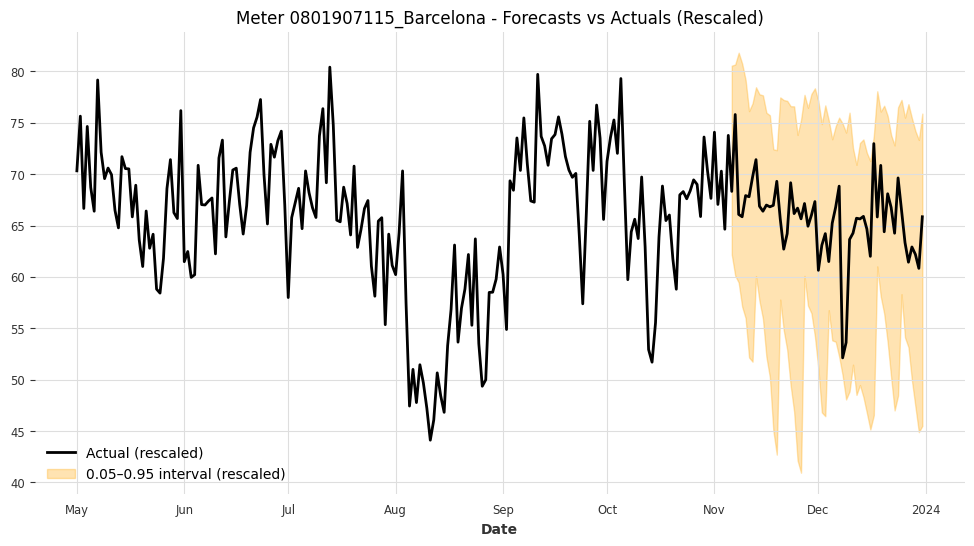

Meter 0801907115_Barcelona - Coverage: 1.0000, Mean Interval Width (rescaled): 23.9260



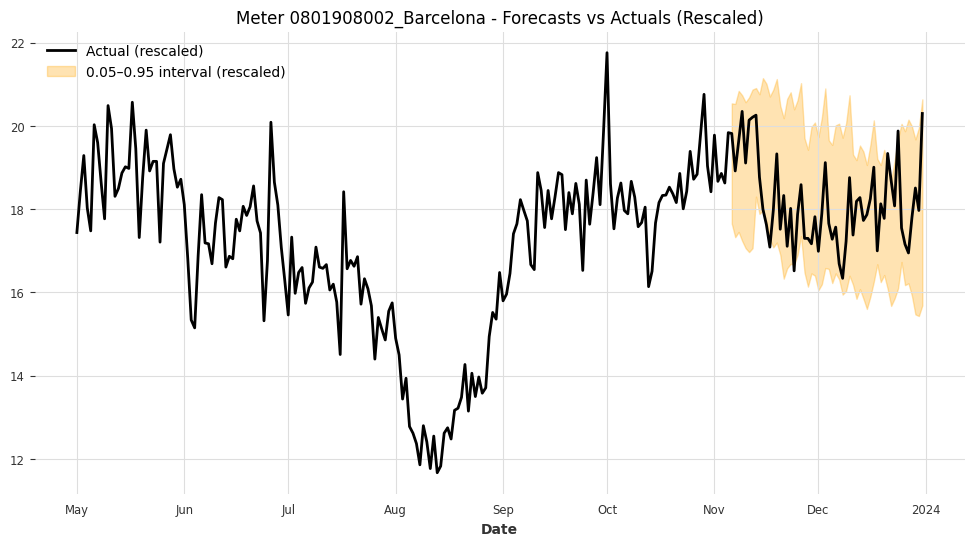

Meter 0801908002_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.5672



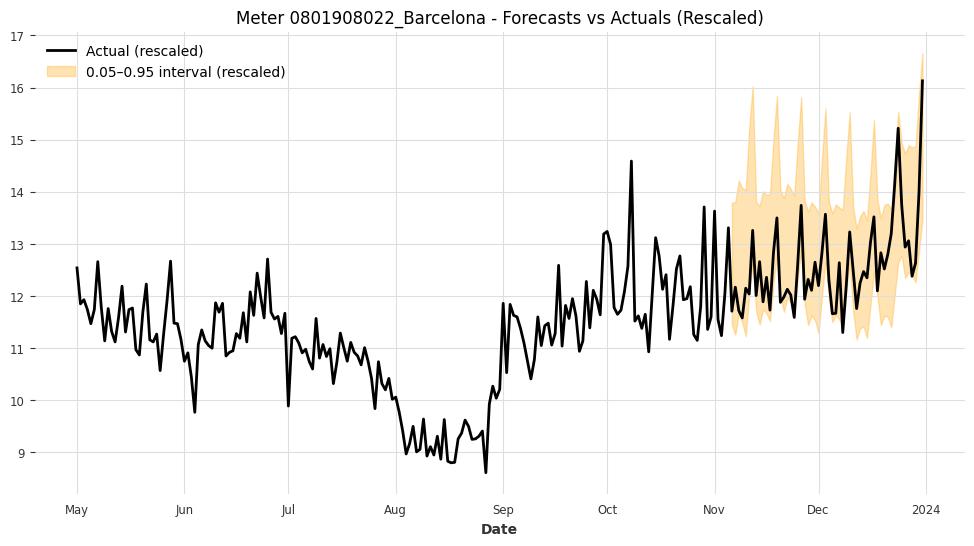

Meter 0801908022_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 2.4195



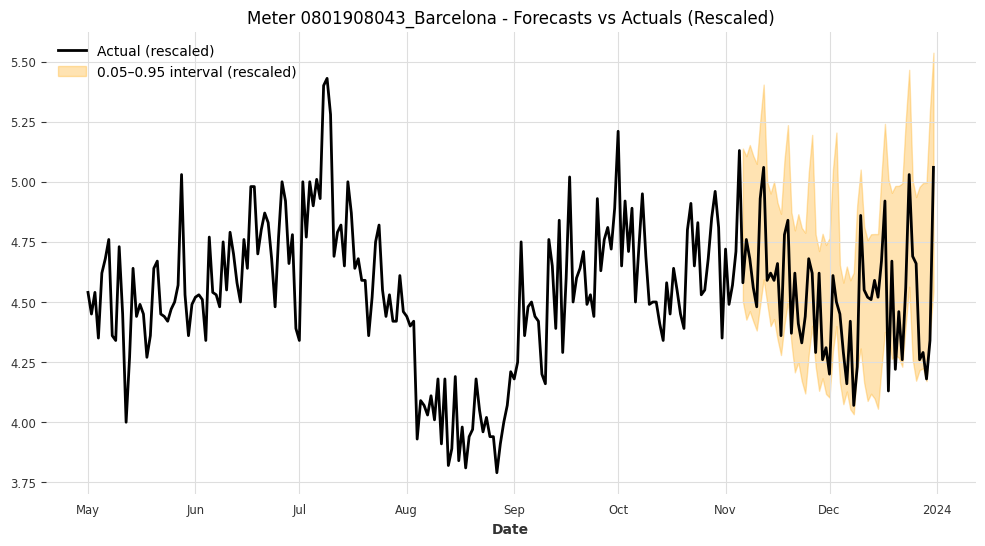

Meter 0801908043_Barcelona - Coverage: 0.9464, Mean Interval Width (rescaled): 0.6876



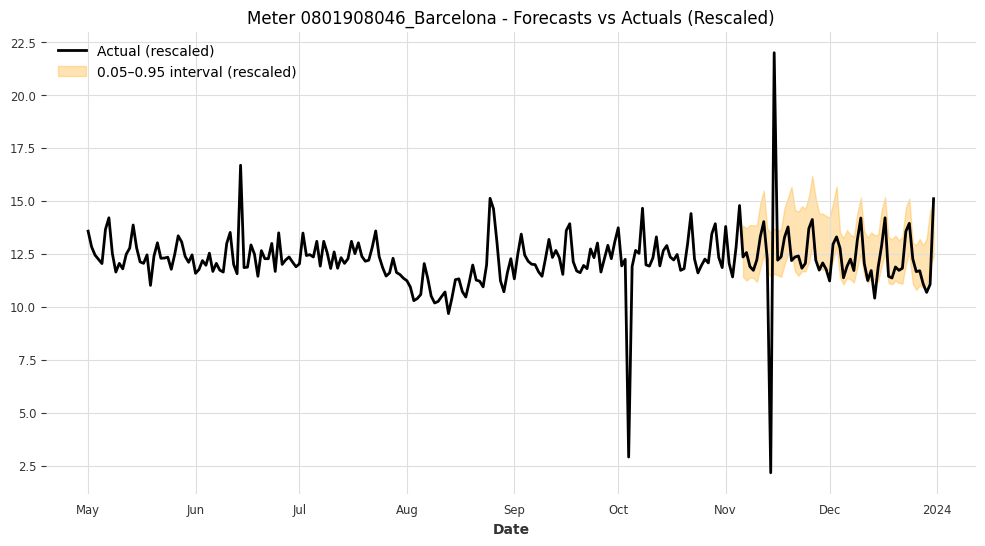

Meter 0801908046_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 2.4623



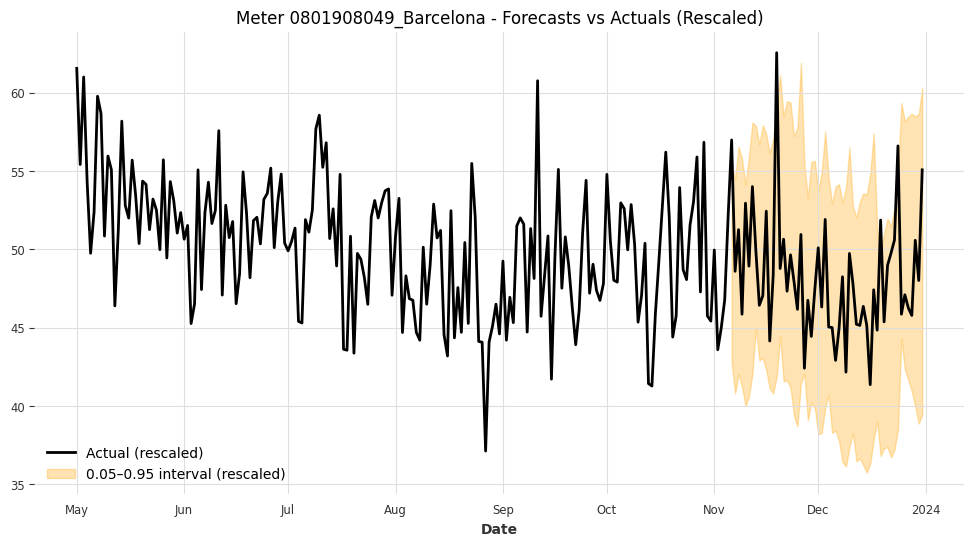

Meter 0801908049_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 16.0768



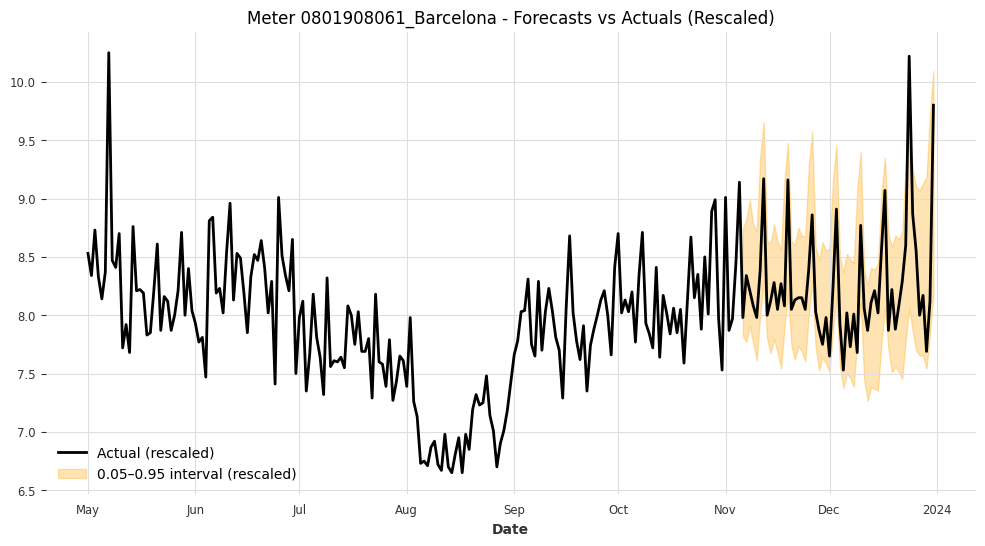

Meter 0801908061_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 1.1612



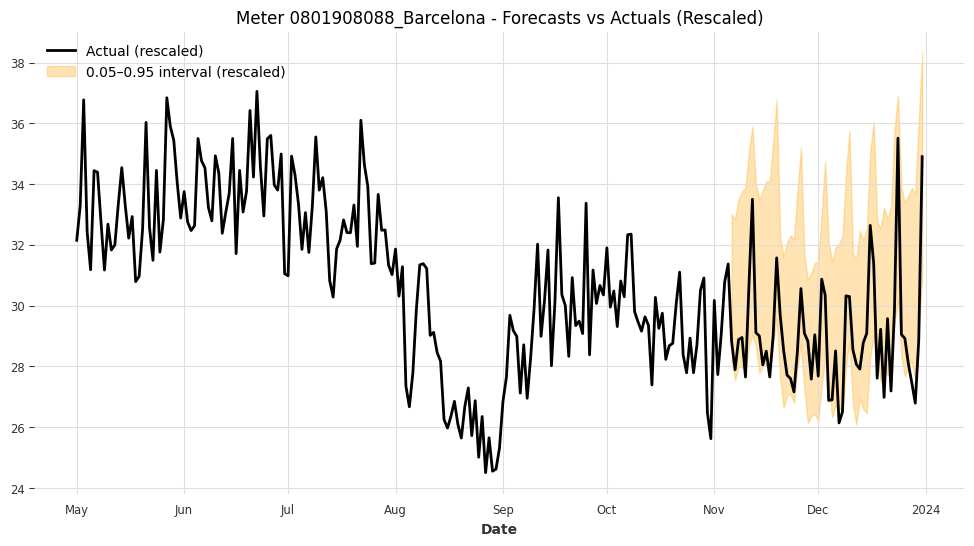

Meter 0801908088_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 5.7118



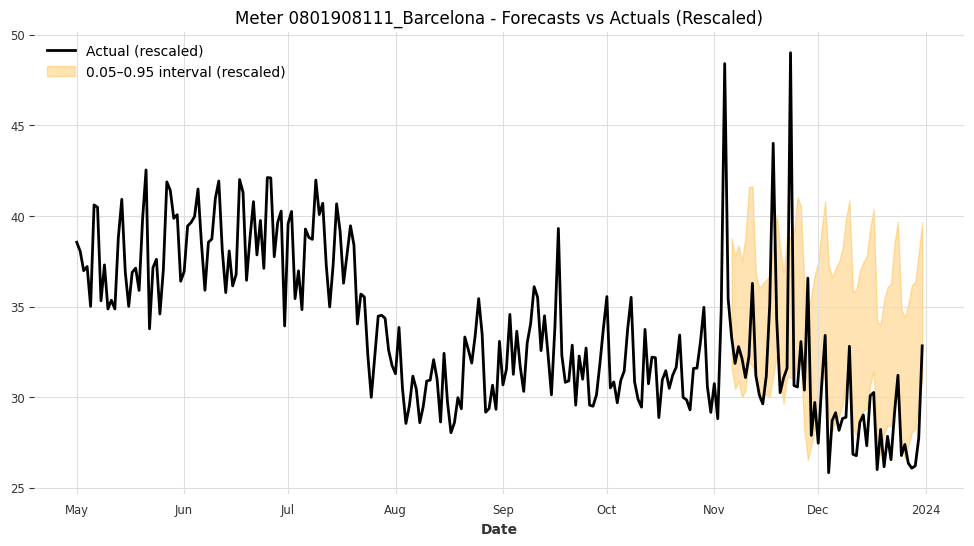

Meter 0801908111_Barcelona - Coverage: 0.4821, Mean Interval Width (rescaled): 7.9887



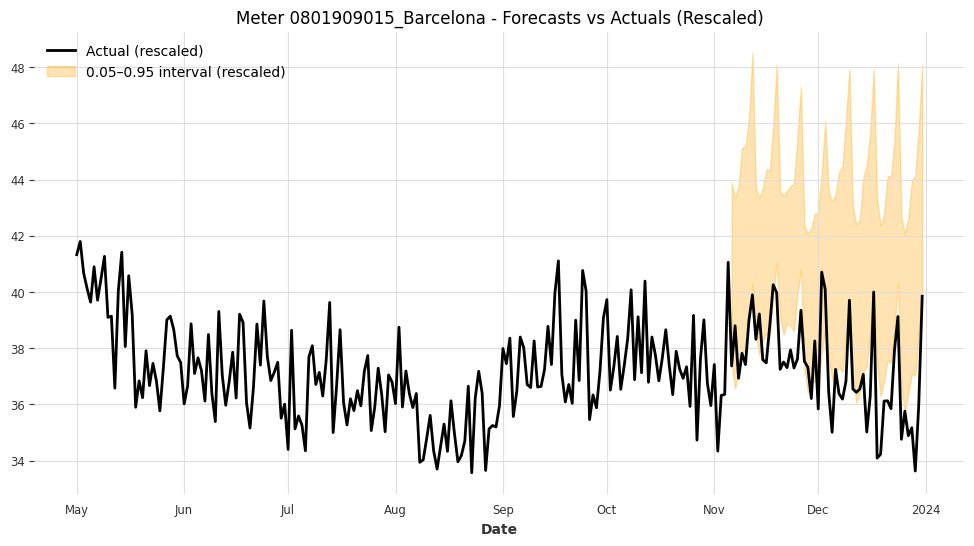

Meter 0801909015_Barcelona - Coverage: 0.2857, Mean Interval Width (rescaled): 6.4280



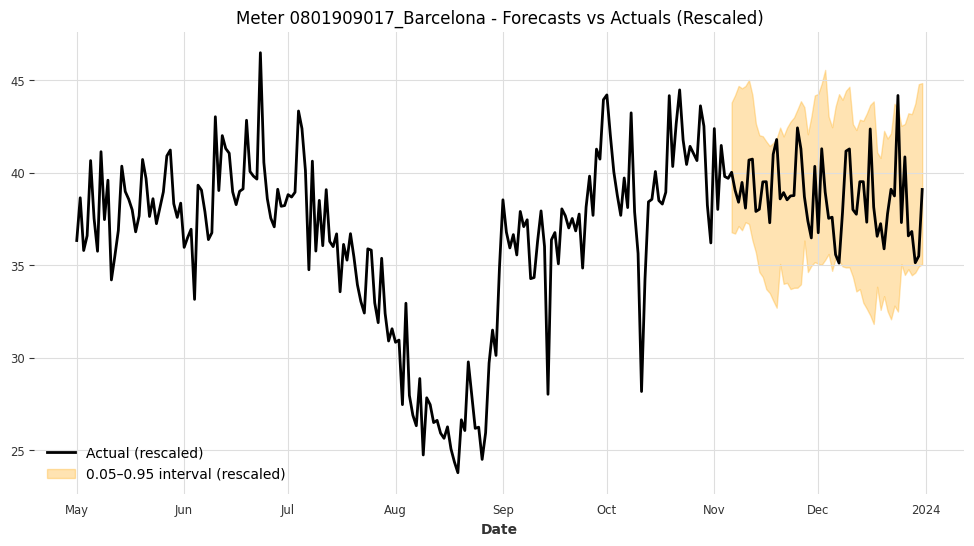

Meter 0801909017_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 8.7254



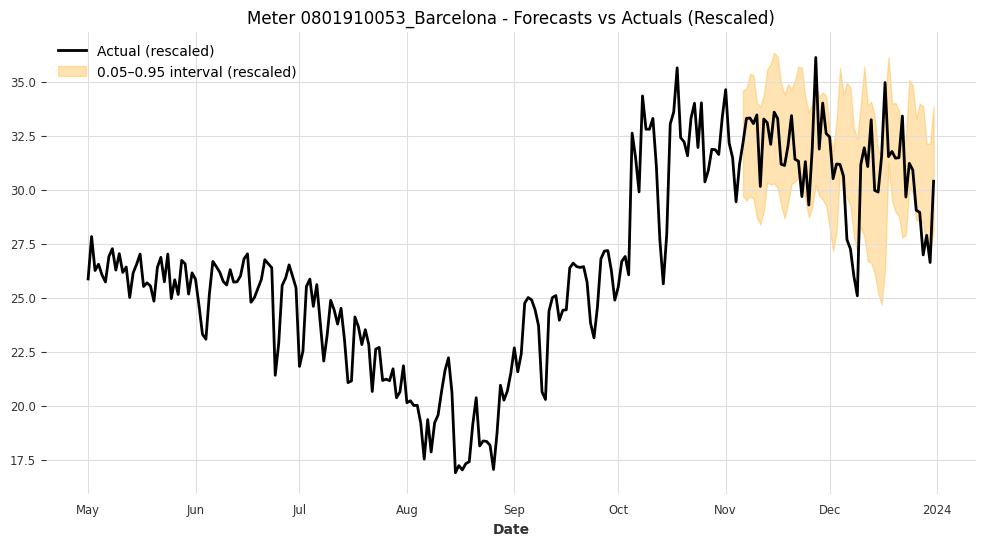

Meter 0801910053_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 5.3722



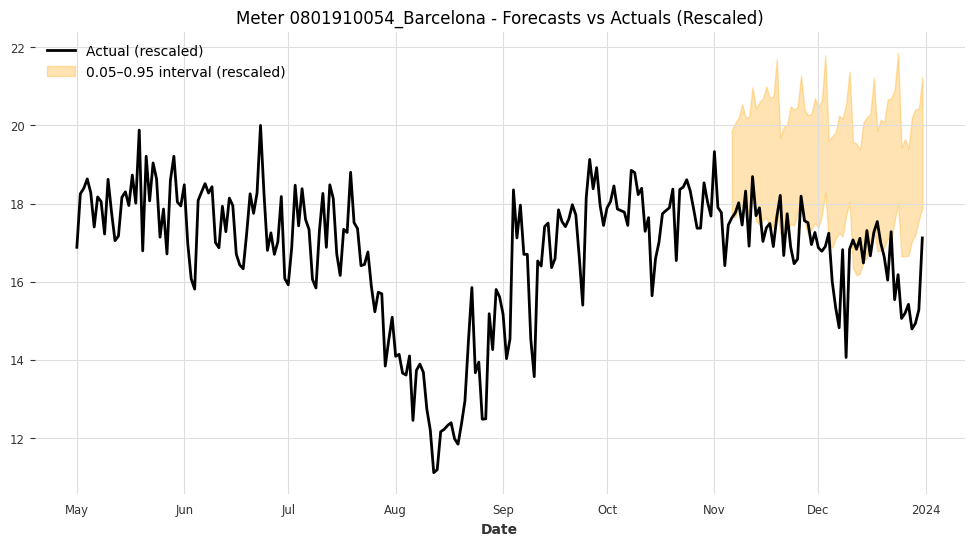

Meter 0801910054_Barcelona - Coverage: 0.3571, Mean Interval Width (rescaled): 3.0593



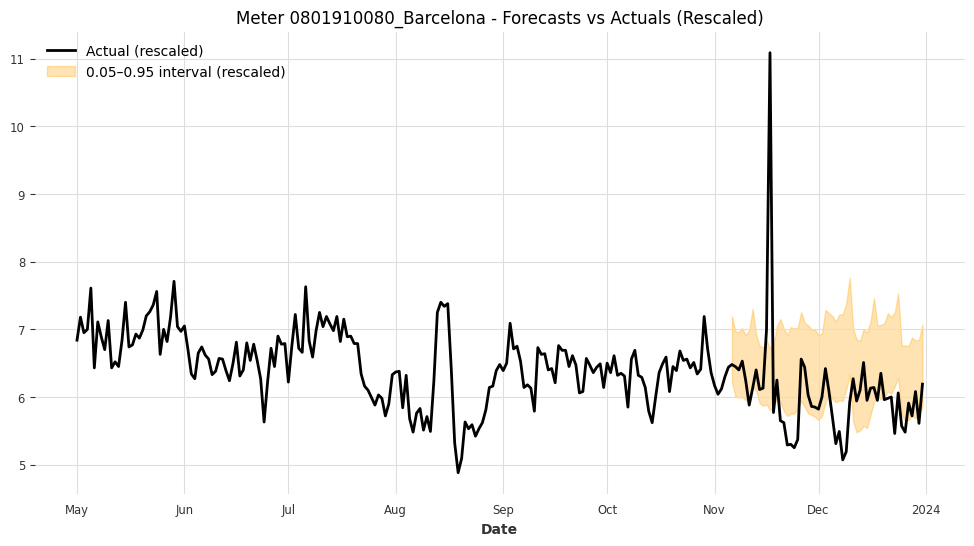

Meter 0801910080_Barcelona - Coverage: 0.5179, Mean Interval Width (rescaled): 1.1681



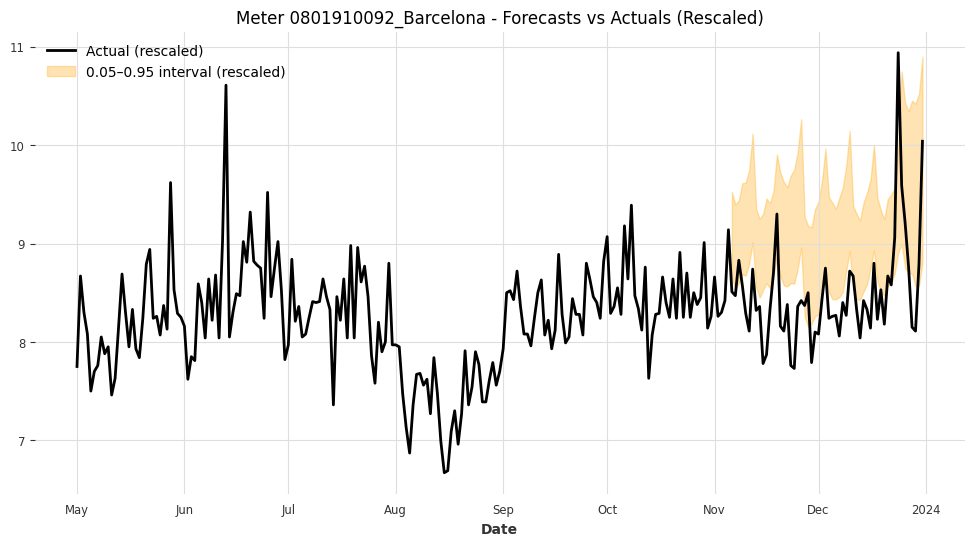

Meter 0801910092_Barcelona - Coverage: 0.2679, Mean Interval Width (rescaled): 1.0794



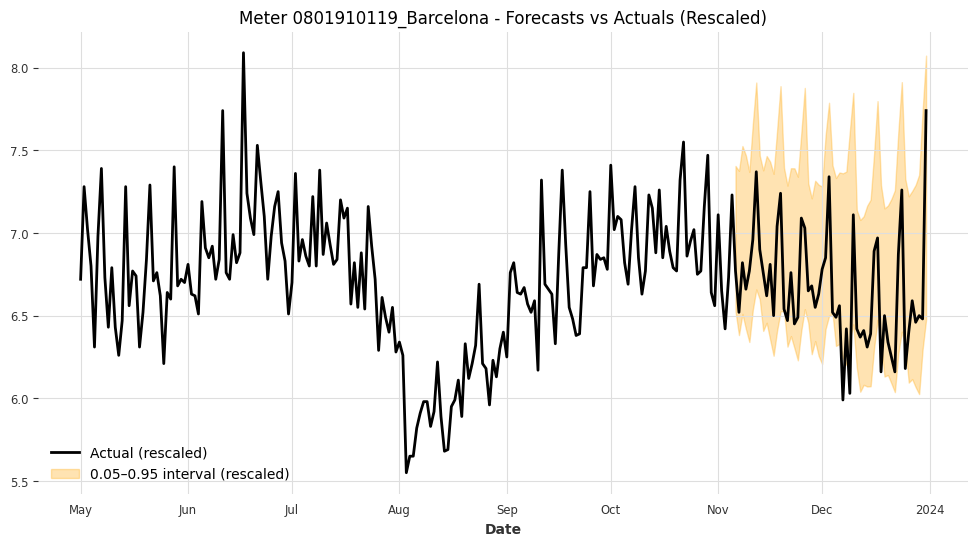

Meter 0801910119_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 1.1160



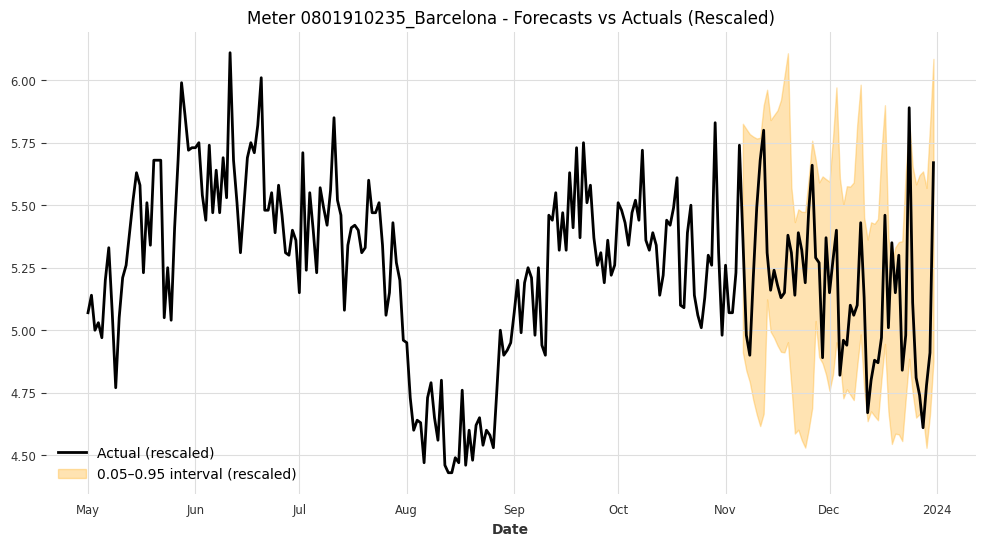

Meter 0801910235_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 0.9050



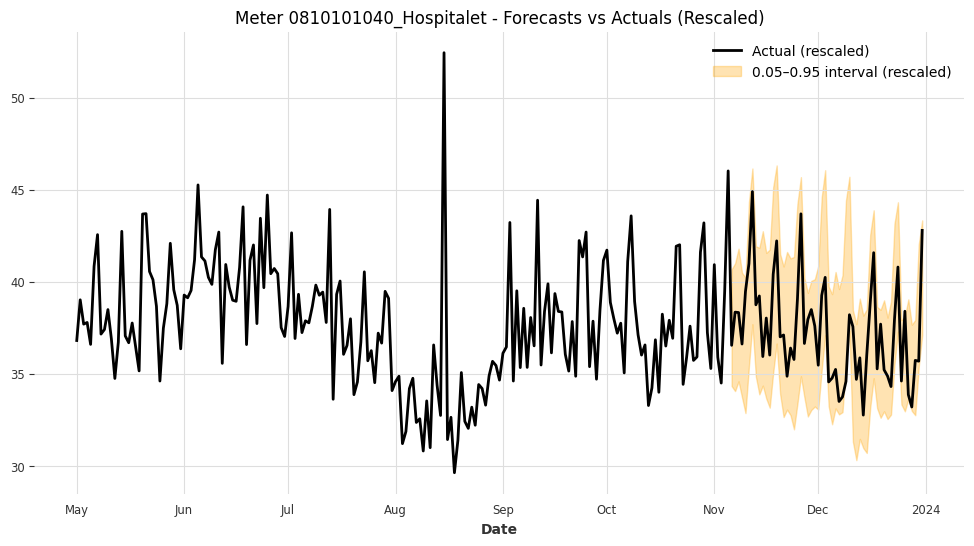

Meter 0810101040_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 7.4724



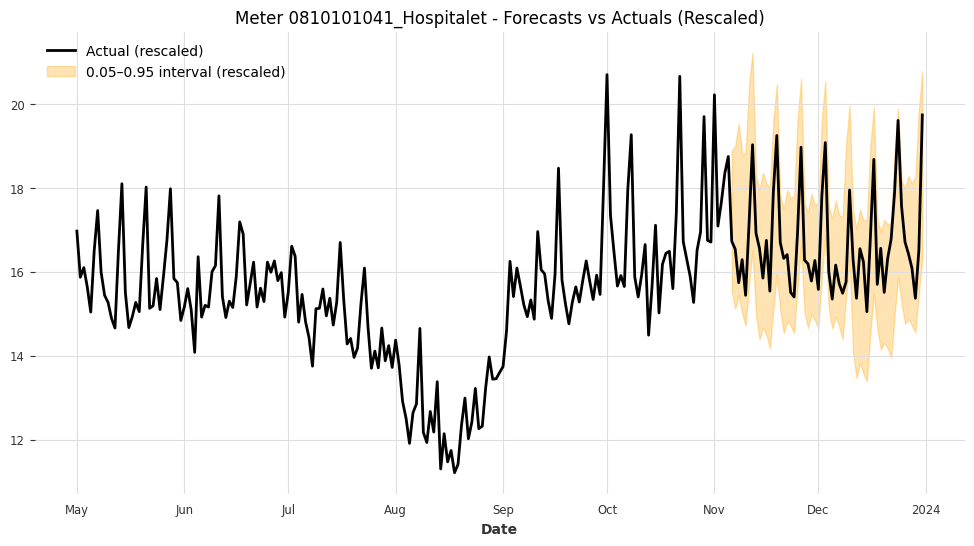

Meter 0810101041_Hospitalet - Coverage: 1.0000, Mean Interval Width (rescaled): 3.4954



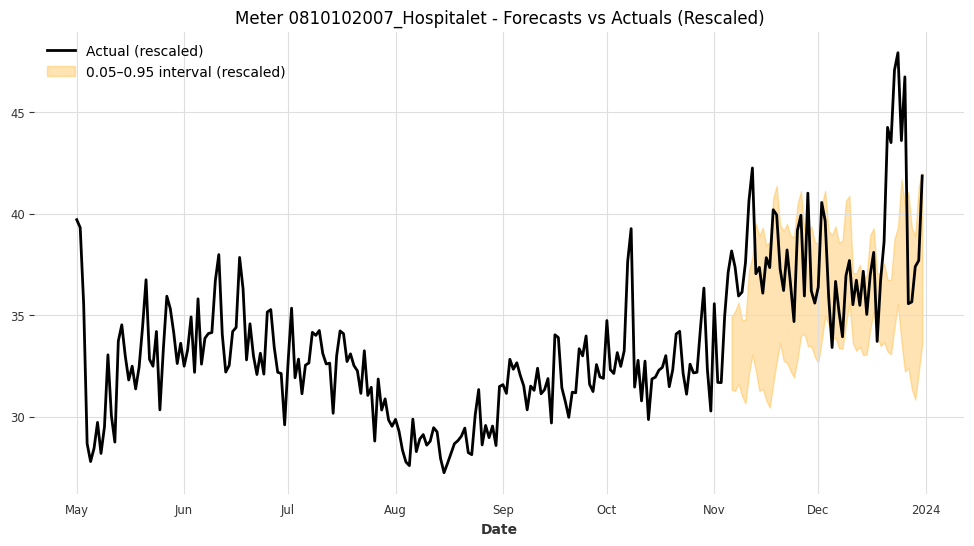

Meter 0810102007_Hospitalet - Coverage: 0.6607, Mean Interval Width (rescaled): 5.7791



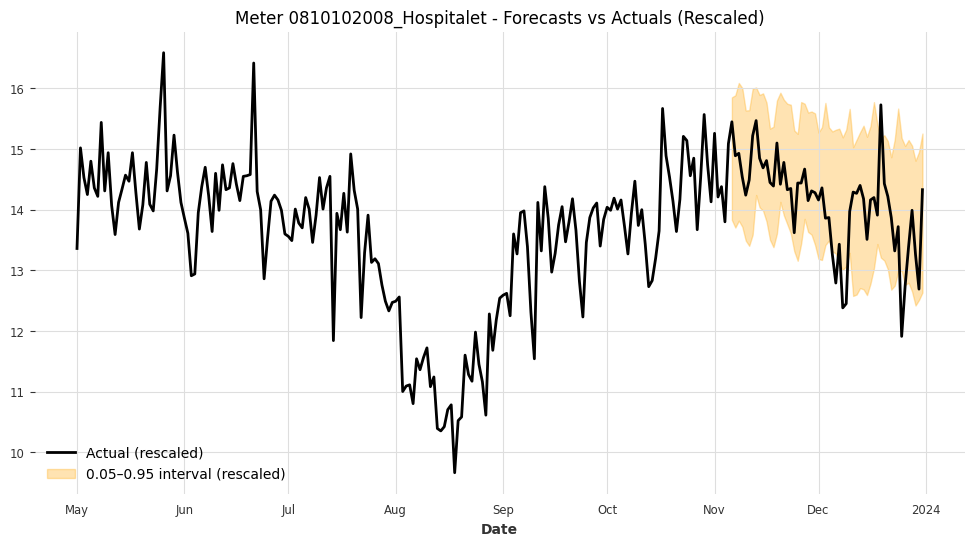

Meter 0810102008_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.2015



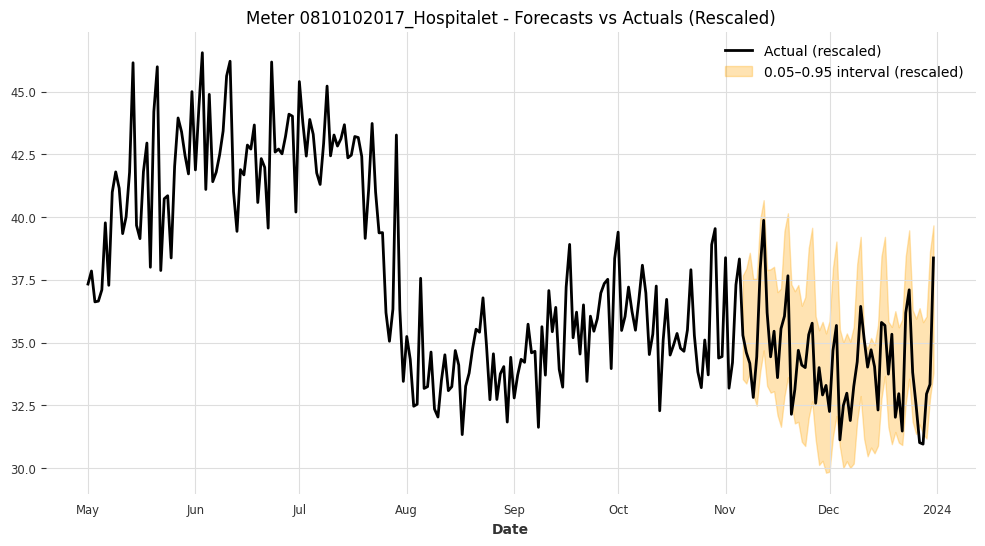

Meter 0810102017_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 5.2726



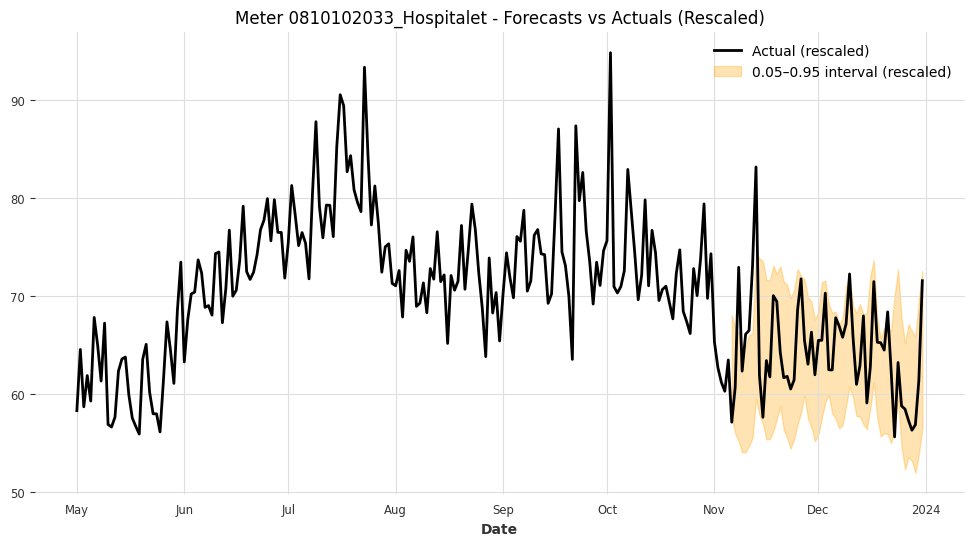

Meter 0810102033_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 12.7708



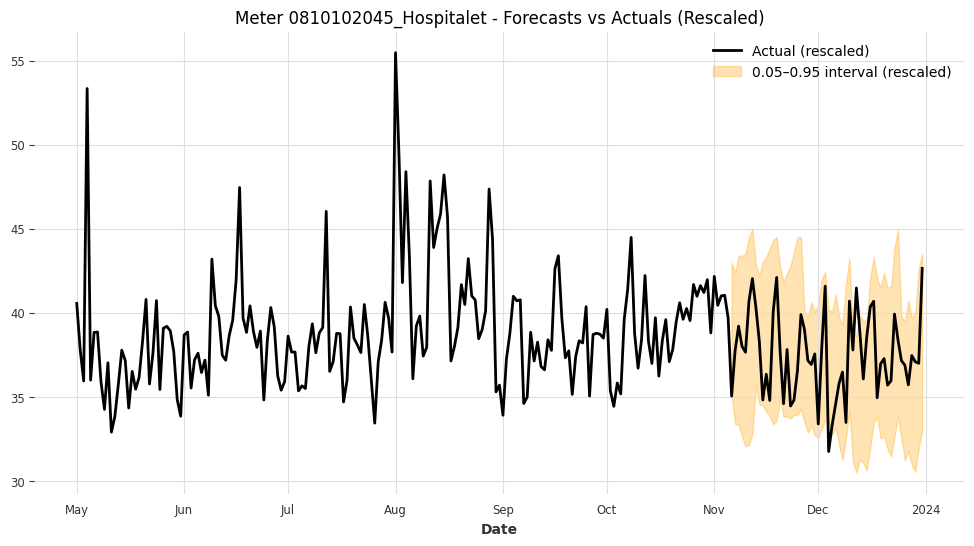

Meter 0810102045_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 9.0427



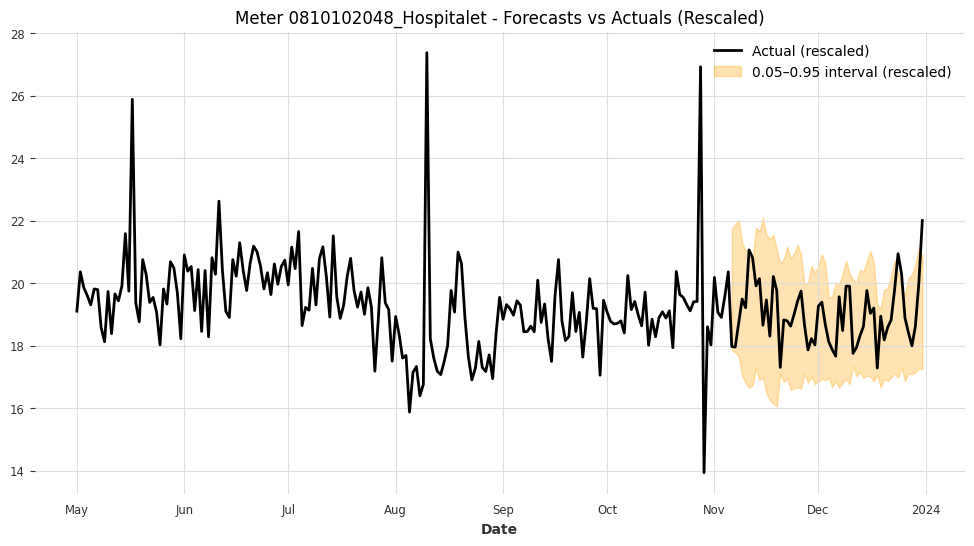

Meter 0810102048_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 3.7100



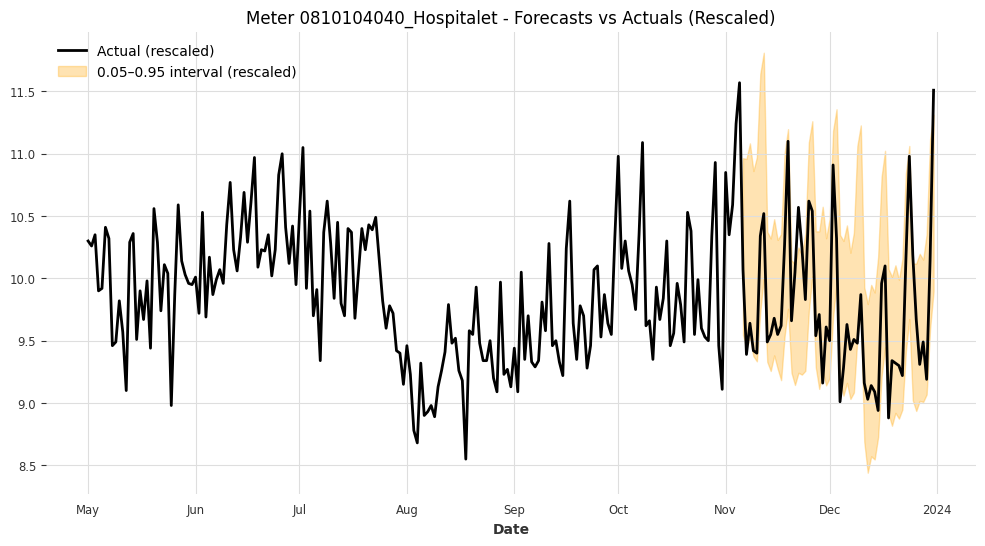

Meter 0810104040_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 1.3001



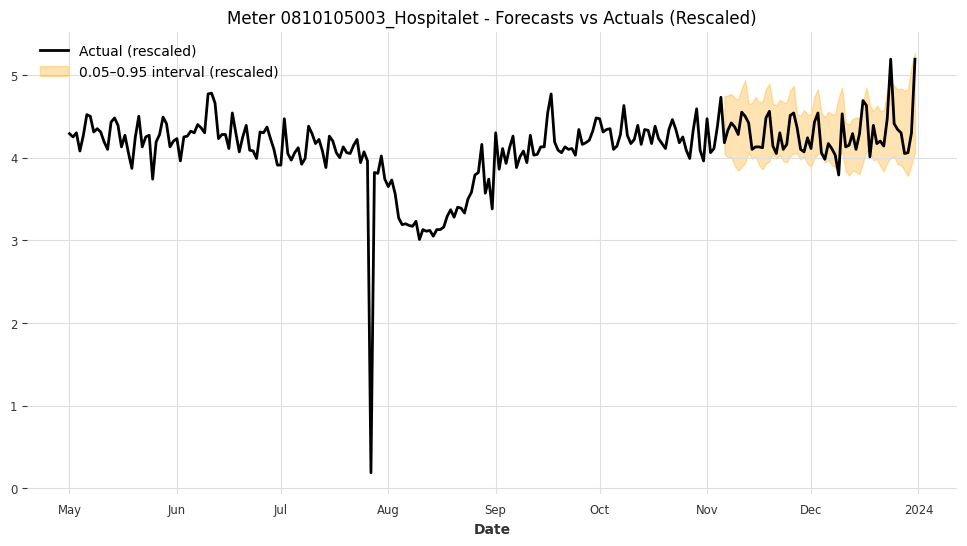

Meter 0810105003_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 0.7439



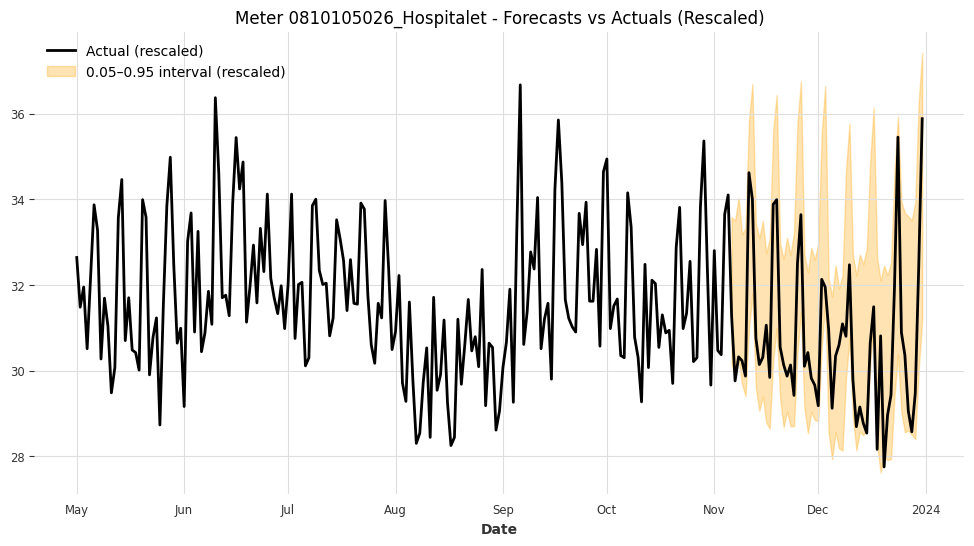

Meter 0810105026_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 4.4496



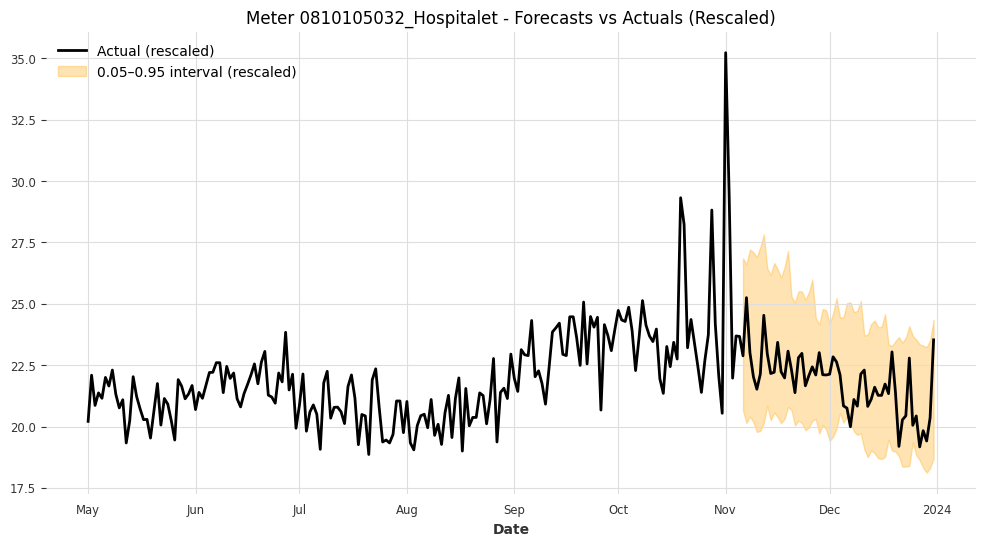

Meter 0810105032_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 5.3355



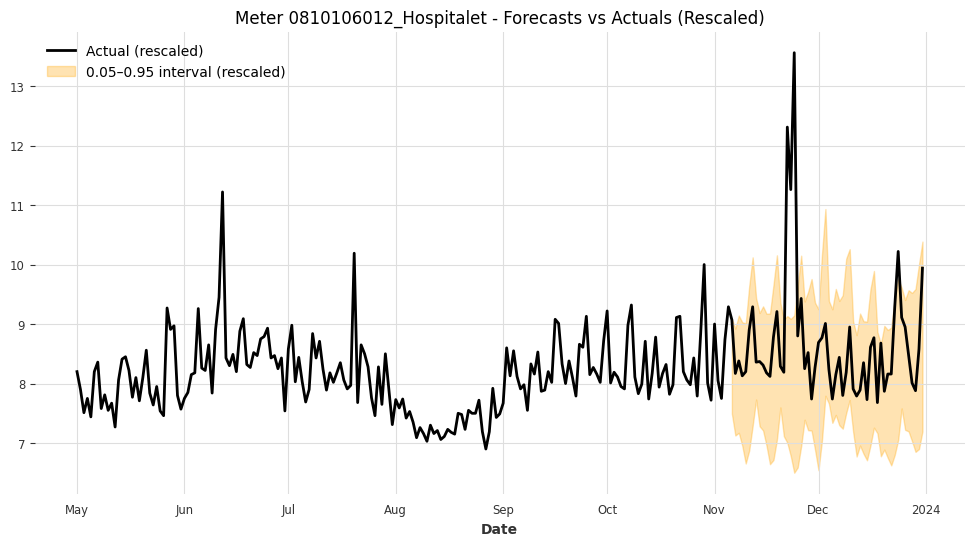

Meter 0810106012_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.3550



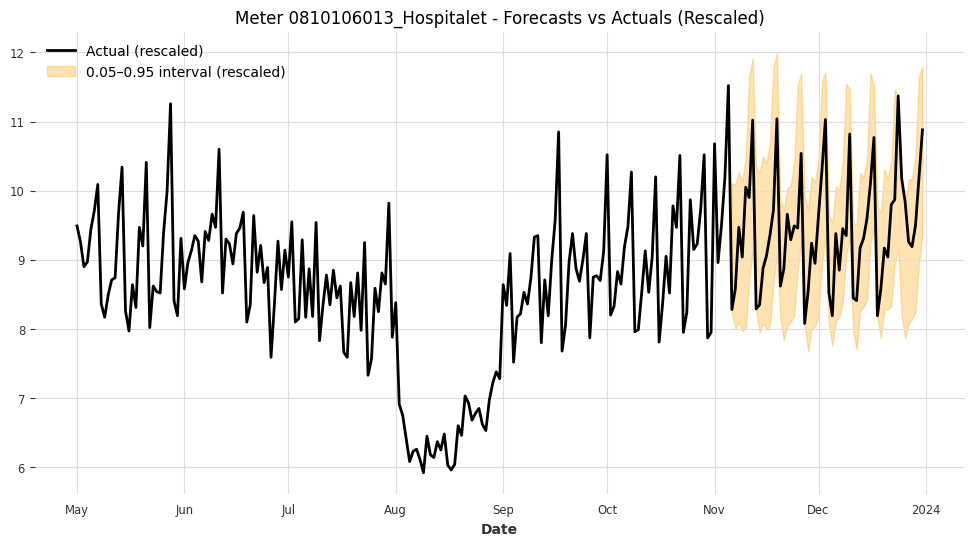

Meter 0810106013_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 2.1763



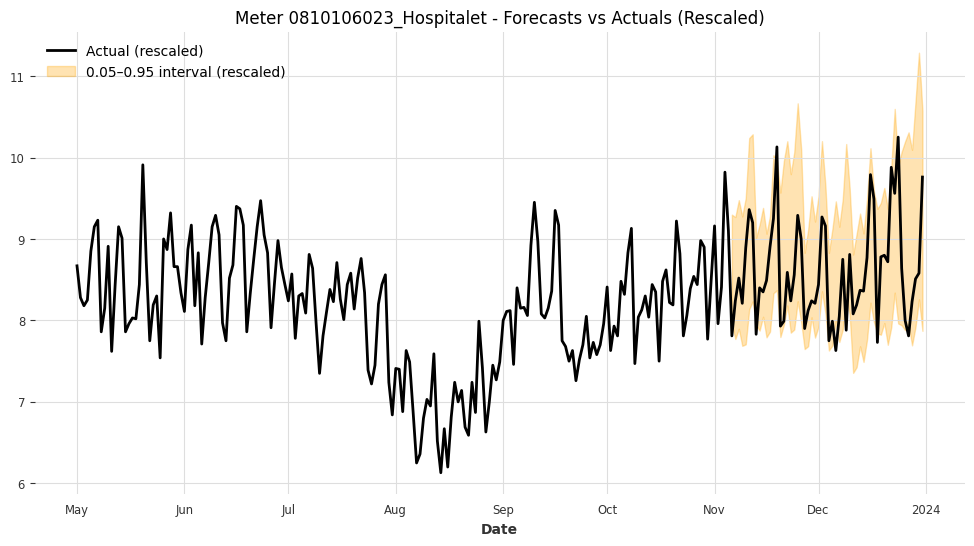

Meter 0810106023_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 1.7671



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")


In [ ]:
# Let's check with the selected test set (minmax scaled)

In [ ]:
model = BlockRNNModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/blockRNN/simple/blockRNN_model.pkl")
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')
print(test_data.keys())

# We extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# Loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])

    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": mean_width})
    print(f"\nResults for meter {meter_id}:\n", df_results)

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801902043_Barcelona:
    Interval  Coverage     Width
0       0.9     0.875  2.141527


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903008_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  2.960387


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903021_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  1.246487


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903026_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  1.992871


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903035_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  0.708741


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903037_Barcelona:
    Interval  Coverage     Width
0       0.9  0.857143  1.673072


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801903213_Barcelona:
    Interval  Coverage     Width
0       0.9  0.928571  0.448962


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904027_Barcelona:
    Interval  Coverage     Width
0       0.9  0.892857  3.594013


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904047_Barcelona:
    Interval  Coverage     Width
0       0.9  0.964286  4.238398


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801904049_Barcelona:
    Interval  Coverage     Width
0       0.9  0.732143  3.128062


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801905057_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  3.422268


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801906071_Barcelona:
    Interval  Coverage     Width
0       0.9  0.821429  1.339471


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0801910007_Barcelona:
    Interval  Coverage     Width
0       0.9  0.910714  1.014893


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0807302003_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  5.021628


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0807710008_Hospitalet:
    Interval  Coverage      Width
0       0.9  0.821429  71.554331


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101004_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  8.073057


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  3.104797


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101018_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.964286  1.40296


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101019_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  1.861189


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101024_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.767857  3.121753


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101029_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  6.511395


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.785714  5.068077


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810101039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  3.903236


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810101040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  6.507552


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102005_Hospitalet:


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


    Interval  Coverage     Width
0       0.9     0.875  2.744293


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.678571  6.308612


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  4.274024


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102024_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  2.474623


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102034_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  7.206745


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102038_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  5.666066


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810102039_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  6.042989


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102045_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  7.985508


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102048_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  5.375301


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810102049_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.857143  3.49589


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103002_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.785714  1.029301


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810103006_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.910714  5.62553


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.605704


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103012_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  0.454653


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103018_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.839286  1.929318


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810103022_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  3.071645


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  4.323028


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810104010_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.821429  2.412985


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104011_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.982143  4.054409


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0810104033_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  3.500623


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0810104035_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.857143  0.92513


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810104040_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.436856


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105001_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  0.886187


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810105007_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  5.742958


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810105018_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  2.571708


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106005_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.910714  2.013761


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106008_Hospitalet:
    Interval  Coverage     Width
0       0.9     0.875  1.652226


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106010_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.946429  1.290286


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs



Results for meter 0810106014_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.043643


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Results for meter 0810106016_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.928571  1.067603


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106019_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.892857  1.172815


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106021_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  1.842997


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106022_Hospitalet:
    Interval  Coverage    Width
0       0.9  0.839286  0.90914


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106023_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.857143  1.599102


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106026_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.964286  0.651774


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


Results for meter 0810106032_Hospitalet:
    Interval  Coverage     Width
0       0.9  0.803571  1.816756


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")

Mean Coverage: 0.8839
Mean Width: 4.2041


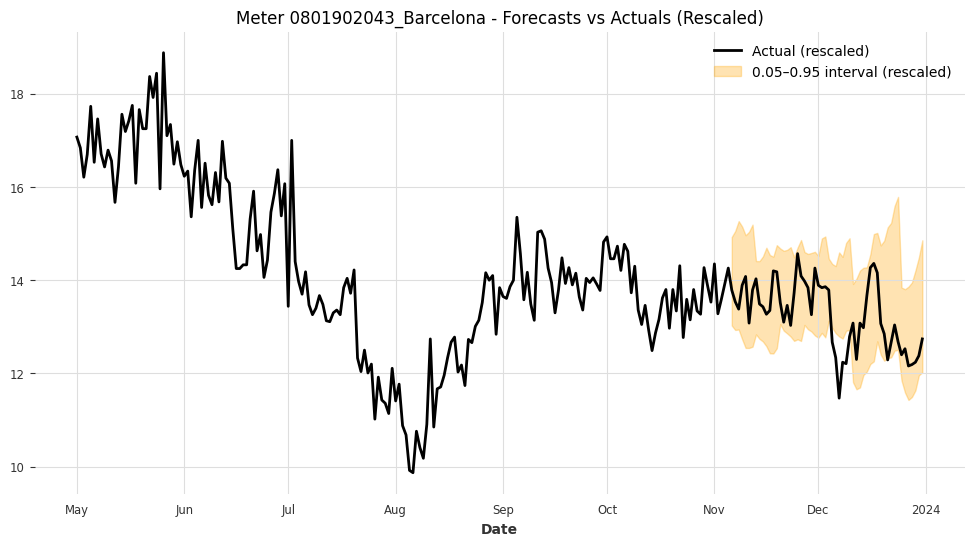

Meter 0801902043_Barcelona - Coverage: 0.8750, Mean Interval Width (rescaled): 2.1415



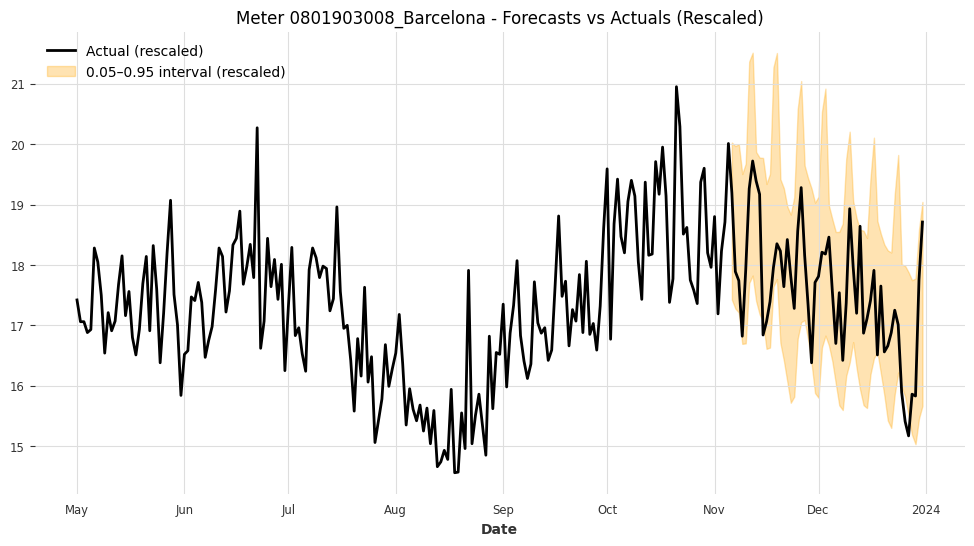

Meter 0801903008_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 2.9604



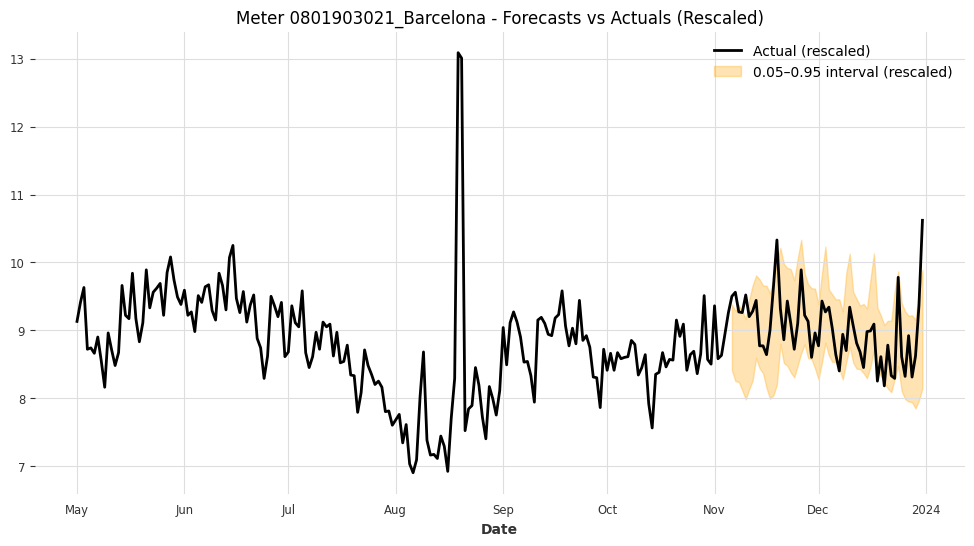

Meter 0801903021_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 1.2465



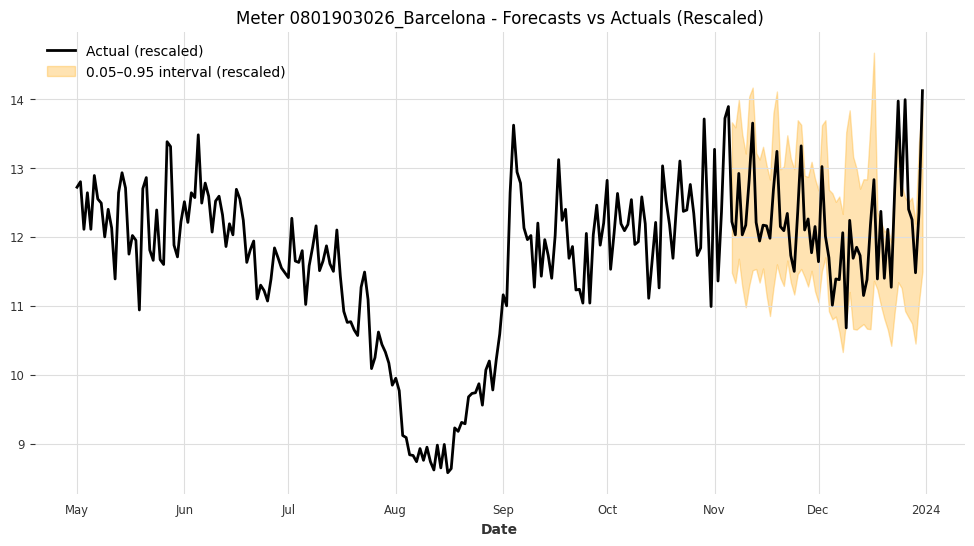

Meter 0801903026_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 1.9929



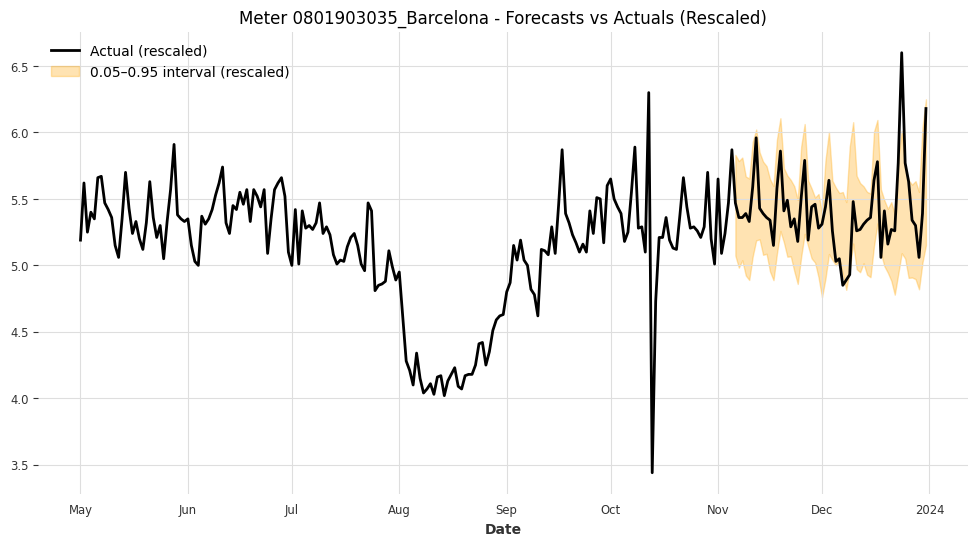

Meter 0801903035_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 0.7087



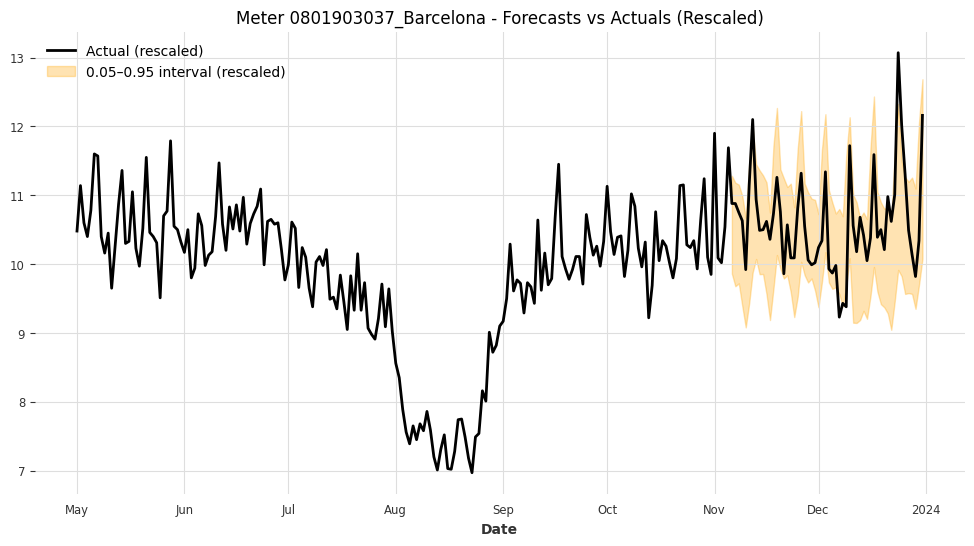

Meter 0801903037_Barcelona - Coverage: 0.8571, Mean Interval Width (rescaled): 1.6731



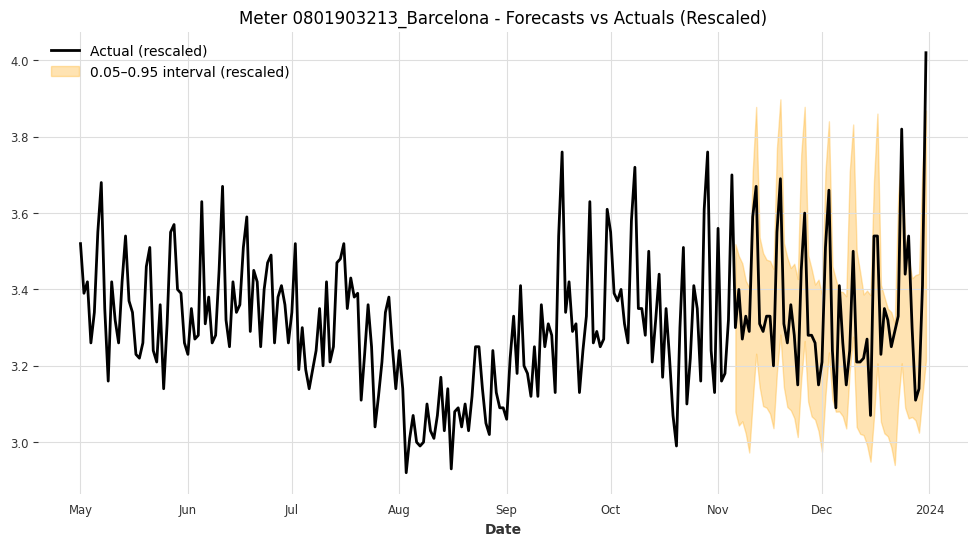

Meter 0801903213_Barcelona - Coverage: 0.9286, Mean Interval Width (rescaled): 0.4490



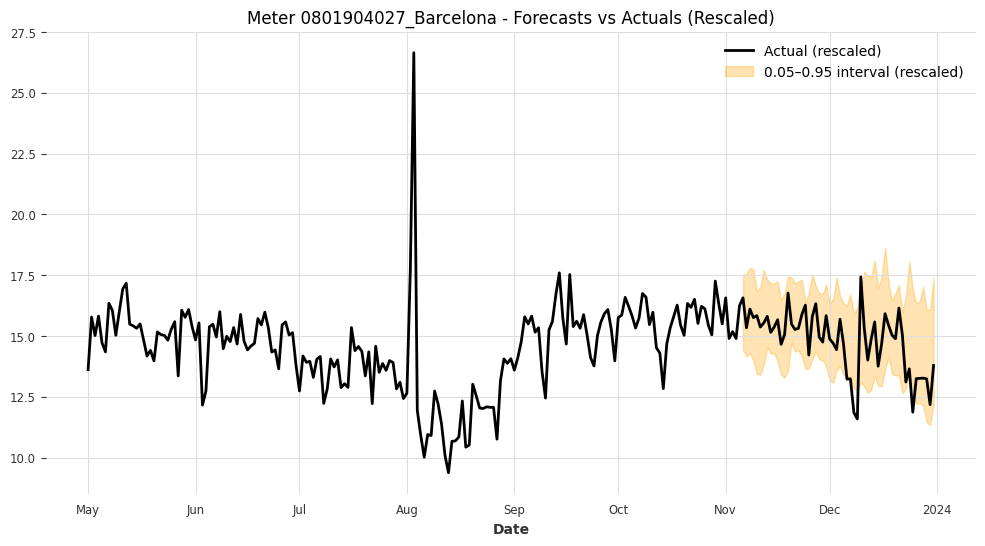

Meter 0801904027_Barcelona - Coverage: 0.8929, Mean Interval Width (rescaled): 3.5940



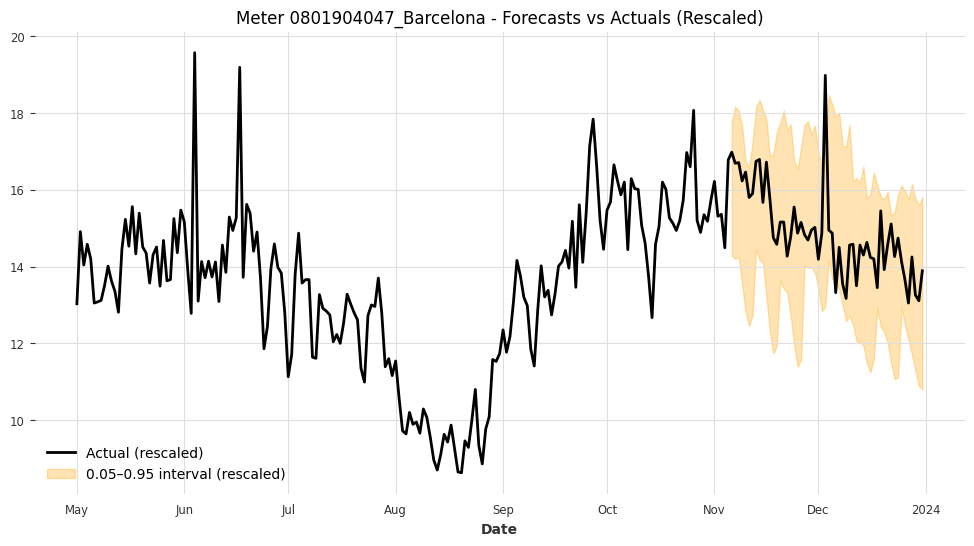

Meter 0801904047_Barcelona - Coverage: 0.9643, Mean Interval Width (rescaled): 4.2384



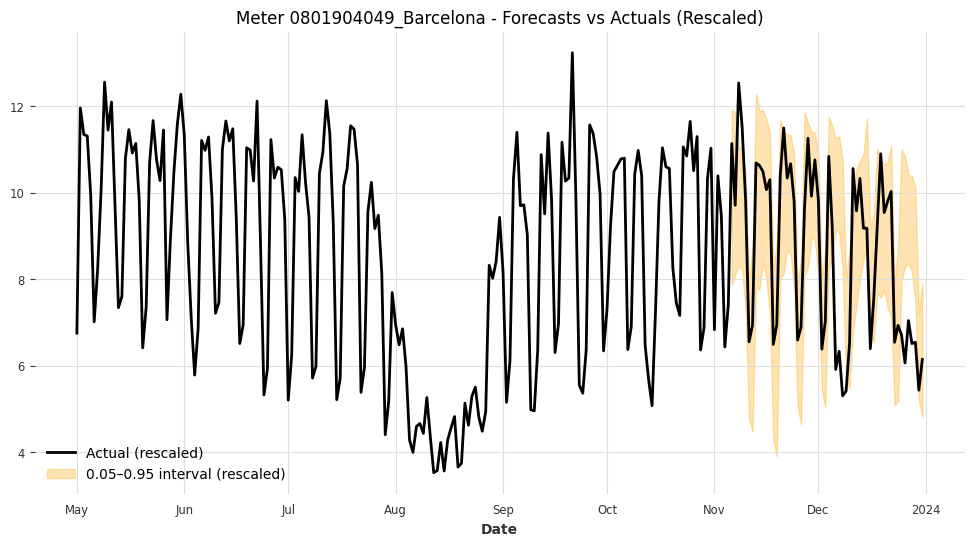

Meter 0801904049_Barcelona - Coverage: 0.7321, Mean Interval Width (rescaled): 3.1281



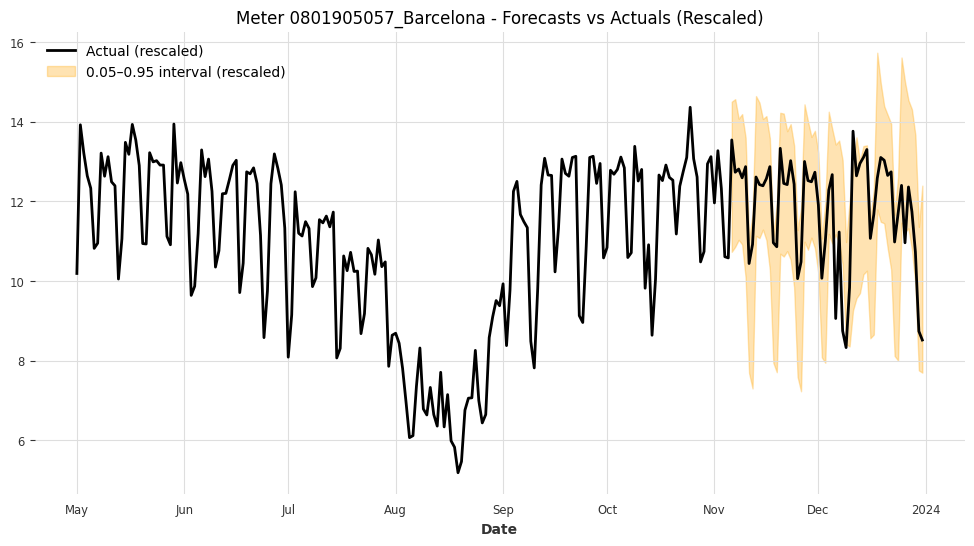

Meter 0801905057_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 3.4223



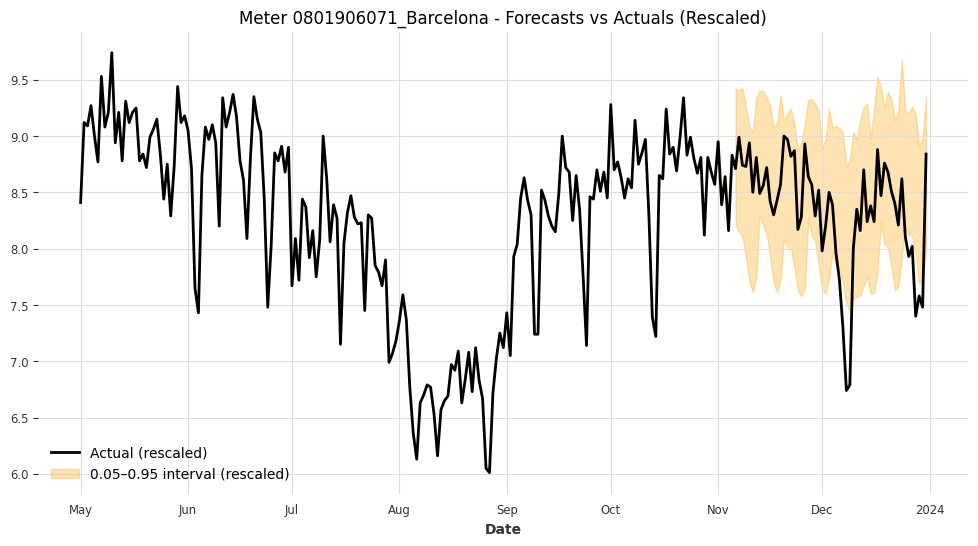

Meter 0801906071_Barcelona - Coverage: 0.8214, Mean Interval Width (rescaled): 1.3395



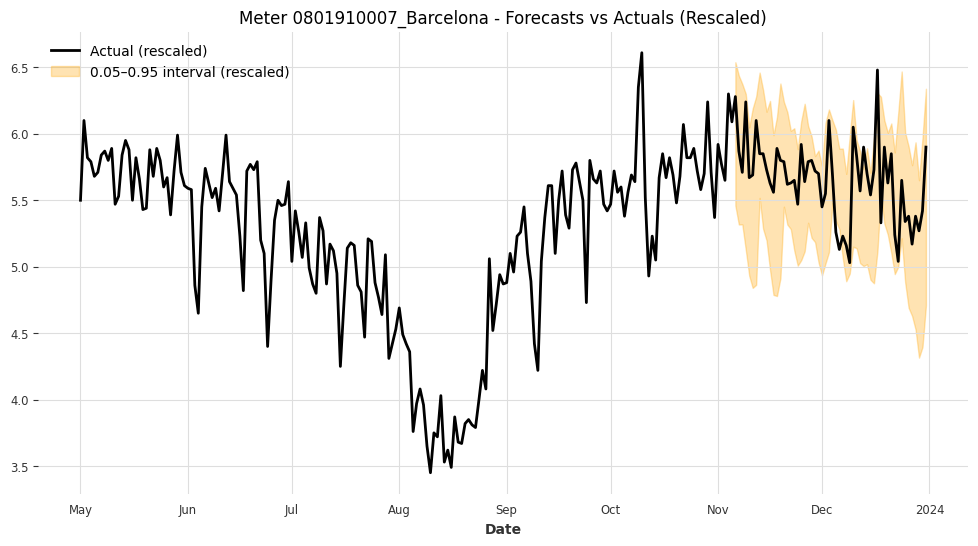

Meter 0801910007_Barcelona - Coverage: 0.9107, Mean Interval Width (rescaled): 1.0149



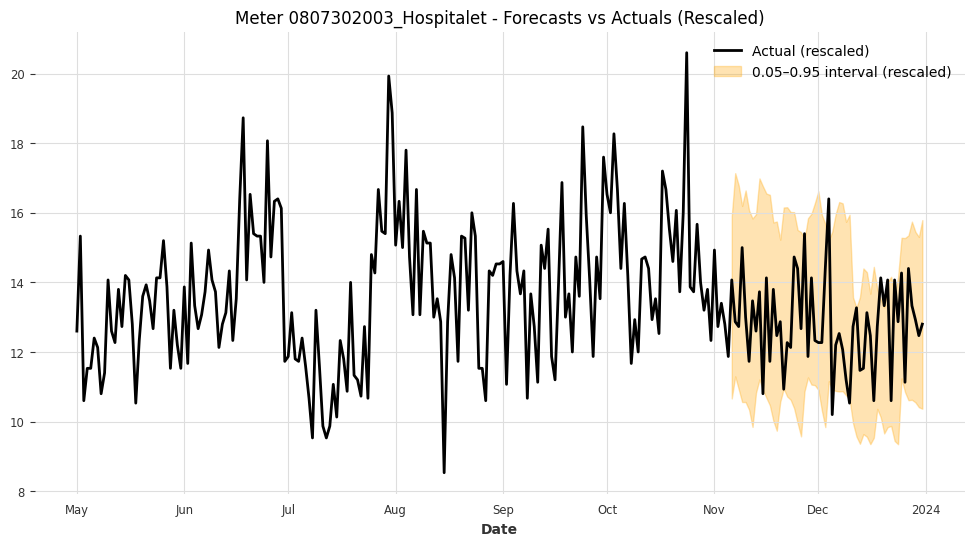

Meter 0807302003_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 5.0216



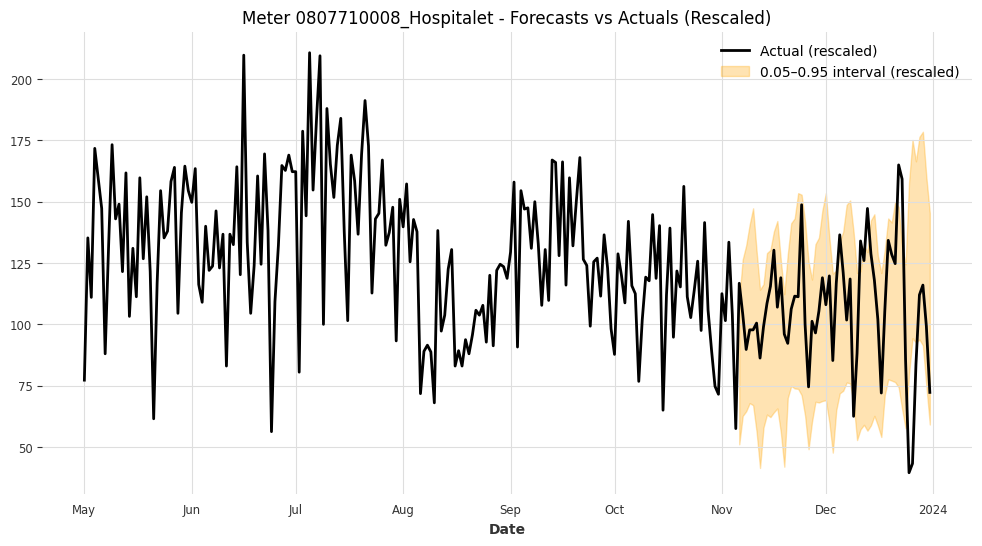

Meter 0807710008_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 71.5543



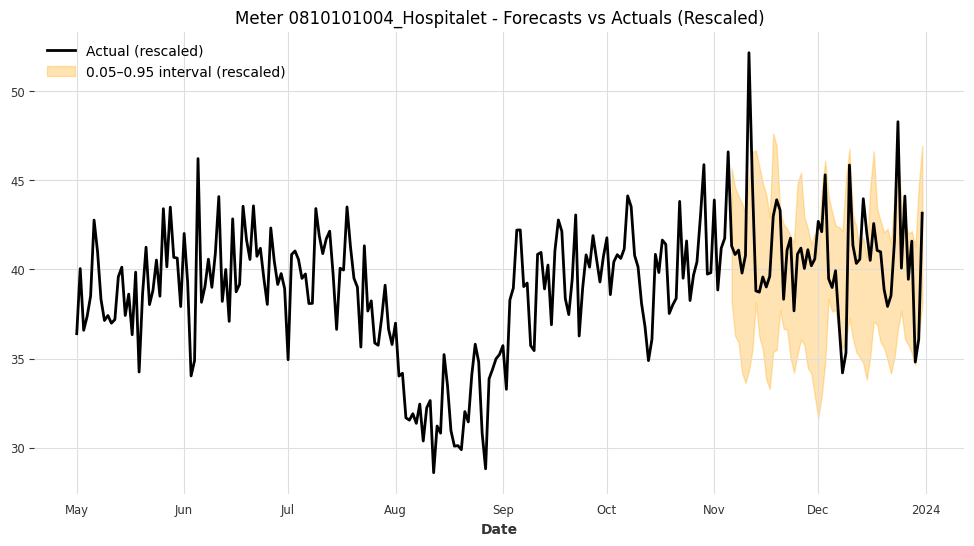

Meter 0810101004_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 8.0731



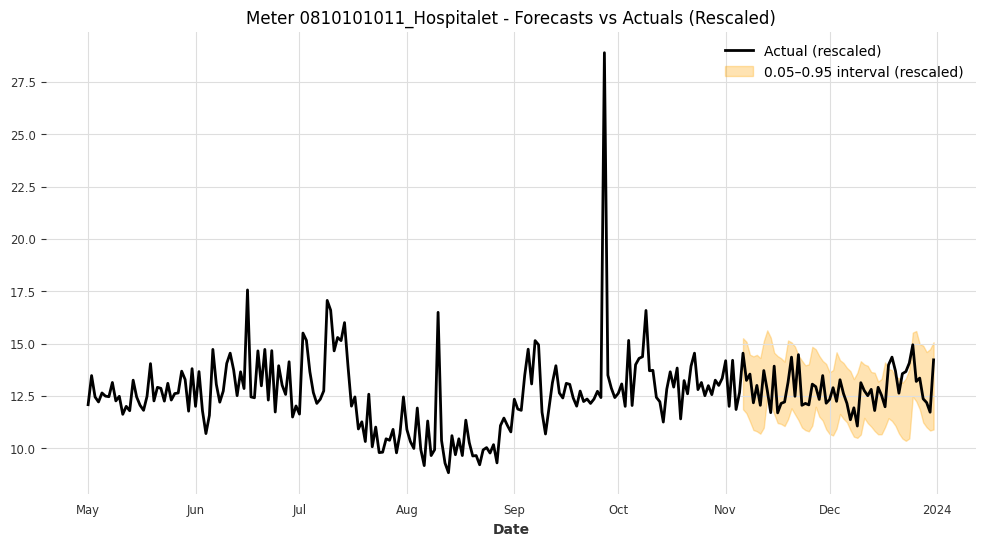

Meter 0810101011_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 3.1048



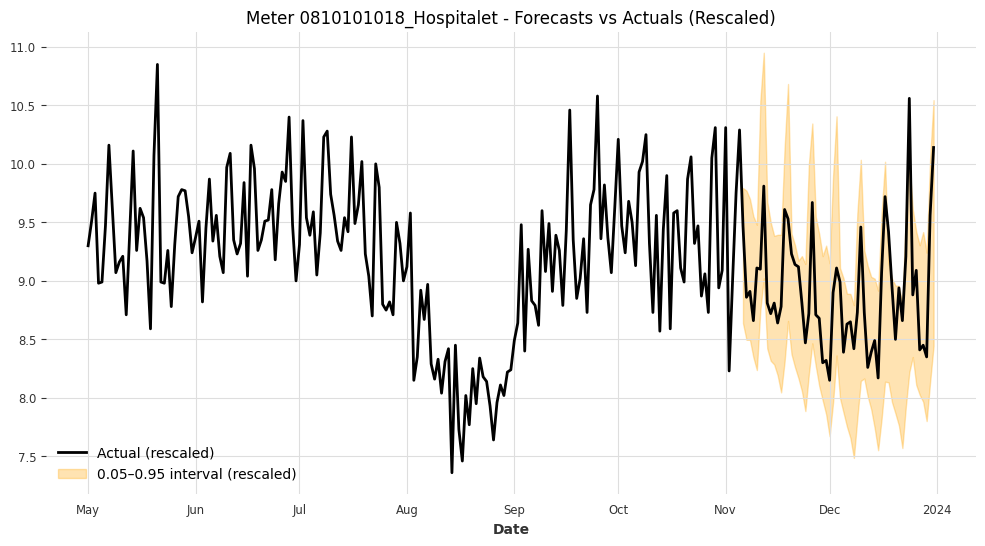

Meter 0810101018_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 1.4030



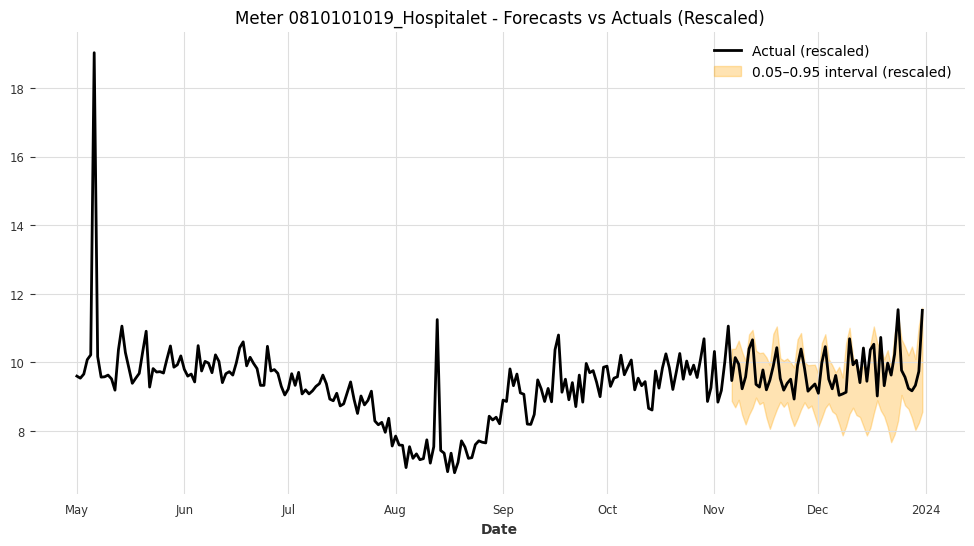

Meter 0810101019_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.8612



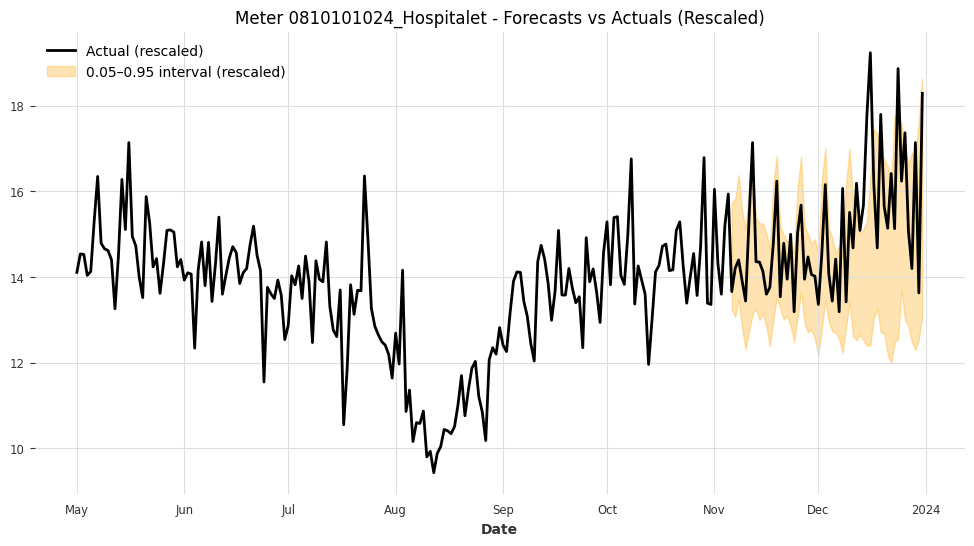

Meter 0810101024_Hospitalet - Coverage: 0.7679, Mean Interval Width (rescaled): 3.1218



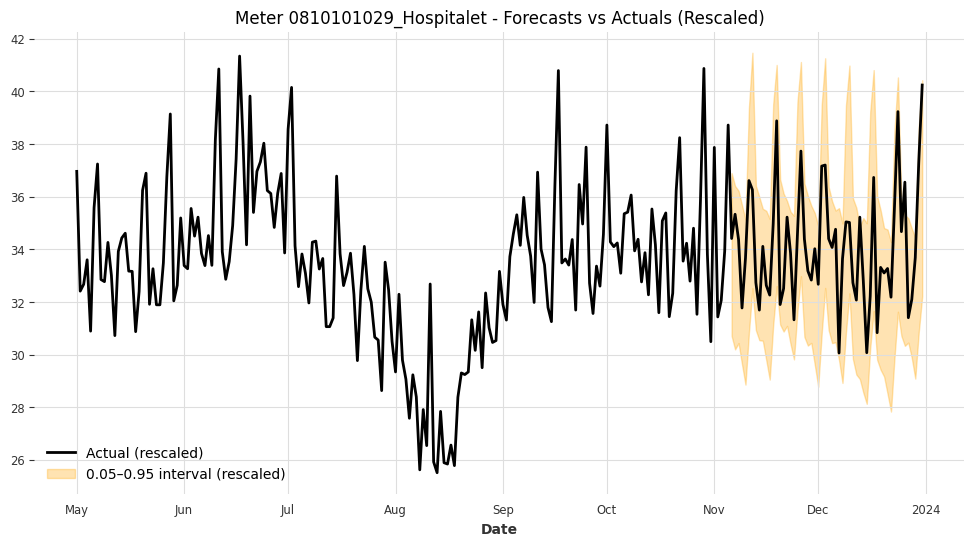

Meter 0810101029_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 6.5114



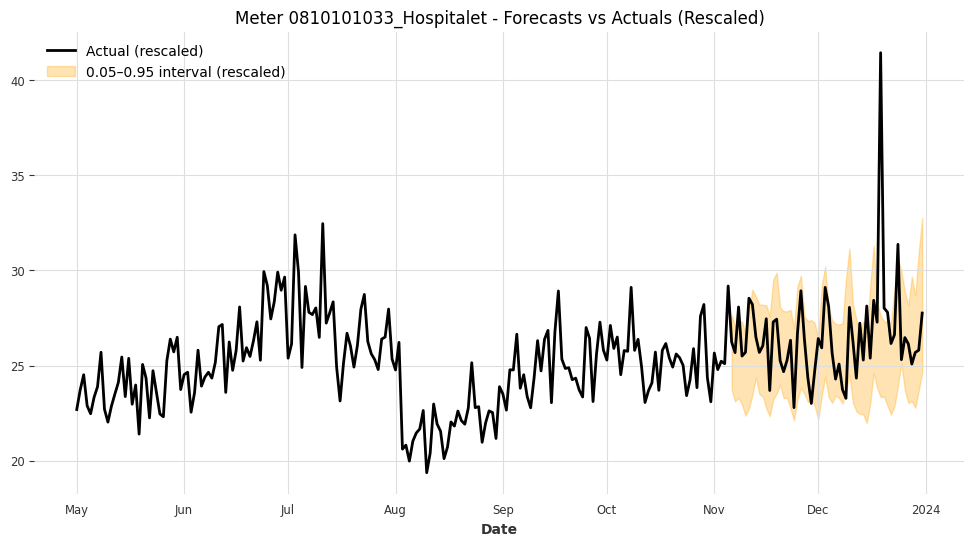

Meter 0810101033_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 5.0681



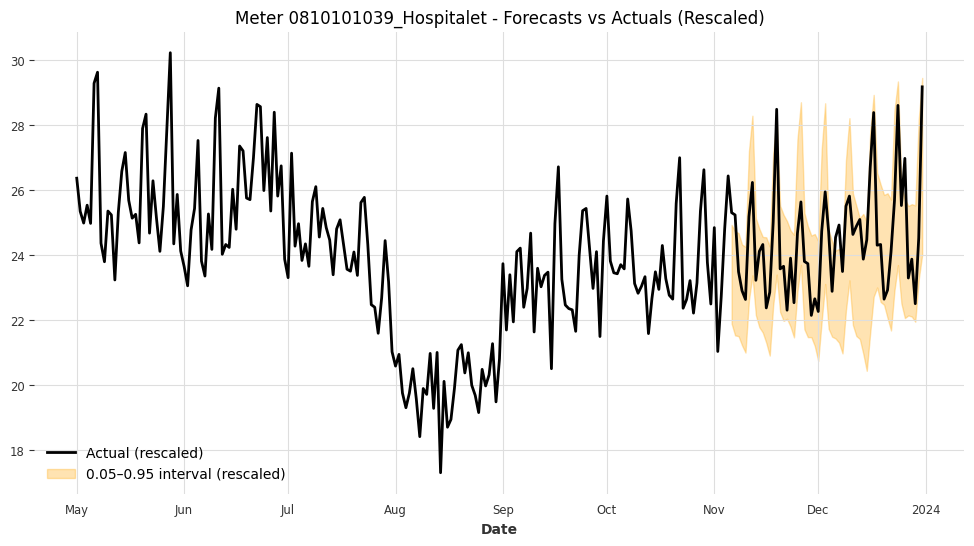

Meter 0810101039_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 3.9032



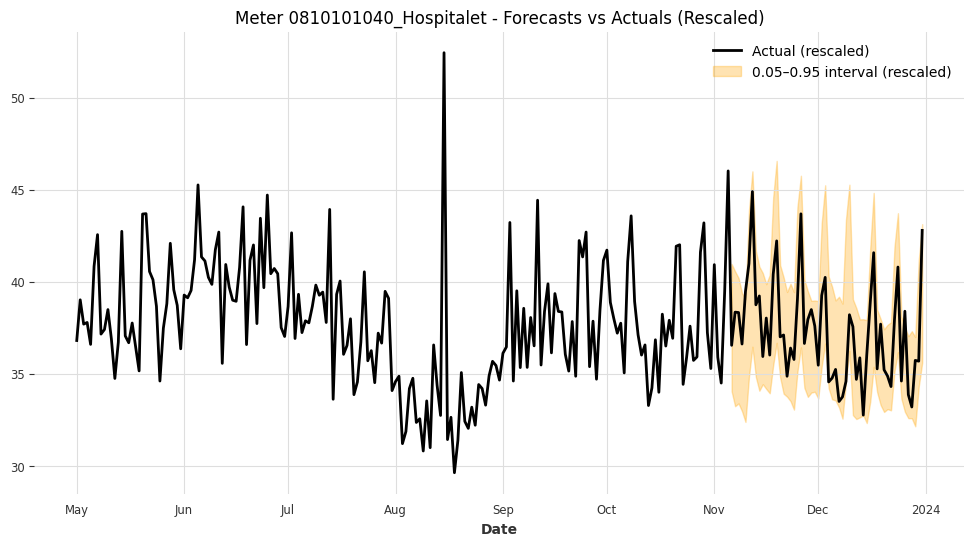

Meter 0810101040_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 6.5076



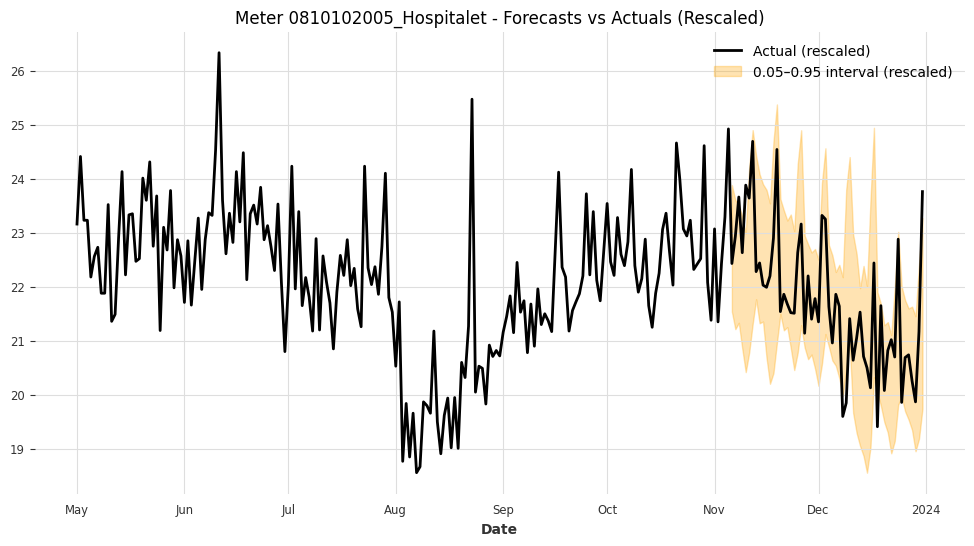

Meter 0810102005_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.7443



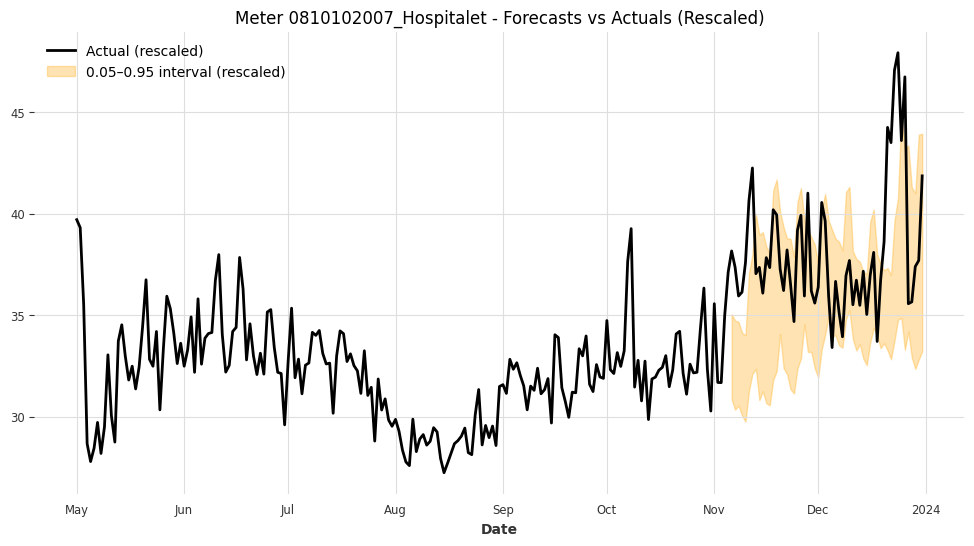

Meter 0810102007_Hospitalet - Coverage: 0.6786, Mean Interval Width (rescaled): 6.3086



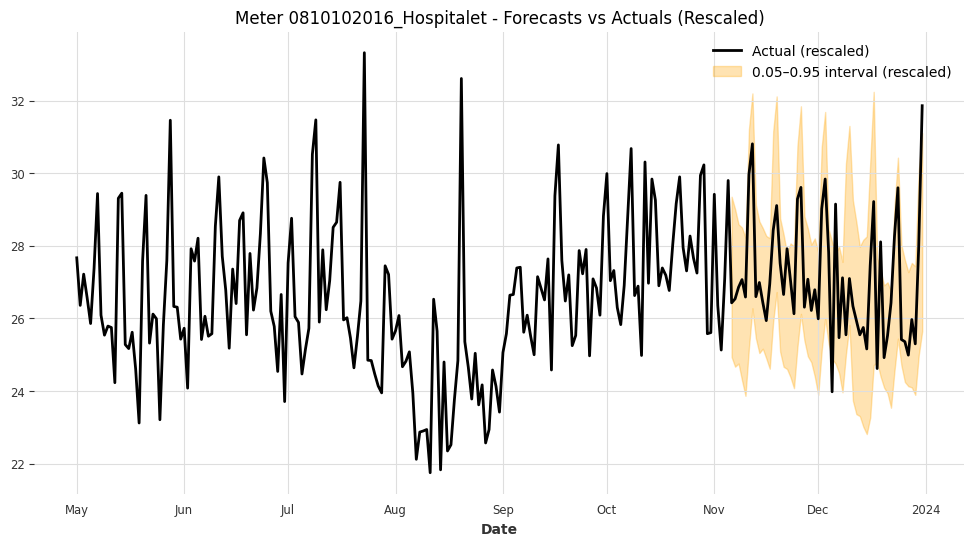

Meter 0810102016_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 4.2740



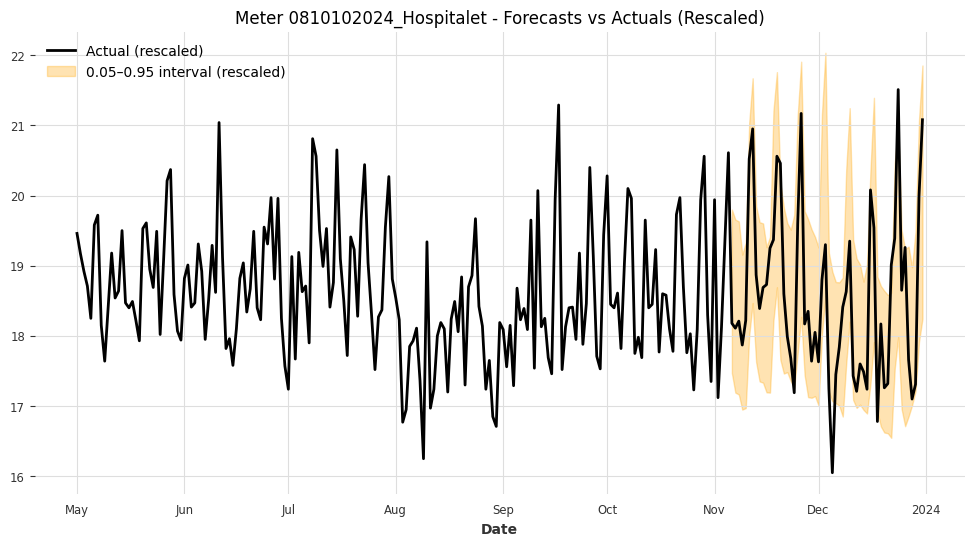

Meter 0810102024_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.4746



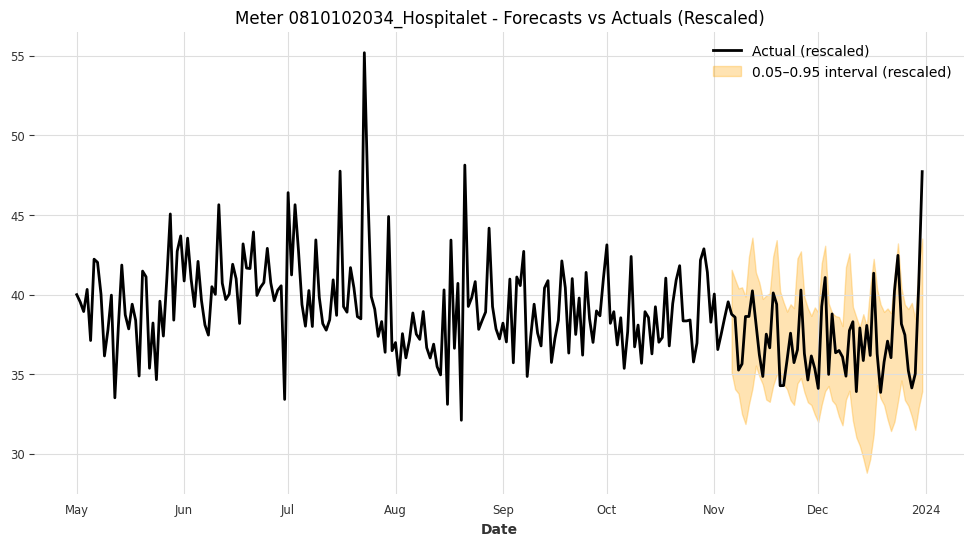

Meter 0810102034_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 7.2067



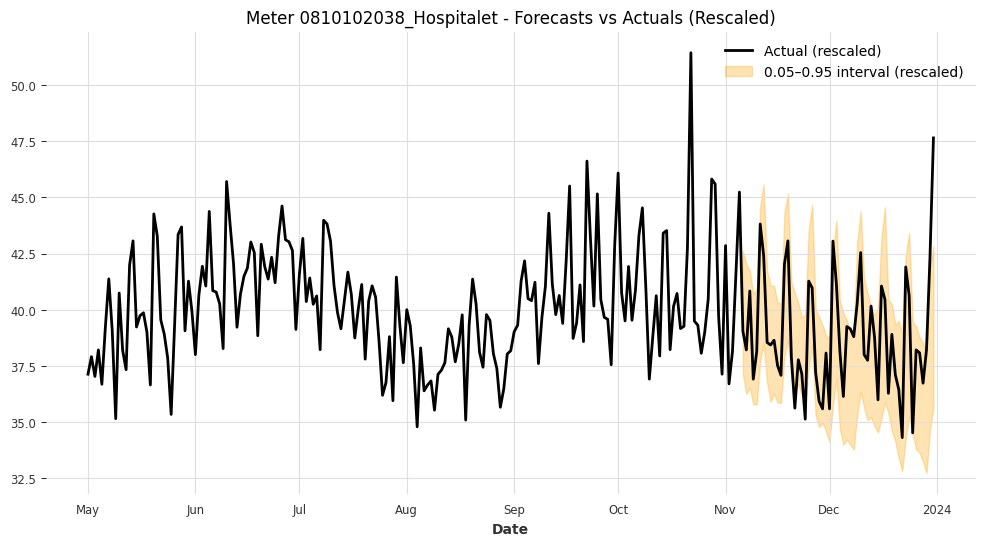

Meter 0810102038_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 5.6661



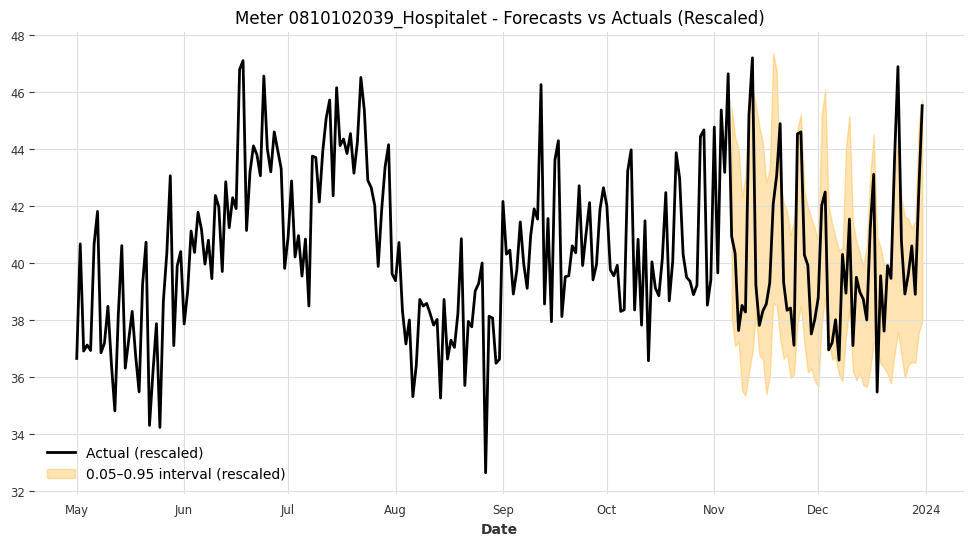

Meter 0810102039_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 6.0430



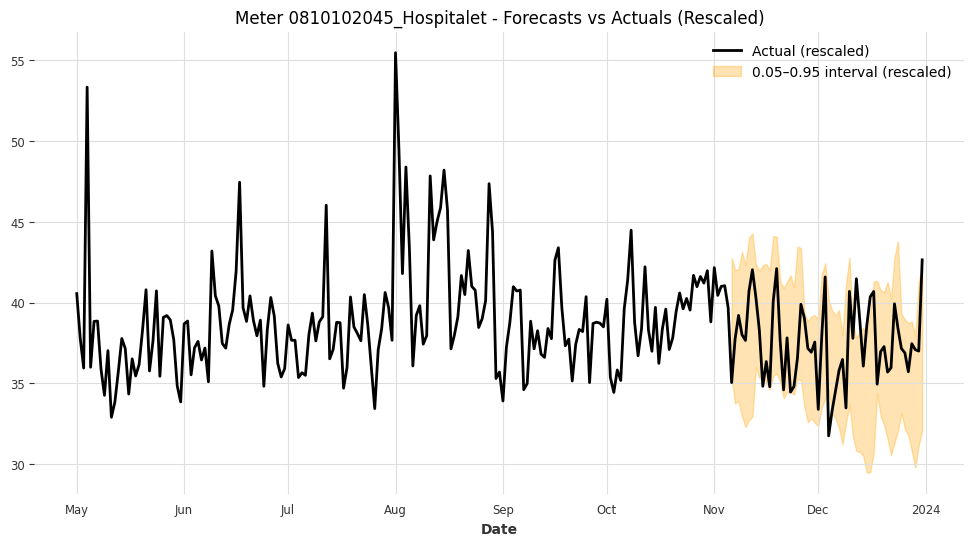

Meter 0810102045_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 7.9855



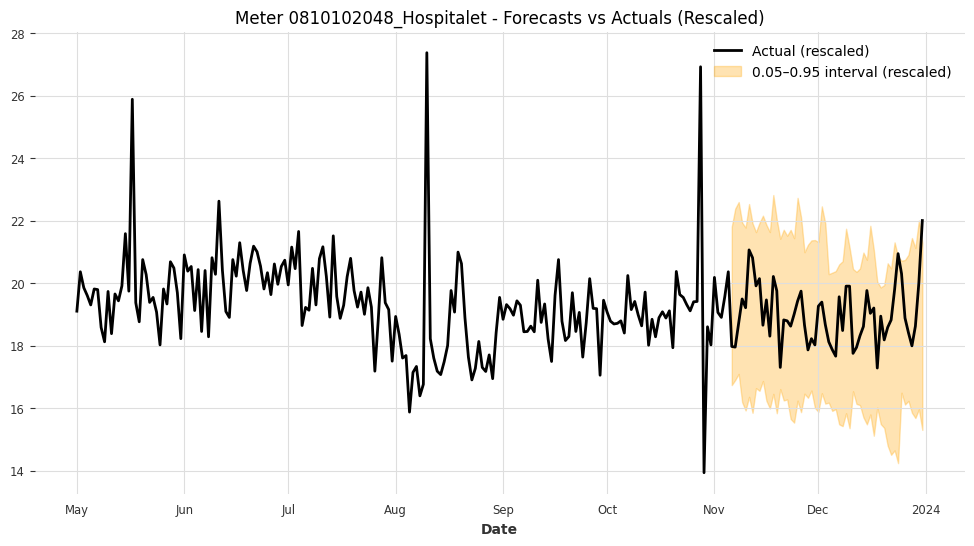

Meter 0810102048_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 5.3753



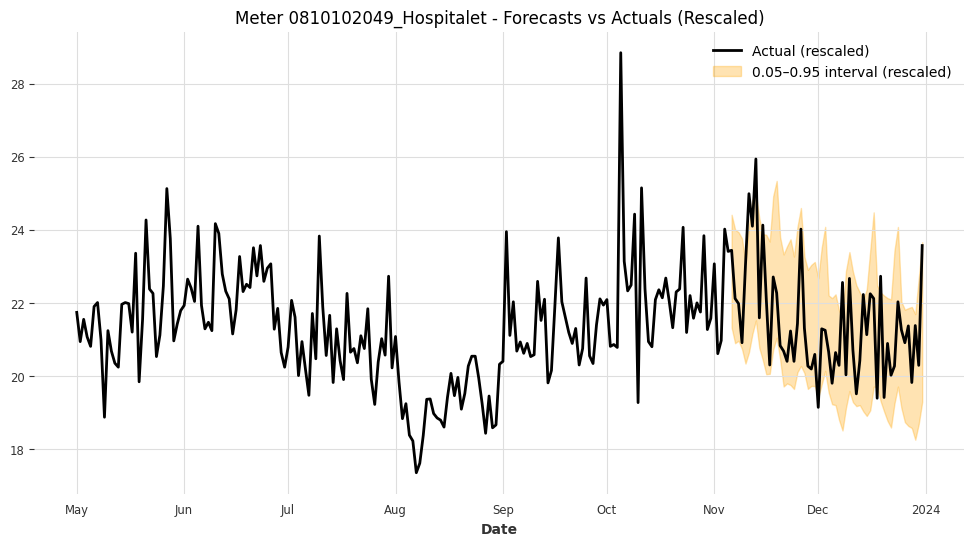

Meter 0810102049_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 3.4959



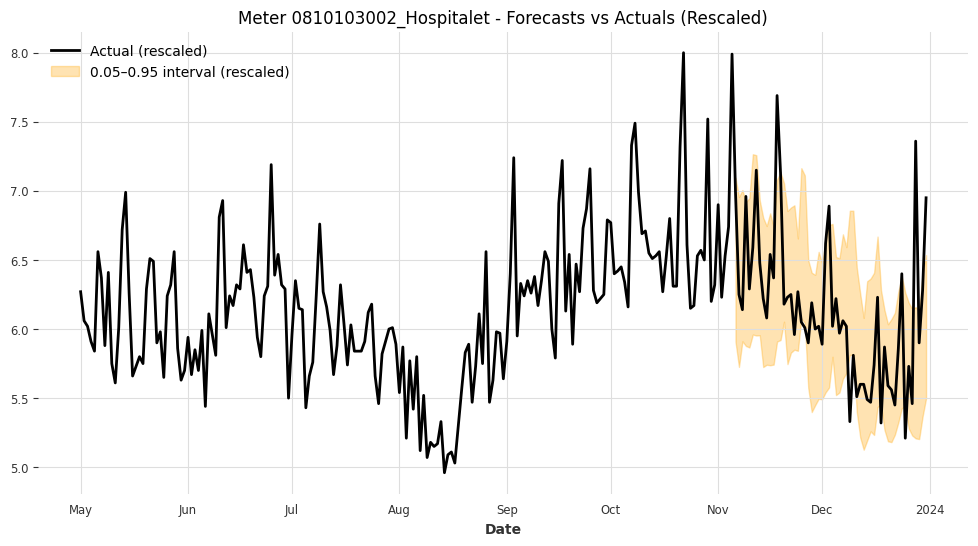

Meter 0810103002_Hospitalet - Coverage: 0.7857, Mean Interval Width (rescaled): 1.0293



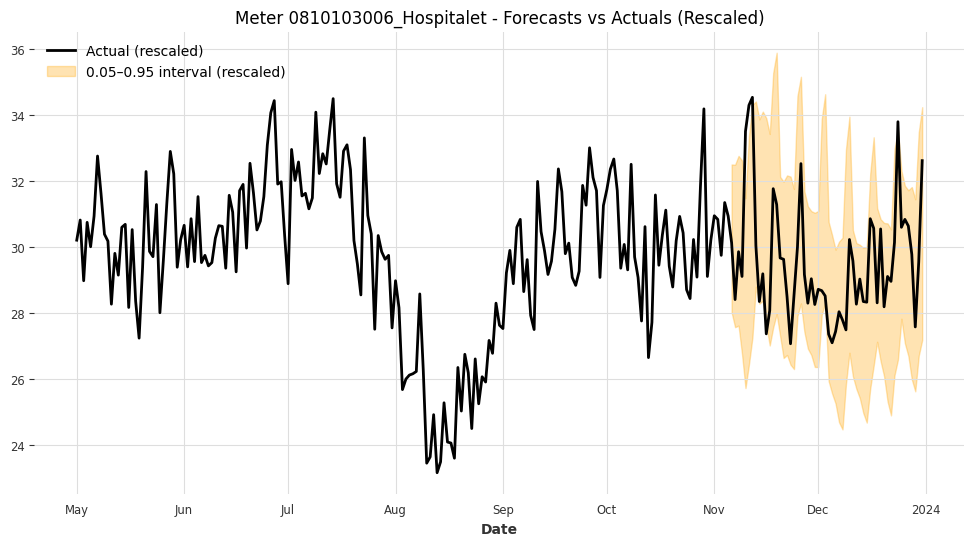

Meter 0810103006_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 5.6255



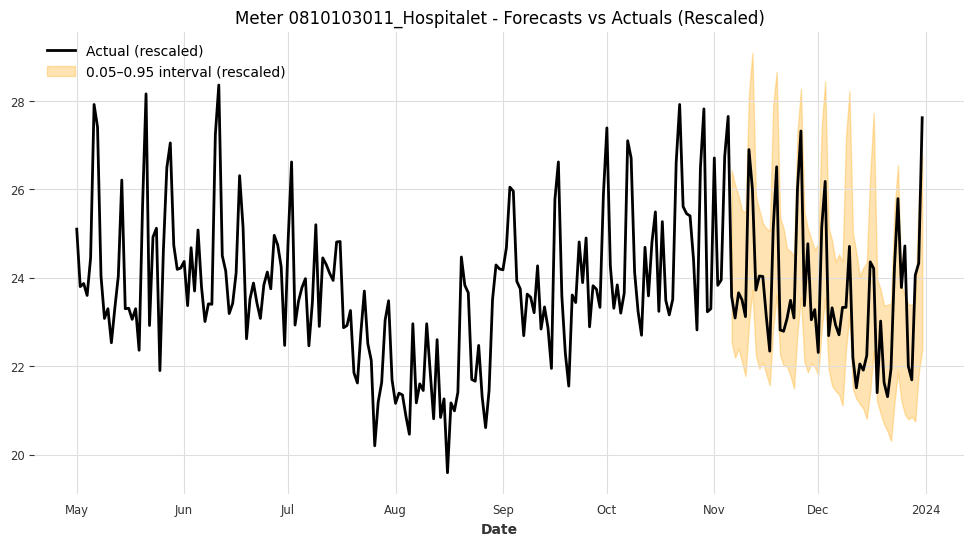

Meter 0810103011_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.6057



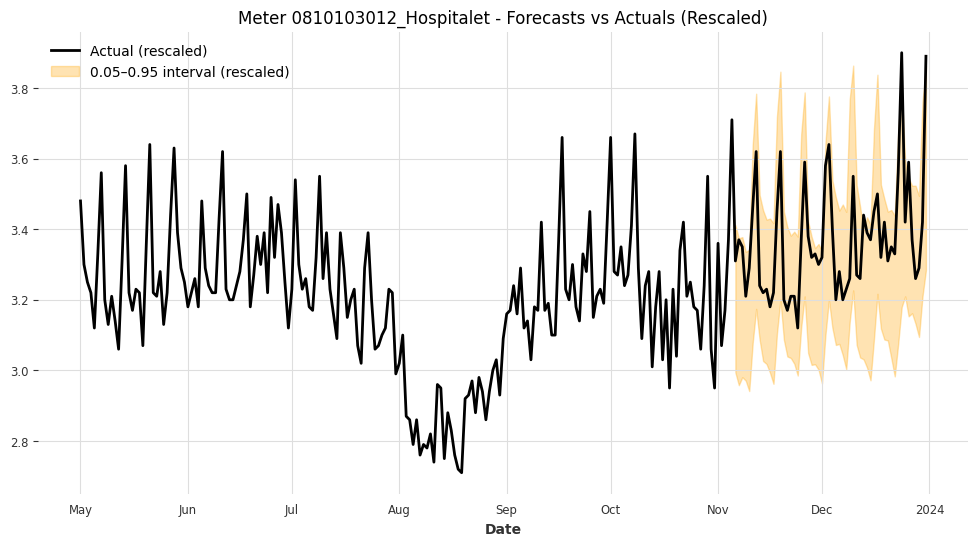

Meter 0810103012_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 0.4547



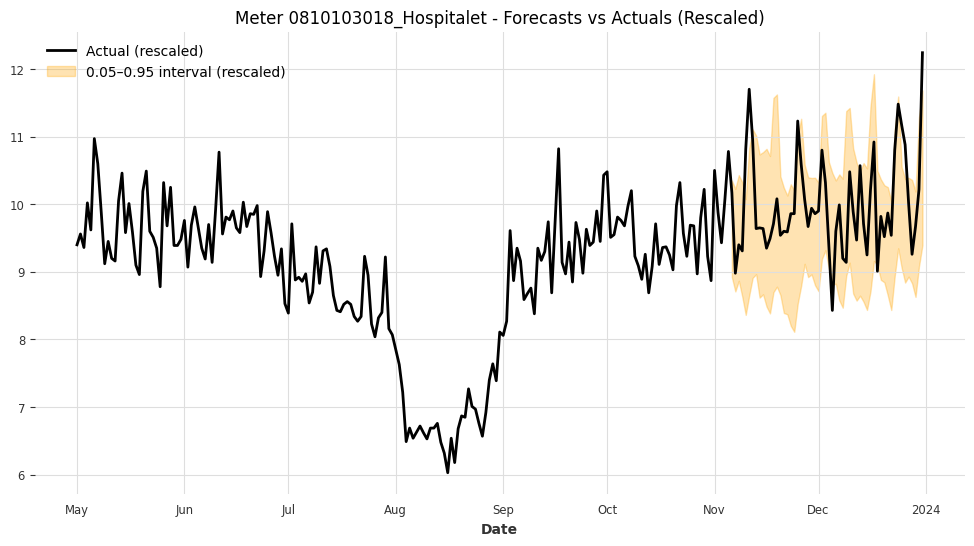

Meter 0810103018_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 1.9293



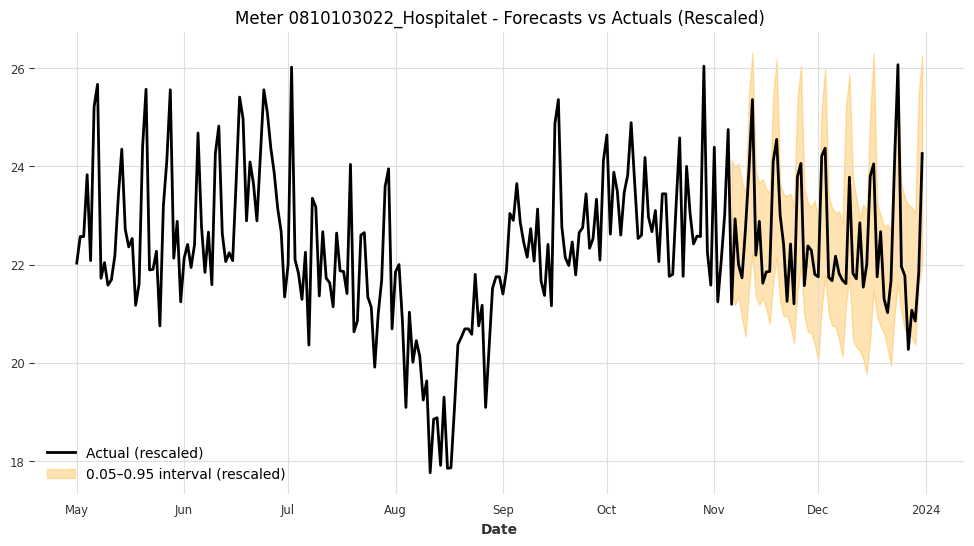

Meter 0810103022_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 3.0716



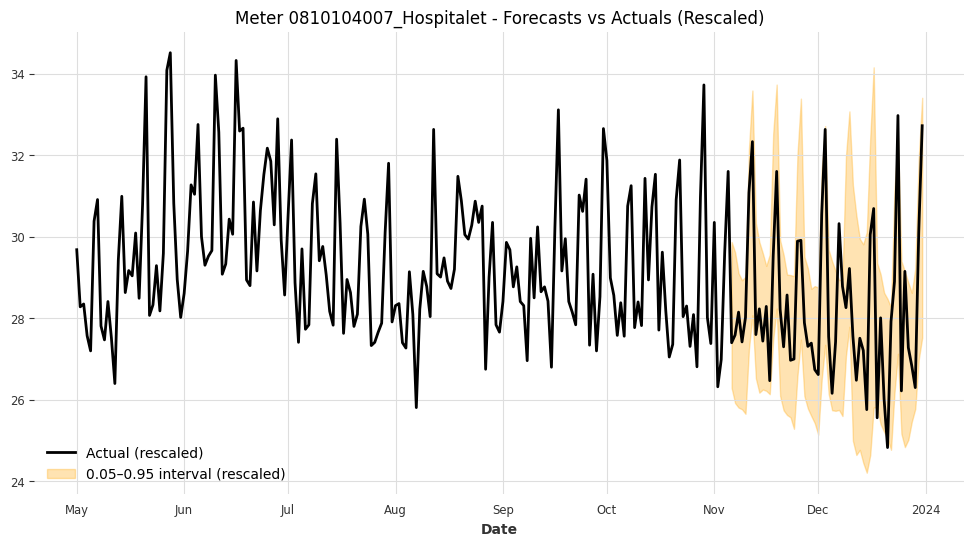

Meter 0810104007_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 4.3230



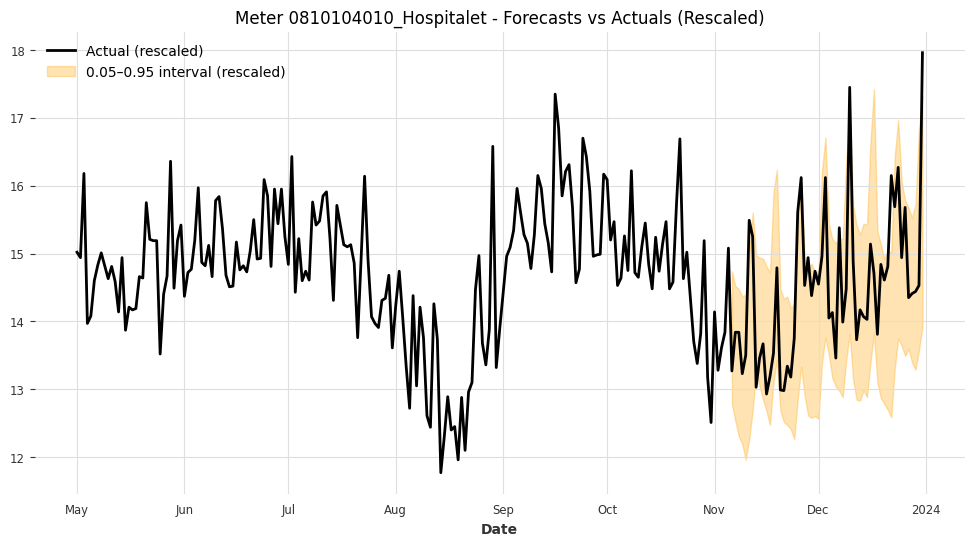

Meter 0810104010_Hospitalet - Coverage: 0.8214, Mean Interval Width (rescaled): 2.4130



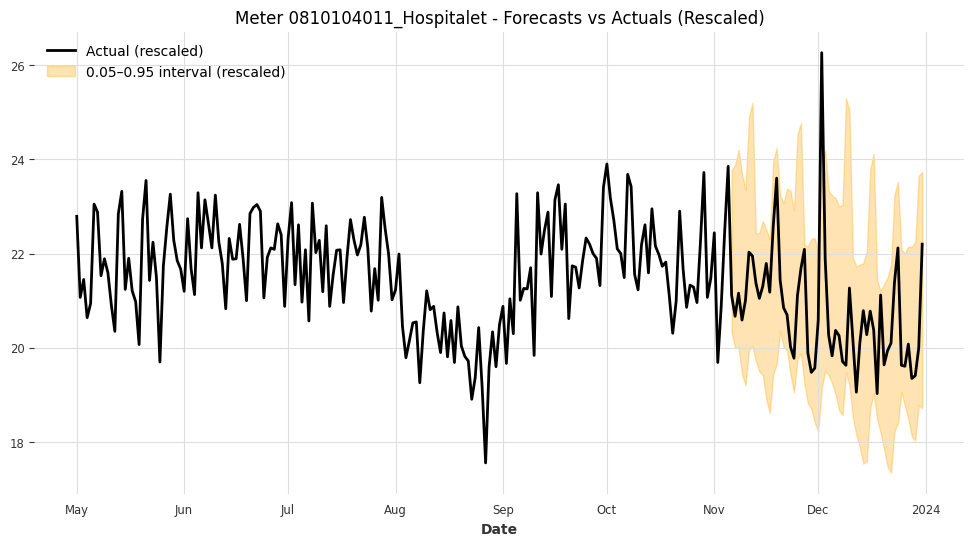

Meter 0810104011_Hospitalet - Coverage: 0.9821, Mean Interval Width (rescaled): 4.0544



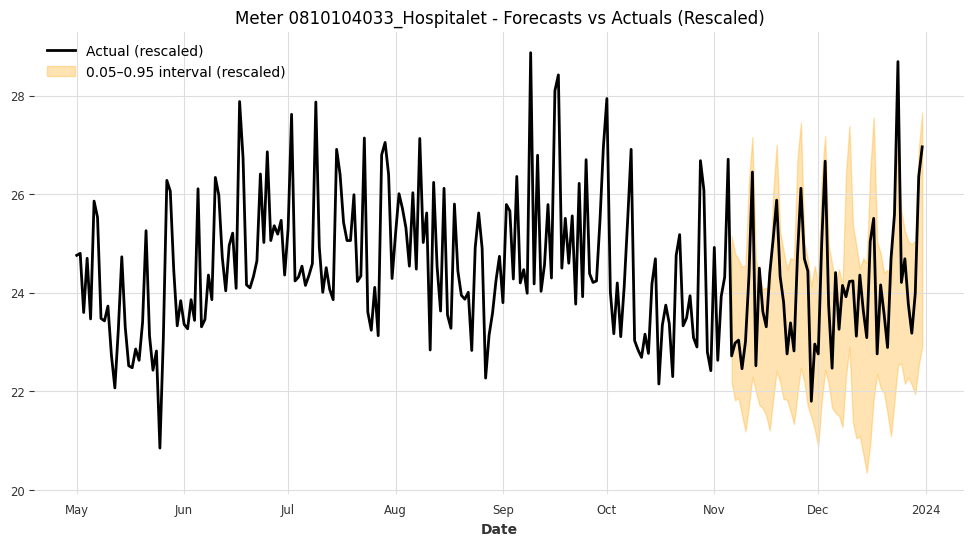

Meter 0810104033_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 3.5006



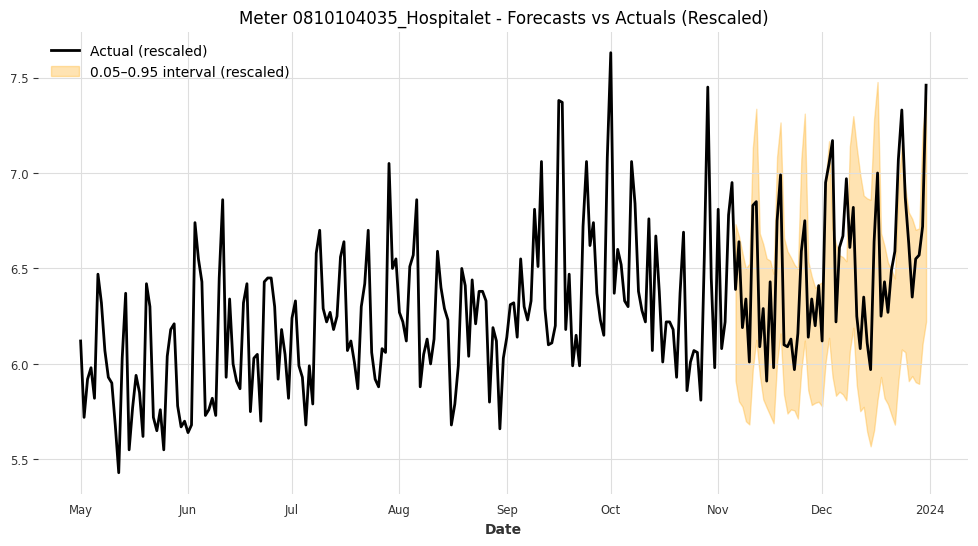

Meter 0810104035_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 0.9251



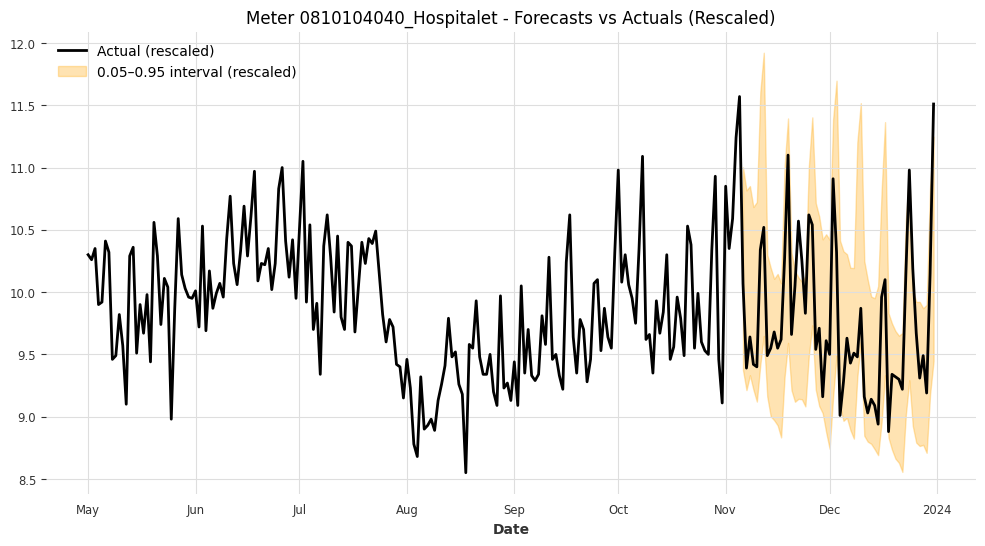

Meter 0810104040_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.4369



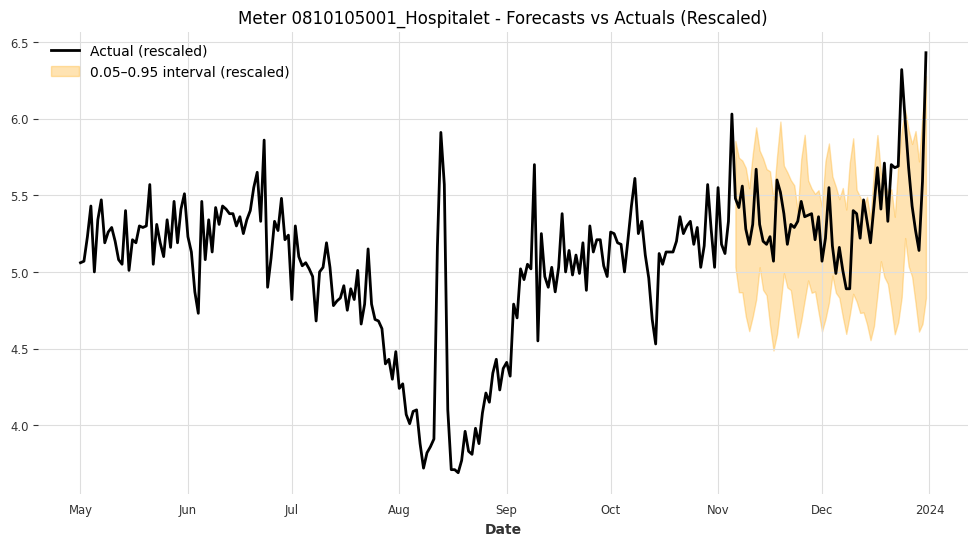

Meter 0810105001_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 0.8862



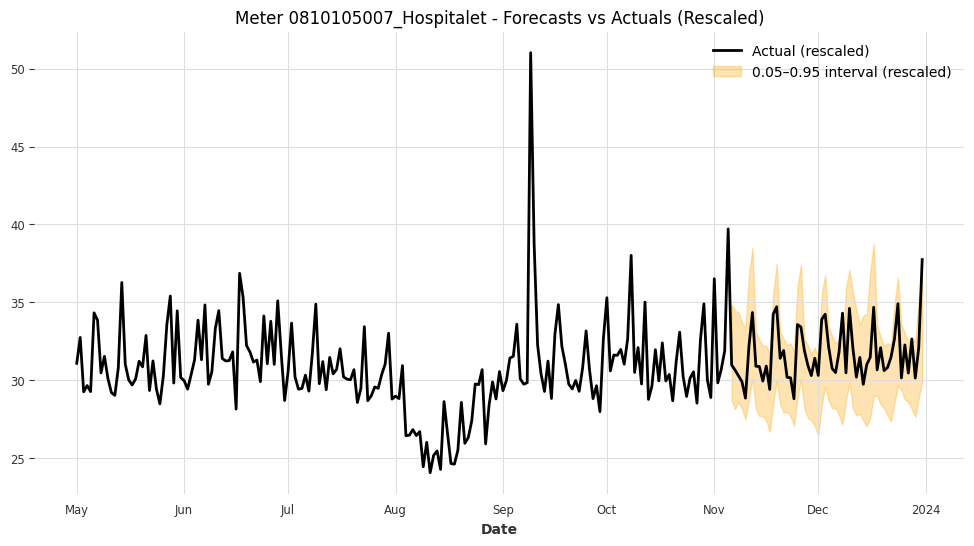

Meter 0810105007_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 5.7430



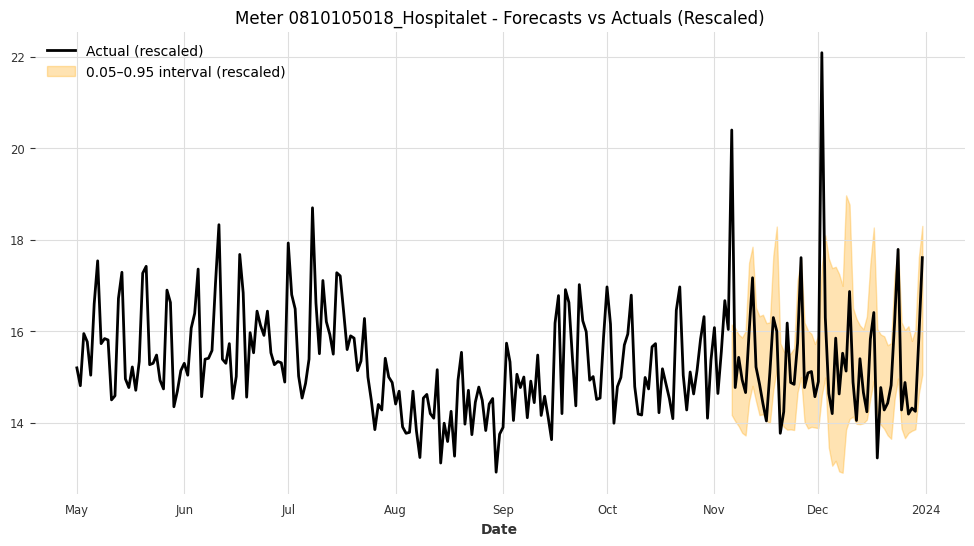

Meter 0810105018_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 2.5717



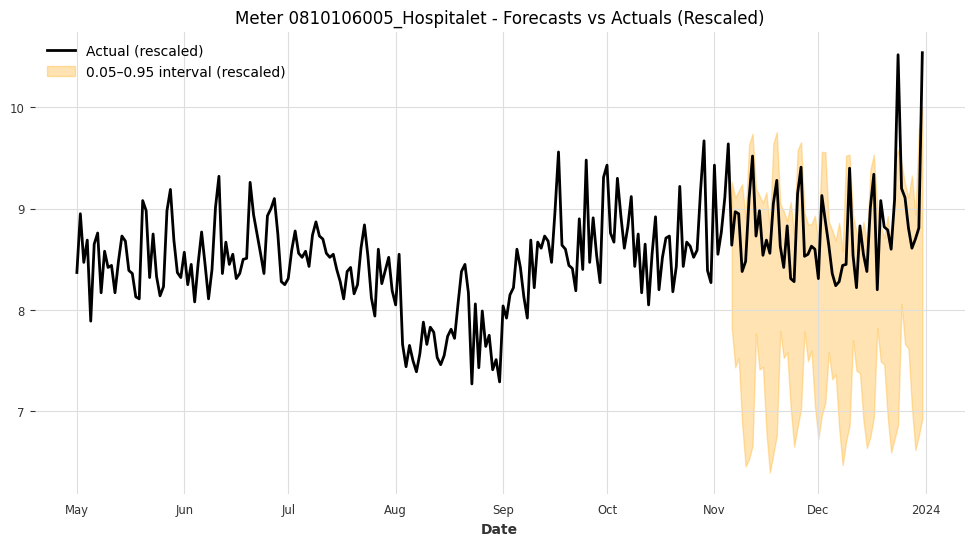

Meter 0810106005_Hospitalet - Coverage: 0.9107, Mean Interval Width (rescaled): 2.0138



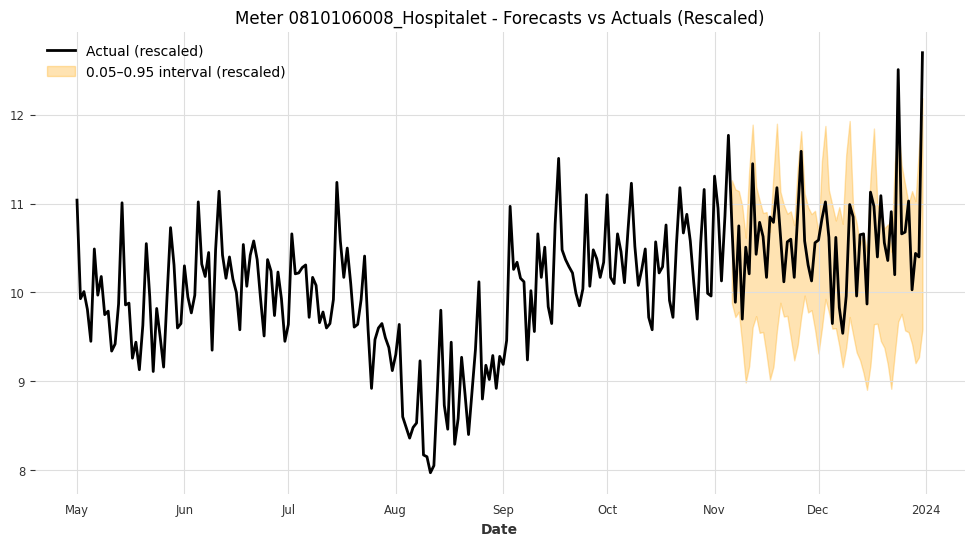

Meter 0810106008_Hospitalet - Coverage: 0.8750, Mean Interval Width (rescaled): 1.6522



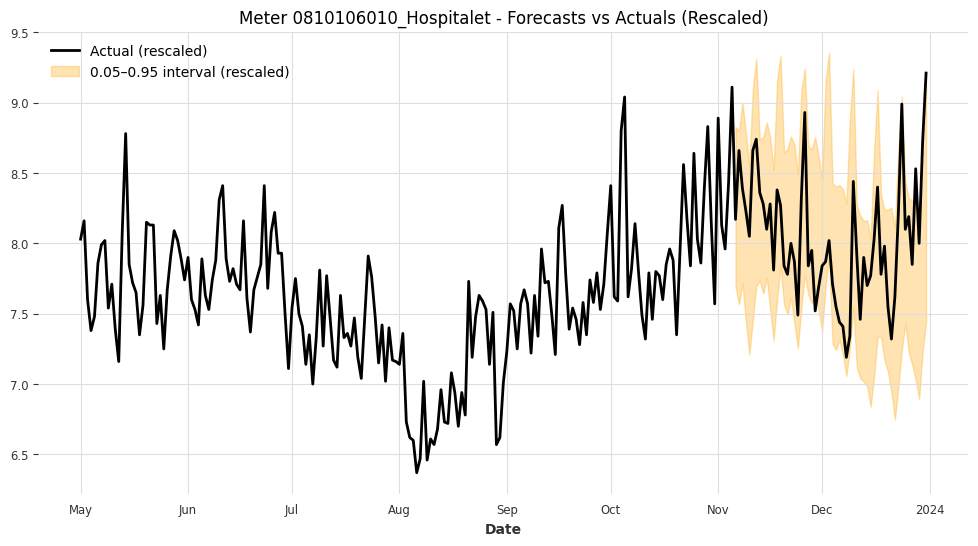

Meter 0810106010_Hospitalet - Coverage: 0.9464, Mean Interval Width (rescaled): 1.2903



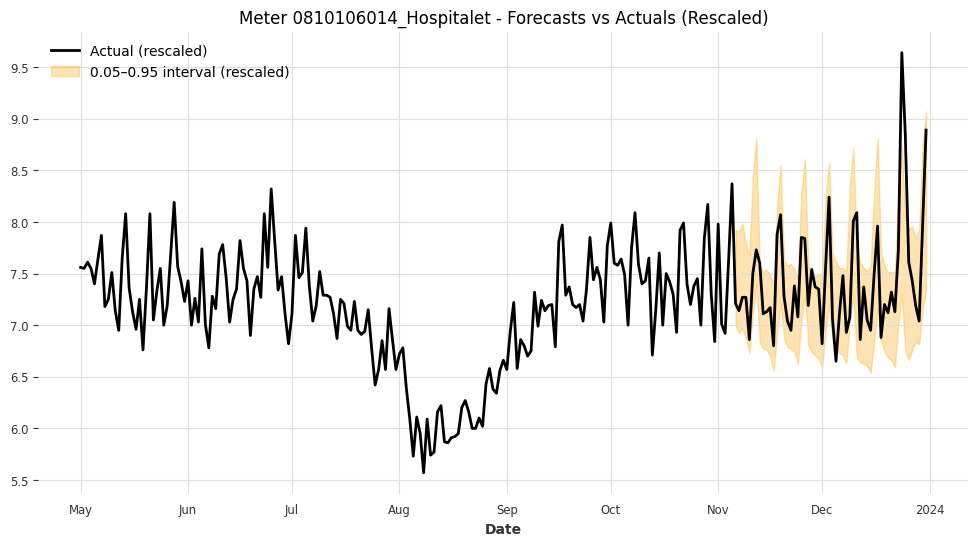

Meter 0810106014_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.0436



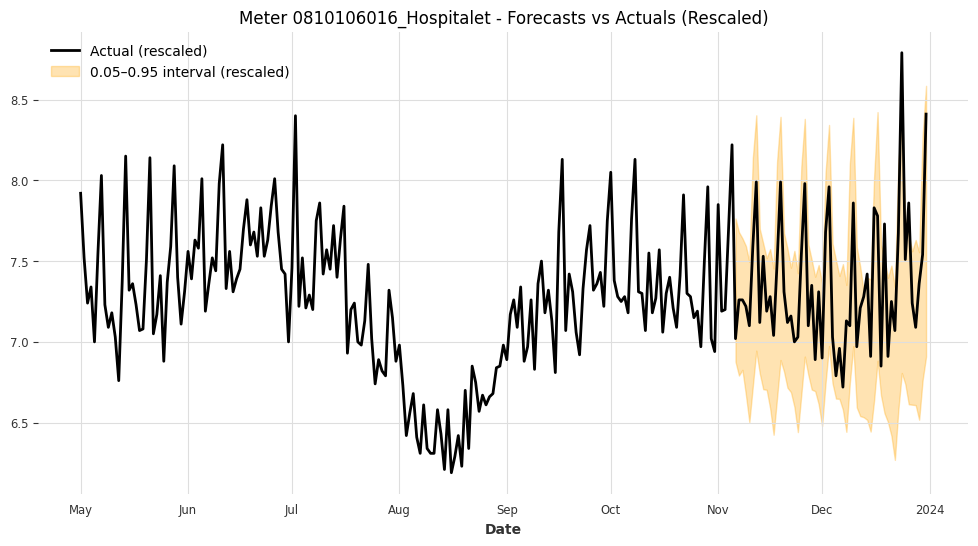

Meter 0810106016_Hospitalet - Coverage: 0.9286, Mean Interval Width (rescaled): 1.0676



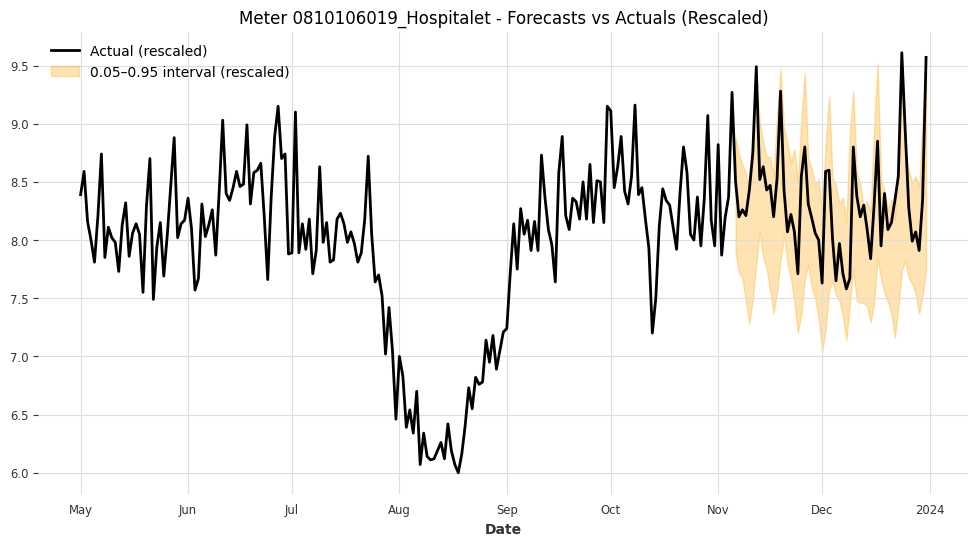

Meter 0810106019_Hospitalet - Coverage: 0.8929, Mean Interval Width (rescaled): 1.1728



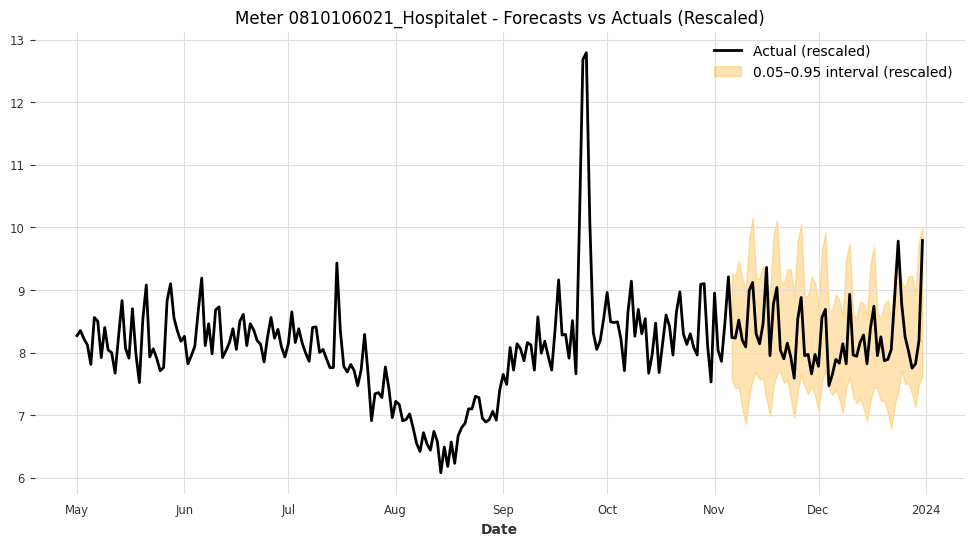

Meter 0810106021_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 1.8430



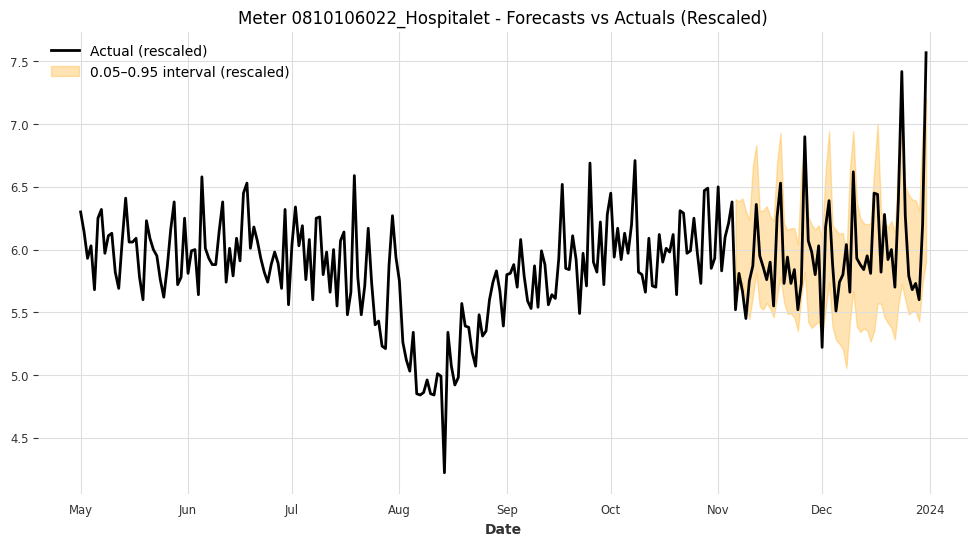

Meter 0810106022_Hospitalet - Coverage: 0.8393, Mean Interval Width (rescaled): 0.9091



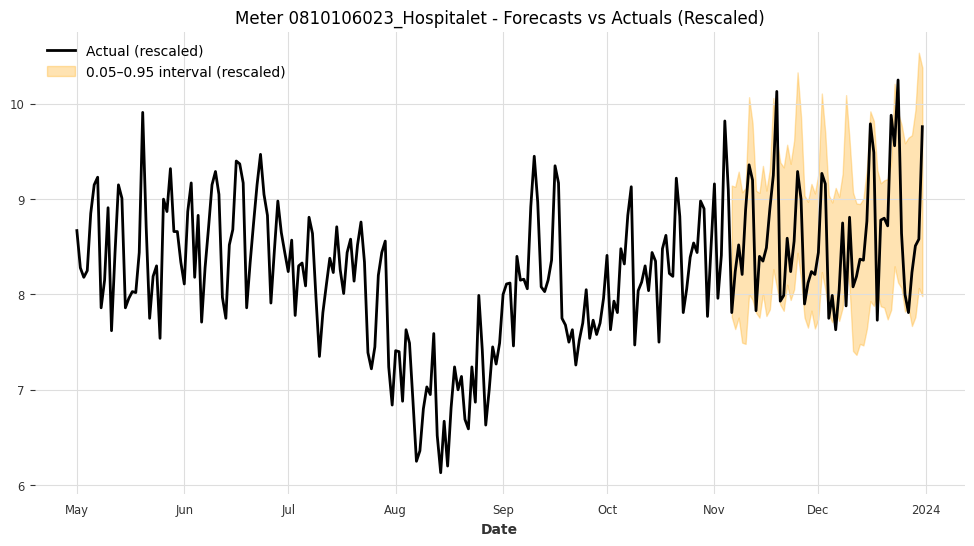

Meter 0810106023_Hospitalet - Coverage: 0.8571, Mean Interval Width (rescaled): 1.5991



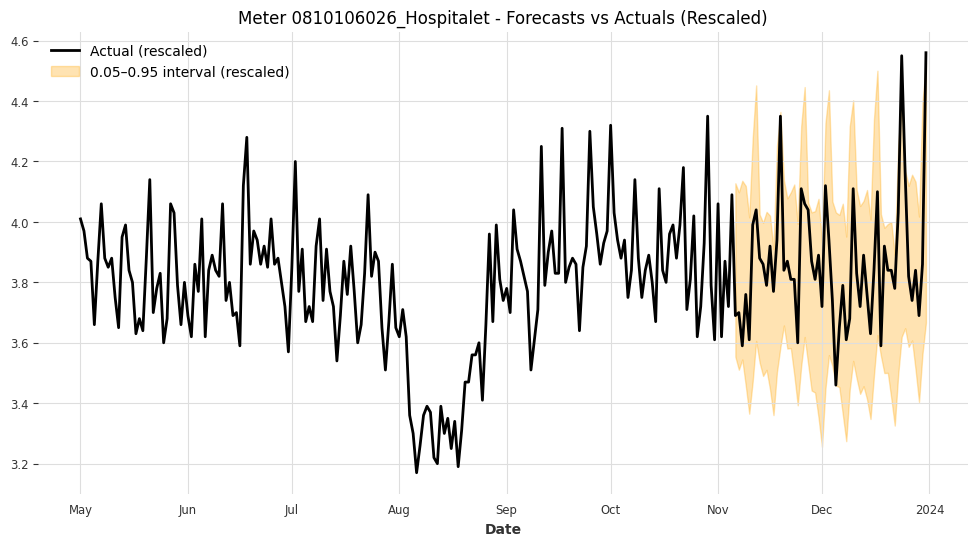

Meter 0810106026_Hospitalet - Coverage: 0.9643, Mean Interval Width (rescaled): 0.6518



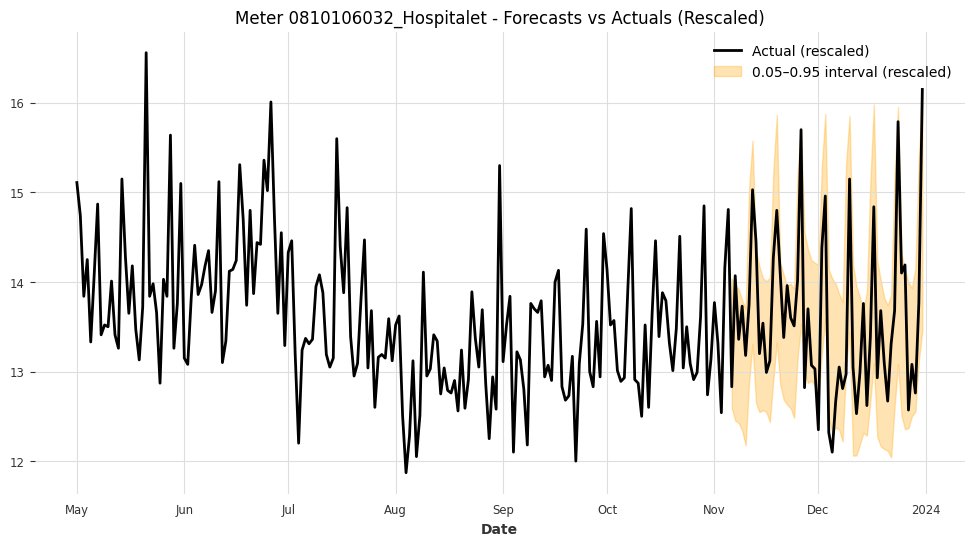

Meter 0810106032_Hospitalet - Coverage: 0.8036, Mean Interval Width (rescaled): 1.8168



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # We use this to merge forecast segments

for meter_id, hfcs in all_hfcs.items():
    # Get actual series (scaled)
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width_orig = df_result["Width"].iloc[0]

    # Start plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    # Collect rescaled quantiles
    full_lower = []
    full_upper = []

    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components and
            'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)

    # Plot interval if available
    if full_lower and full_upper:
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05–0.95 interval (rescaled)'
        )

    # Finalize plot
    ax.set_title(f"Meter {meter_id} - Forecasts vs Actuals (Rescaled)")
    ax.legend()
    plt.show()

    # Show metrics
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Mean Interval Width (rescaled): {width_orig:.4f}\n")
